In [1]:
import numpy as np
from scipy.ndimage import gaussian_filter
from matplotlib.gridspec import GridSpec
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
import matplotlib.ticker as mticker
import cmocean
import sklearn as sk
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.neighbors import KNeighborsClassifier
import seawater as sw
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import datetime as dt
import scipy.stats as sps
from scipy.stats import gaussian_kde
import scipy as sp
import xarray as xr
import metpy.calc as mt

import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

# 1) Importation des données

## 1)a) Données Profils

In [2]:
# Pres
interp_min=0 # min pressure (in dbar)
interp_max=1000 # max pressure (in dbar)
interp_step=5

PRES_i=np.linspace(interp_min,interp_max,1+int((interp_max-interp_min)/interp_step))

In [3]:
# Core
path_Core="ARGO Core/"

Core_LATITUDE=np.loadtxt(path_Core+'LATITUDE.csv', delimiter=',')
Core_LONGITUDE=np.loadtxt(path_Core+'LONGITUDE.csv', delimiter=',')
Core_Profile_Name=np.loadtxt(path_Core+'Name.txt', dtype='str', delimiter=',')
Core_PSAL=np.loadtxt(path_Core+'PSAL.csv', delimiter=',')
Core_TEMP=np.loadtxt(path_Core+'TEMP.csv', delimiter=',')
Core_TIME=np.loadtxt(path_Core+'Time.csv', delimiter=',')

tmp1=Core_TIME
tmp2=[]
for i in range(len(Core_TIME)):
    Y=int(tmp1[i,0])
    M=int(tmp1[i,1])
    D=int(tmp1[i,2])
    if D==0:
        D=1
    tmp2.append(dt.date(Y,M,D))
Core_TIME=np.array(tmp2)

In [4]:
# Bio
path_Bio="ARGO Bio/"

Bio_DOXY=np.loadtxt(path_Bio+'DOXY.csv', delimiter=',')
Bio_LATITUDE=np.loadtxt(path_Bio+'LATITUDE.csv', delimiter=',')
Bio_LONGITUDE=np.loadtxt(path_Bio+'LONGITUDE.csv', delimiter=',')
Bio_Profile_Name=np.loadtxt(path_Bio+'Name.txt', dtype='str', delimiter=',')
Bio_PSAL=np.loadtxt(path_Bio+'PSAL.csv', delimiter=',')
Bio_TEMP=np.loadtxt(path_Bio+'TEMP.csv', delimiter=',')
Bio_TIME=np.loadtxt(path_Bio+'Time.csv', delimiter=',')

tmp1=Bio_TIME
tmp2=[]
for i in range(len(Bio_TIME)):
    Y=int(tmp1[i,0])
    M=int(tmp1[i,1])
    D=int(tmp1[i,2])
    if D==0:
        D=1
    tmp2.append(dt.date(Y,M,D))
Bio_TIME=np.array(tmp2)

In [5]:
# WOA
path_WOA="WOA/"

WOA_DOXY=np.loadtxt(path_WOA+'DOXY.csv', delimiter=',')
WOA_LATITUDE=np.loadtxt(path_WOA+'LATITUDE.csv', delimiter=',')
WOA_LONGITUDE=np.loadtxt(path_WOA+'LONGITUDE.csv', delimiter=',')
WOA_Profile_Name=np.loadtxt(path_WOA+'Name.txt', dtype='str', delimiter=',')
WOA_PSAL=np.loadtxt(path_WOA+'PSAL.csv', delimiter=',')
WOA_TEMP=np.loadtxt(path_WOA+'TEMP.csv', delimiter=',')
WOA_TIME=np.loadtxt(path_WOA+'TIME.csv', delimiter=',')

tmp1=WOA_TIME
tmp2=[]
for i in range(len(WOA_TIME)):
    Y=int(tmp1[i,0])
    M=int(tmp1[i,1])
    D=int(tmp1[i,2])
    if D==0:
        D=1
    tmp2.append(dt.date(Y,M,D))
WOA_TIME=np.array(tmp2)

In [6]:
#GOSHIP
path_GOSHIP="GOSHIP/"

GOSHIP_DOXY=np.loadtxt(path_GOSHIP+'DOXY.csv', delimiter=',')
GOSHIP_LATITUDE=np.loadtxt(path_GOSHIP+'LATITUDE.csv', delimiter=',')
GOSHIP_LONGITUDE=np.loadtxt(path_GOSHIP+'LONGITUDE.csv', delimiter=',')
GOSHIP_Profile_Name=np.loadtxt(path_GOSHIP+'Name.txt', dtype='str', delimiter=',')
GOSHIP_PSAL=np.loadtxt(path_GOSHIP+'PSAL.csv', delimiter=',')
GOSHIP_TEMP=np.loadtxt(path_GOSHIP+'TEMP.csv', delimiter=',')
GOSHIP_TIME=np.loadtxt(path_GOSHIP+'TIME.csv', delimiter=',')

tmp1=GOSHIP_TIME
tmp2=[]
for i in range(len(GOSHIP_TIME)):
    Y=int(tmp1[i,0])
    M=int(tmp1[i,1])
    D=int(tmp1[i,2])
    if D==0:
        D=1
    tmp2.append(dt.date(Y,M,D))
GOSHIP_TIME=np.array(tmp2)

In [7]:
# WOD
path_WOD="WOD/"

WOD_DOXY=np.loadtxt(path_WOD+'WOD_Doxy.csv', delimiter=',')
WOD_LATITUDE=np.loadtxt(path_WOD+'WOD_Latitude.csv', delimiter=',')
WOD_LONGITUDE=np.loadtxt(path_WOD+'WOD_Longitude.csv', delimiter=',')
WOD_Profile_Name=np.loadtxt(path_WOD+'WOD_ProfileName.csv', dtype='str', delimiter=',')
WOD_PSAL=np.loadtxt(path_WOD+'WOD_Psal.csv', delimiter=',')
WOD_TEMP=np.loadtxt(path_WOD+'WOD_Temp.csv', delimiter=',')
WOD_TIME=np.loadtxt(path_WOD+'WOD_Time.csv', delimiter=',')

tmp1=WOD_TIME
tmp2=[]
for i in range(len(WOD_TIME)):
    Y=int(tmp1[i,0])
    M=int(tmp1[i,1])
    D=int(tmp1[i,2])
    if D==0:
        D=1
    tmp2.append(dt.date(Y,M,D))
WOD_TIME=np.array(tmp2)

## 1)b) Concatenation

In [8]:
# CTD Data

conc_LAT  = np.concatenate((Core_LATITUDE,Bio_LATITUDE,GOSHIP_LATITUDE,WOD_LATITUDE))
conc_LON  = np.concatenate((Core_LONGITUDE,Bio_LONGITUDE,GOSHIP_LONGITUDE,WOD_LONGITUDE))
conc_Name = np.concatenate((Core_Profile_Name,Bio_Profile_Name,GOSHIP_Profile_Name,WOD_Profile_Name))
conc_PSAL = np.concatenate((Core_PSAL,Bio_PSAL,GOSHIP_PSAL,WOD_PSAL))
conc_TEMP = np.concatenate((Core_TEMP,Bio_TEMP,GOSHIP_TEMP,WOD_TEMP))
conc_TIME = np.concatenate((Core_TIME,Bio_TIME,GOSHIP_TIME,WOD_TIME))

In [9]:
# BGC Data

conc_LAT_ox  = np.concatenate((Bio_LATITUDE,GOSHIP_LATITUDE,WOD_LATITUDE))
conc_LON_ox  = np.concatenate((Bio_LONGITUDE,GOSHIP_LONGITUDE,WOD_LONGITUDE))
conc_Name_ox = np.concatenate((Bio_Profile_Name,GOSHIP_Profile_Name,WOD_Profile_Name))
conc_PSAL_ox = np.concatenate((Bio_PSAL,GOSHIP_PSAL,WOD_PSAL))
conc_TEMP_ox = np.concatenate((Bio_TEMP,GOSHIP_TEMP,WOD_TEMP))
conc_TIME_ox = np.concatenate((Bio_TIME,GOSHIP_TIME,WOD_TIME))
conc_DOXY    = np.concatenate((Bio_DOXY,GOSHIP_DOXY,WOD_DOXY))

## 1)c) Area selection

In [10]:
latmin,latmax= -20,30
lonmin,lonmax= 35,130

mask_lon = np.logical_and(conc_LON>lonmin,conc_LON<lonmax)
mask_lat = np.logical_and(conc_LAT>latmin,conc_LAT<latmax)
mask_sel = np.logical_and(mask_lon,mask_lat)

conc_LAT  = conc_LAT[mask_sel]
conc_LON  = conc_LON[mask_sel]
conc_Name = conc_Name[mask_sel]
conc_PSAL = conc_PSAL[mask_sel]
conc_TEMP = conc_TEMP[mask_sel]
conc_TIME = conc_TIME[mask_sel]

mask_lon = np.logical_and(conc_LON_ox>lonmin,conc_LON_ox<lonmax)
mask_lat = np.logical_and(conc_LAT_ox>latmin,conc_LAT_ox<latmax)
mask_sel_ox = np.logical_and(mask_lon,mask_lat)

conc_LAT_ox  = conc_LAT_ox[mask_sel_ox]
conc_LON_ox  = conc_LON_ox[mask_sel_ox]
conc_Name_ox = conc_Name_ox[mask_sel_ox]
conc_PSAL_ox = conc_PSAL_ox[mask_sel_ox]
conc_TEMP_ox = conc_TEMP_ox[mask_sel_ox]
conc_TIME_ox = conc_TIME_ox[mask_sel_ox]
conc_DOXY    = conc_DOXY[mask_sel_ox]

-1

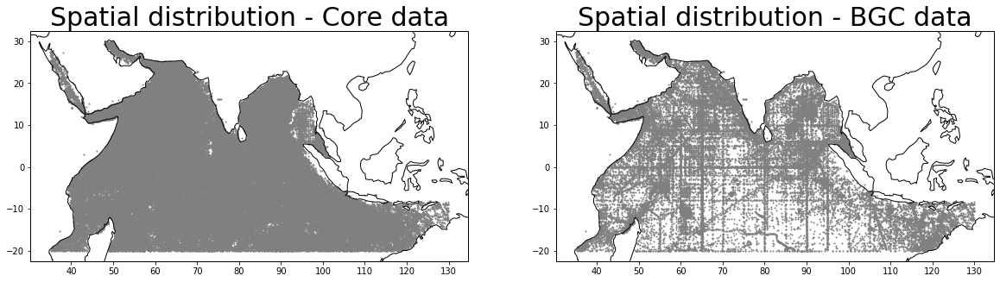

In [11]:
fig=plt.figure(figsize=(20,15))
ax=fig.add_subplot(121,projection=ccrs.PlateCarree())
ax.set_title("Spatial distribution - Core data",fontsize=30)
ax.scatter(conc_LON,conc_LAT,s=1,c='grey')
ax.add_feature(cfeature.COASTLINE)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100,110,120,130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10,0,10, 20,30], crs=ccrs.PlateCarree())

ax=fig.add_subplot(122,projection=ccrs.PlateCarree())
ax.set_title("Spatial distribution - BGC data",fontsize=30)
ax.scatter(conc_LON_ox,conc_LAT_ox,s=1,c='grey')
ax.add_feature(cfeature.COASTLINE)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100,110,120,130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10,0,10, 20, 30], crs=ccrs.PlateCarree())
-1

## 1)d) Climate data 

### 1)d)i) SLA

In [12]:
path="/home/mpoupon/01_Clustering_ARGO/"
SSH_mois=np.loadtxt(path+"Climat Data/SSH/ssh_mois.csv", delimiter=',')
SSH_mois=np.reshape(SSH_mois,(12, 80, 90))
SSH_iodneg=np.loadtxt(path+"Climat Data/SSH/ssh_iodneg.csv", delimiter=',')
SSH_iodpos=np.loadtxt(path+"Climat Data/SSH/ssh_iodpos.csv", delimiter=',')

SSH_iodan_neg=np.loadtxt(path+"Climat Data/SSH/ssh_an_iodneg.csv", delimiter=',')
SSH_iodan_pos=np.loadtxt(path+"Climat Data/SSH/ssh_an_iodpos.csv", delimiter=',')

LatLat_SSH=np.loadtxt(path+"Climat Data/SSH/latlat_ssh.csv", delimiter=',')
LonLon_SSH=np.loadtxt(path+"Climat Data/SSH/lonlon_ssh.csv", delimiter=',')

mask_lat=np.logical_and(LatLat_SSH[:,0]>latmin,LatLat_SSH[:,0]<latmax)
mask_lon=np.logical_and(LonLon_SSH[0,:]>lonmin,LonLon_SSH[0,:]<lonmax)

LonLon_SSH,LatLat_SSH=LonLon_SSH[mask_lat],LatLat_SSH[mask_lat]
LonLon_SSH,LatLat_SSH=LonLon_SSH[:,mask_lon],LatLat_SSH[:,mask_lon]

SSH_mois,SSH_iodpos,SSH_iodneg,SSH_iodan_pos,SSH_iodan_neg=SSH_mois[:,mask_lat],SSH_iodpos[mask_lat],SSH_iodneg[mask_lat],SSH_iodan_pos[mask_lat],SSH_iodan_neg[mask_lat]
SSH_mois,SSH_iodpos,SSH_iodneg,SSH_iodan_pos,SSH_iodan_neg=SSH_mois[:,:,mask_lon],SSH_iodpos[:,mask_lon],SSH_iodneg[:,mask_lon],SSH_iodan_pos[:,mask_lon],SSH_iodan_neg[:,mask_lon]

### 1)d)ii) Index

In [13]:
path="/home/mpoupon/01_Clustering_ARGO/"
DMI=xr.open_dataset(path+"Climat Data/DMI/dmi.nc")
DMI_TIME=np.array(DMI.WEDCEN2)
DMI_value=np.array(DMI.DMI)

tmp1=DMI_TIME
tmp2=[]
for t in DMI_TIME:
    Y=int(str(t)[0:4])
    M=int(str(t)[5:7])
    D=int(str(t)[8:10])
    if D==0:
        D=1
    tmp2.append(dt.date(Y,M,D))
DMI_TIME=np.array(tmp2)

DMI_long=pd.read_csv(path+"Climat Data/DMI/dmi.csv")

DMI_long_date=[]
DMI_long_val=[]
for y,m,d in zip(DMI_long['year'],DMI_long['month'],DMI_long['dmi']):
    DMI_long_date.append(dt.date(y,m,1))
    DMI_long_val.append(d)
DMI_long_date=np.array(DMI_long_date)
DMI_long_val=np.array(DMI_long_val)

In [14]:
def DMI_positive(TIME_array,shift=0,threshold=0.6): #shift en semaine
    Selection=[]
    for t in TIME_array:
        if t > DMI_TIME[0]:
            index=int((t-DMI_TIME[0]).days/7)+shift
            Selection.append(DMI_value[index]>threshold)
        else:
            Selection.append(False)
    return np.array(Selection) 

def DMI_negative(TIME_array,shift=0,threshold=-0.6): #shift en semaine
    Selection=[]
    for t in TIME_array:
        if t > DMI_TIME[0]:
            index=int((t-DMI_TIME[0]).days/7)+shift
            Selection.append(DMI_value[index]<threshold)
        else:
            Selection.append(False)
    return np.array(Selection)

def DMI_neutral(TIME_array,shift=0,threshold=0.3): #shift en semaine
    Selection=[]
    for t in TIME_array:
        if t > DMI_TIME[0]:
            index=int((t-DMI_TIME[0]).days/7)+shift
            mask=np.logical_and(DMI_value[index]<threshold,DMI_value[index]>-threshold)
            Selection.append(mask)
        else:
            Selection.append(False)
    return np.array(Selection)

# 2) Calcul data

## 2)a) Time

In [15]:
# Core Data
conc_Month = []
conc_Year  = []
conc_Day   = []
for time in conc_TIME:
    conc_Month.append(time.month)
    conc_Year.append(time.year)
    conc_Day.append(time.day+30*(time.month-1))
conc_Month = np.array(conc_Month)
conc_Year  = np.array(conc_Year)
conc_Day   = np.array(conc_Day)

In [16]:
# BGC Data
conc_Month_ox = []
conc_Year_ox  = []
conc_Day_ox   = []
for time in conc_TIME_ox:
    conc_Month_ox.append(time.month)
    conc_Year_ox.append(time.year)
    conc_Day_ox.append(time.day+30*(time.month-1))
conc_Month_ox = np.array(conc_Month_ox)
conc_Year_ox  = np.array(conc_Year_ox)
conc_Day_ox   = np.array(conc_Day_ox)

In [17]:
# WOA Data
WOA_Month = []
WOA_Year  = []
WOA_Day   = []
for time in WOA_TIME:
    WOA_Month.append(time.month)
    WOA_Year.append(time.year)
    WOA_Day.append(time.day+30*(time.month-1))
WOA_Month = np.array(WOA_Month)
WOA_Year  = np.array(WOA_Year)
WOA_Day   = np.array(WOA_Day)

## 2)b) Characteristic depth

In [18]:
def smooth_value(value,pres, n=3) :
    mask=np.isfinite(value)
    value_finite=value[mask]
    grad=np.gradient(value_finite)
    
    value_sum =np.full((len(value_finite)),0)
    value_ind =np.full((len(value_finite)),0)
    
    for i in range(-int((n-1)/2),int((n-1)/2)+1):
        n_av,n_ap  = np.abs(i)*(i<0),np.abs(i)*(i>0)
        zero_av    = np.full((n_av),0)
        zero_ap    = np.full((n_ap),0)
         
        value_one  = np.full((len(value_sum)-n_av-n_ap),1)
        value_bool = np.concatenate((zero_av,value_one,zero_ap))
        
        value_mask = np.flip(value_bool)==1
        value_crop = value_finite[value_mask]
        
        value_conc = np.concatenate((zero_av,value_crop,zero_ap))
        
        value_sum = value_sum + value_conc
        value_ind = value_ind + value_bool
        
    value_smooth = value_sum/value_ind
    
    return value_smooth,pres[mask]

### 2)b)i) Thermocline (grad)

In [19]:
# Core data
conc_therm = []

for temp in conc_TEMP:
    
    temp = temp[PRES_i<500]
    pres = PRES_i[PRES_i<500]
    
    if np.sum(np.isfinite(temp))>10:
        grad_sm,pres_sm=smooth_value(np.gradient(temp),pres,n=13)
        if np.max(pres_sm)>200:
            mask  = grad_sm==np.min(grad_sm)
            thermocline = np.mean(pres_sm[mask])
            conc_therm.append(thermocline)
            
        else:
            conc_therm.append(np.nan)
    else:
        conc_therm.append(np.nan)

conc_therm=np.array(conc_therm)

In [20]:
# BGC data
conc_therm_ox = []

for temp in conc_TEMP_ox:
    
    temp = temp[PRES_i<500]
    pres = PRES_i[PRES_i<500]
    
    if np.sum(np.isfinite(temp))>10:
        grad_sm,pres_sm=smooth_value(np.gradient(temp),pres,n=13)
        if np.max(pres_sm)>200:
            mask  = grad_sm==np.min(grad_sm)
            thermocline = np.mean(pres_sm[mask])
            conc_therm_ox.append(thermocline)
            
        else:
            conc_therm_ox.append(np.nan)
    else:
        conc_therm_ox.append(np.nan)

conc_therm_ox=np.array(conc_therm_ox)

In [21]:
# WOA
WOA_therm = []

for temp in WOA_TEMP:
    
    temp = temp[PRES_i<500]
    pres = PRES_i[PRES_i<500]
    
    if np.sum(np.isfinite(temp))>10:
        grad_sm,pres_sm=smooth_value(np.gradient(temp),pres,n=13)
        if np.max(pres_sm)>200:
            mask  = grad_sm==np.min(grad_sm)
            thermocline = np.mean(pres_sm[mask])
            WOA_therm.append(thermocline)
            
        else:
            WOA_therm.append(np.nan)
    else:
        WOA_therm.append(np.nan)

WOA_therm=np.array(WOA_therm)

### 2)b)ii) Oxycline (grad)

In [22]:
# BGC data
conc_oxyc = []

for temp in conc_DOXY:
    
    temp = temp[PRES_i<500]
    pres = PRES_i[PRES_i<500]
    if np.sum(np.isfinite(temp))>20:
        grad_sm,pres_sm=smooth_value(np.gradient(temp),pres,n=7)
        if np.max(pres_sm)>200:
            mask  = grad_sm==np.min(grad_sm)
            thermocline = np.mean(pres_sm[mask])
            conc_oxyc.append(thermocline)
            
        else:
            conc_oxyc.append(np.nan)
    else:
        conc_oxyc.append(np.nan)

conc_oxyc=np.array(conc_oxyc)

In [23]:
# WOA
WOA_oxyc = []

for temp in WOA_DOXY:
    
    temp = temp[PRES_i<500]
    pres = PRES_i[PRES_i<500]
    if np.sum(np.isfinite(temp))>20:
        grad_sm,pres_sm=smooth_value(np.gradient(temp),pres,n=7)
        if np.max(pres_sm)>200:
            mask  = grad_sm==np.min(grad_sm)
            thermocline = np.mean(pres_sm[mask])
            WOA_oxyc.append(thermocline)
            
        else:
            WOA_oxyc.append(np.nan)
    else:
        WOA_oxyc.append(np.nan)

WOA_oxyc=np.array(WOA_oxyc)

### 2)b)iii) Thermocline anomaly

In [24]:
# Core data

conc_therm_an=[]

for rank in range(len(conc_LAT)):
    lon=conc_LON[rank]
    lat=conc_LAT[rank]
    dot_therm=conc_therm[rank]

    if lon>=0:
        dot_lon=int(lon)+0.5
    else:
        dot_lon=int(lon)-0.5
    if lat>=0:
        dot_lat=int(lat)+0.5
    else:
        dot_lat=int(lat)-0.5

    monthlat=WOA_LATITUDE[WOA_Month==conc_Month[rank]]
    monthlon=WOA_LONGITUDE[WOA_Month==conc_Month[rank]]

    mask=np.logical_and(monthlat==dot_lat,monthlon==dot_lon)
    therm=WOA_therm[WOA_Month==conc_Month[rank]]
    if len(therm[mask])>0:
        conc_therm_an.append(dot_therm-therm[mask][0])
    else:
        conc_therm_an.append(np.nan)

conc_therm_an=np.array(conc_therm_an)

In [25]:
# BGC data
conc_therm_an_ox=[]

for rank in range(len(conc_LAT_ox)):
    lon=conc_LON_ox[rank]
    lat=conc_LAT_ox[rank]
    dot_therm=conc_therm_ox[rank]

    if lon>=0:
        dot_lon=int(lon)+0.5
    else:
        dot_lon=int(lon)-0.5
    if lat>=0:
        dot_lat=int(lat)+0.5
    else:
        dot_lat=int(lat)-0.5

    monthlat=WOA_LATITUDE[WOA_Month==conc_Month_ox[rank]]
    monthlon=WOA_LONGITUDE[WOA_Month==conc_Month_ox[rank]]

    mask=np.logical_and(monthlat==dot_lat,monthlon==dot_lon)
    therm=WOA_therm[WOA_Month==conc_Month_ox[rank]]
    if len(therm[mask])>0:
        conc_therm_an_ox.append(dot_therm-therm[mask][0])
    else:
        conc_therm_an_ox.append(np.nan)

conc_therm_an_ox=np.array(conc_therm_an_ox)

### 2)b)iv) Oxycline anomaly

In [26]:
# BGC data

conc_oxyc_an=[]

for rank in range(len(conc_LAT_ox)):
    lon=conc_LON_ox[rank]
    lat=conc_LAT_ox[rank]
    dot_therm=conc_oxyc[rank]

    if lon>=0:
        dot_lon=int(lon)+0.5
    else:
        dot_lon=int(lon)-0.5
    if lat>=0:
        dot_lat=int(lat)+0.5
    else:
        dot_lat=int(lat)-0.5

    monthlat=WOA_LATITUDE[WOA_Month==conc_Month_ox[rank]]
    monthlon=WOA_LONGITUDE[WOA_Month==conc_Month_ox[rank]]

    mask=np.logical_and(monthlat==dot_lat,monthlon==dot_lon)
    therm=WOA_oxyc[WOA_Month==conc_Month_ox[rank]]
    if len(therm[mask])>0:
        conc_oxyc_an.append(dot_therm-therm[mask][0])
    else:
        conc_oxyc_an.append(np.nan)

conc_oxyc_an=np.array(conc_oxyc_an)

### 2)b)v) Oxycline & Thermocline (threshold)

In [27]:
WOA_DENS = sw.eos80.dens(WOA_PSAL, WOA_TEMP, np.array([PRES_i for i in range(len(WOA_TEMP))])) ### kg/m3
WOA_DENS = WOA_DENS/1000 # kg/L

In [28]:
# Thermocline (WOA)
WOA_TCD=[]
for temp in WOA_TEMP:
    if len(PRES_i[temp<23])>0:
        WOA_TCD.append(PRES_i[temp<23][0])
    else:
        WOA_TCD.append(np.nan)
WOA_TCD=np.array(WOA_TCD)

In [29]:
# Oxycline (WOA)
WOA_OCD=[]
for doxy,dens in zip(WOA_DOXY,WOA_DENS):
    doxy=doxy*dens
    if len(PRES_i[doxy<155])>0:
        WOA_OCD.append(PRES_i[doxy<155][0])
    else:
        WOA_OCD.append(np.nan)
WOA_OCD=np.array(WOA_OCD)

## 2)c) Profile anomaly

### 2)c)i) Temperature anomaly

In [30]:
# Core Data
conc_TEMP_an=[]

for rank in range(len(conc_LAT)):

    lon=conc_LON[rank]
    lat=conc_LAT[rank]
    oxygen=conc_TEMP[rank]
    
    if lon>=0:
        dot_lon=int(lon)+0.5
    else:
        dot_lon=int(lon)-0.5
    if lat>=0:
        dot_lat=int(lat)+0.5
    else:
        dot_lat=int(lat)-0.5

    monthlat=WOA_LATITUDE[WOA_Month==conc_Month[rank]]
    monthlon=WOA_LONGITUDE[WOA_Month==conc_Month[rank]]
    
    mask=np.logical_and(monthlat==dot_lat,monthlon==dot_lon)
    therm=WOA_TEMP[WOA_Month==conc_Month[rank]]
    
    if len(therm[mask])>0:
        conc_TEMP_an.append(oxygen-therm[mask][0])
    else:
        conc_TEMP_an.append([np.nan for i in range(len(PRES_i))])

conc_TEMP_an=np.array(conc_TEMP_an)

In [31]:
# BGC Data
conc_TEMP_an_ox=[]

for rank in range(len(conc_LAT_ox)):

    lon=conc_LON_ox[rank]
    lat=conc_LAT_ox[rank]
    oxygen=conc_TEMP_ox[rank]
    
    if lon>=0:
        dot_lon=int(lon)+0.5
    else:
        dot_lon=int(lon)-0.5
    if lat>=0:
        dot_lat=int(lat)+0.5
    else:
        dot_lat=int(lat)-0.5

    monthlat=WOA_LATITUDE[WOA_Month==conc_Month_ox[rank]]
    monthlon=WOA_LONGITUDE[WOA_Month==conc_Month_ox[rank]]
    
    mask=np.logical_and(monthlat==dot_lat,monthlon==dot_lon)
    therm=WOA_TEMP[WOA_Month==conc_Month_ox[rank]]
    
    if len(therm[mask])>0:
        conc_TEMP_an_ox.append(oxygen-therm[mask][0])
    else:
        conc_TEMP_an_ox.append([np.nan for i in range(len(PRES_i))])

conc_TEMP_an_ox=np.array(conc_TEMP_an_ox)

### 2)c)ii) Sanility anomaly

In [32]:
# Core Data
conc_PSAL_an=[]

for rank in range(len(conc_LAT)):

    lon=conc_LON[rank]
    lat=conc_LAT[rank]
    oxygen=conc_PSAL[rank]
    
    if lon>=0:
        dot_lon=int(lon)+0.5
    else:
        dot_lon=int(lon)-0.5
    if lat>=0:
        dot_lat=int(lat)+0.5
    else:
        dot_lat=int(lat)-0.5

    monthlat=WOA_LATITUDE[WOA_Month==conc_Month[rank]]
    monthlon=WOA_LONGITUDE[WOA_Month==conc_Month[rank]]
    
    mask=np.logical_and(monthlat==dot_lat,monthlon==dot_lon)
    therm=WOA_PSAL[WOA_Month==conc_Month[rank]]
    
    if len(therm[mask])>0:
        conc_PSAL_an.append(oxygen-therm[mask][0])
    else:
        conc_PSAL_an.append([np.nan for i in range(len(PRES_i))])

conc_PSAL_an=np.array(conc_PSAL_an)

In [33]:
# BGC Data
conc_PSAL_an_ox=[]

for rank in range(len(conc_LAT_ox)):

    lon=conc_LON_ox[rank]
    lat=conc_LAT_ox[rank]
    oxygen=conc_PSAL_ox[rank]
    
    if lon>=0:
        dot_lon=int(lon)+0.5
    else:
        dot_lon=int(lon)-0.5
    if lat>=0:
        dot_lat=int(lat)+0.5
    else:
        dot_lat=int(lat)-0.5

    monthlat=WOA_LATITUDE[WOA_Month==conc_Month_ox[rank]]
    monthlon=WOA_LONGITUDE[WOA_Month==conc_Month_ox[rank]]
    
    mask=np.logical_and(monthlat==dot_lat,monthlon==dot_lon)
    therm=WOA_PSAL[WOA_Month==conc_Month_ox[rank]]
    
    if len(therm[mask])>0:
        conc_PSAL_an_ox.append(oxygen-therm[mask][0])
    else:
        conc_PSAL_an_ox.append([np.nan for i in range(len(PRES_i))])

conc_PSAL_an_ox=np.array(conc_PSAL_an_ox)

### 2)c)iii) Oxygen anomaly

In [34]:
# BGC Data
conc_DOXY_an=[]

for rank in range(len(conc_LAT_ox)):

    lon=conc_LON_ox[rank]
    lat=conc_LAT_ox[rank]
    oxygen=conc_DOXY[rank]
    
    if lon>=0:
        dot_lon=int(lon)+0.5
    else:
        dot_lon=int(lon)-0.5
    if lat>=0:
        dot_lat=int(lat)+0.5
    else:
        dot_lat=int(lat)-0.5

    monthlat=WOA_LATITUDE[WOA_Month==conc_Month_ox[rank]]
    monthlon=WOA_LONGITUDE[WOA_Month==conc_Month_ox[rank]]
    
    mask=np.logical_and(monthlat==dot_lat,monthlon==dot_lon)
    therm=WOA_DOXY[WOA_Month==conc_Month_ox[rank]]
    
    if len(therm[mask])>0:
        conc_DOXY_an.append(oxygen-therm[mask][0])
    else:
        conc_DOXY_an.append([np.nan for i in range(len(PRES_i))])

conc_DOXY_an=np.array(conc_DOXY_an)

## 2)d) DMI

In [35]:
def closest_x(x,x_range):
    down=x_range[x_range<x]
    up=x_range[x_range>x]
    if len(down)>0 and len(up)>0:
        if x-down[-1] >= up[0]-x:
            return len(down)
        if x-down[-1] < up[0]-x:
            return len(down)-1
    elif len(up)>0:
        return len(down)
    elif len(down)>0:
        return len(down)-1
    else:
        return -1

## 2)d)i) DMI instantaneous

In [36]:
# Core Data
conc_DMI=[]
for t in conc_TIME:
    conc_DMI.append(DMI_value[closest_x(t,DMI_TIME)])
conc_DMI=np.array(conc_DMI)

In [37]:
# BGC Data
conc_DMI_ox=[]
for t in conc_TIME_ox:
    conc_DMI_ox.append(DMI_value[closest_x(t,DMI_TIME)])
conc_DMI_ox=np.array(conc_DMI_ox)

## 2)d)ii) DMI integrated

In [38]:
th1=np.std(DMI_long_val)
th2=np.std(DMI_value)

DMI_shift,DMI_shift_year=[],[]

for i in range(1959,2020):
    if i<1982:
        mask=np.logical_and(DMI_long_date>dt.date(i,10,1),DMI_long_date<dt.date(i,12,1))
        DMI_shift_year.append(i)
        DMI_shift.append(np.mean(DMI_long_val[mask])*th2/th1)
        
    else:
        mask=np.logical_and(DMI_TIME>dt.date(i,10,1),DMI_TIME<dt.date(i,12,1))
        DMI_shift_year.append(i)
        DMI_shift.append(np.mean(DMI_value[mask]))
DMI_shift,DMI_shift_year=np.array(DMI_shift),np.array(DMI_shift_year)

-1

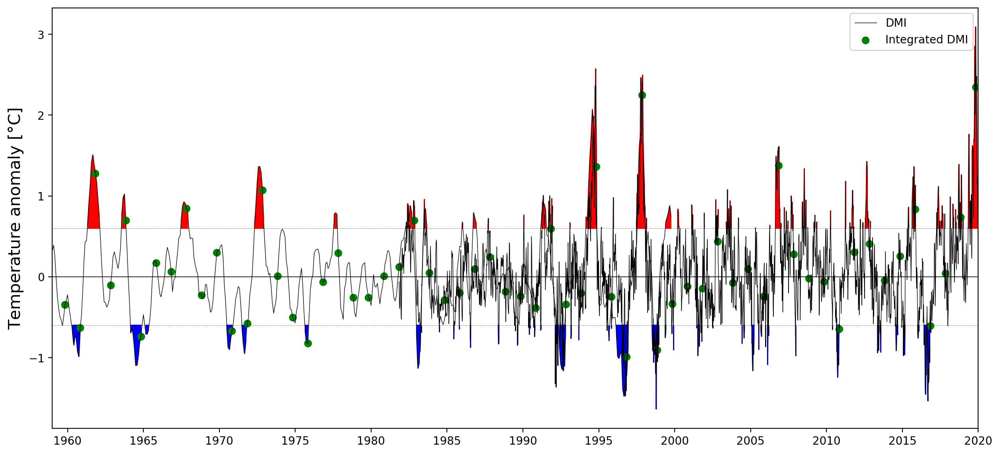

In [39]:
th1=np.std(DMI_long_val)
th2=np.std(DMI_value)
threshold=0.6

plt.figure(figsize=(15,7),dpi=200)
plt.plot(DMI_TIME,DMI_value,c='k',linewidth=0.5,label='DMI')
plt.fill_between(DMI_TIME,DMI_value,0.6,where=DMI_value>0.6,color='r')
plt.fill_between(DMI_TIME,DMI_value,-0.6,where=DMI_value<-0.6,color='b')

plt.hlines(0,DMI_long_date[0],DMI_TIME[-1],linewidth=0.6)
plt.hlines((-0.6,0.6),DMI_long_date[0],DMI_TIME[-1],linestyles='dotted',linewidth=0.3)
plt.ylabel('Temperature anomaly [°C]',fontsize=15)
plt.xticks([dt.date(i,1,1) for i in range(1960,2021,5)],
           [i for i in range(1960,2021,5)])

plt.plot(DMI_long_date,DMI_long_val*th2/th1,c='k',linewidth=0.5)
plt.fill_between(DMI_long_date,DMI_long_val*th2/th1,0.6,where=DMI_long_val*th2/th1>0.6,color='r')
plt.fill_between(DMI_long_date,DMI_long_val*th2/th1,-0.6,where=DMI_long_val*th2/th1<-0.6,color='b')


plt.xlim(dt.date(1959,1,1),dt.date(2020,1,1))

plt.scatter(dt.date(DMI_shift_year[0],11,1),DMI_shift[0],c='g',label="Integrated DMI")
for y,d in zip(DMI_shift_year,DMI_shift):
    plt.scatter(dt.date(y,11,1),d,c='g')
    
plt.legend()
-1

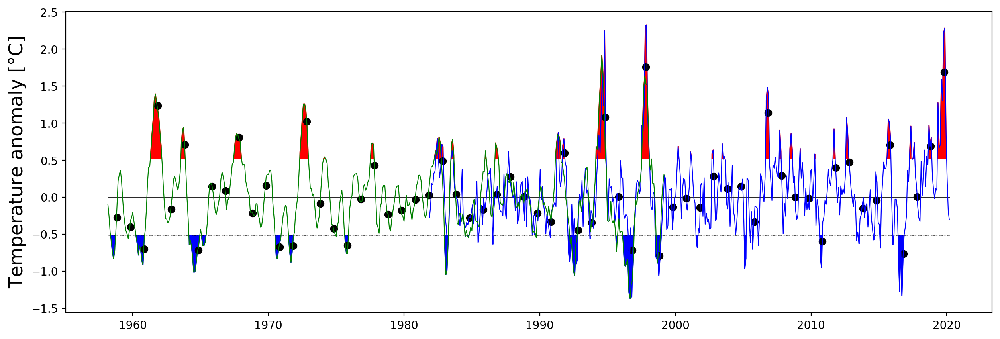

In [40]:
ft_size=17

# Lines
tmp_time,tmp_val=[],[]
for year in range(1981,2021):
    for month in range(1,13):
        mask=np.logical_and(DMI_TIME>dt.date(year,month,1),DMI_TIME<dt.date(year,month,28))
        tmp_time.append(dt.date(year,month,15)),tmp_val.append(np.nanmean(DMI_value[mask]))
tmp_time,tmp_val=np.array(tmp_time),np.array(tmp_val)

DMI_shift_year_tmp,DMI_shift_tmp = [],[]
for i in range(1981,2021):
        mask=np.logical_and(tmp_time>=dt.date(i,9,1),tmp_time<=dt.date(i,12,31))
        DMI_shift_year_tmp.append(i)
        DMI_shift_tmp.append(np.mean(tmp_val[mask]))
DMI_shift_year_tmp,DMI_shift_tmp =np.array(DMI_shift_year_tmp),np.array(DMI_shift_tmp)

DMI_long_year_tmp,DMI_long_tmp = [],[]
for i in range(1958,1999):
        mask=np.logical_and(DMI_long_date>=dt.date(i,9,1),DMI_long_date<=dt.date(i,12,31))
        DMI_long_year_tmp.append(i)
        DMI_long_tmp.append(np.mean(DMI_long_val[mask]))


fig=plt.figure(figsize=(15,5),dpi=200)

ax1=fig.add_subplot(111)
ax1.plot(tmp_time,tmp_val,c='b',linewidth=0.8)
ax1.plot(DMI_long_date[:-7],DMI_long_val[:-7]*np.nanstd(tmp_val)/np.nanstd(DMI_long_val),c='g',linewidth=0.8)

# fill
seuil=np.nanstd(tmp_val)

ax1.hlines(0,DMI_long_date[0],DMI_TIME[-1],linewidth=0.6)
ax1.hlines((-seuil,seuil),DMI_long_date[0],DMI_TIME[-1],linestyles='dotted',linewidth=0.3)

ax1.fill_between(tmp_time,tmp_val,seuil,where=tmp_val>seuil,color='r')
ax1.fill_between(tmp_time,tmp_val,-seuil,where=tmp_val<-seuil,color='b')

ax1.fill_between(DMI_long_date[:-7],DMI_long_val[:-7]*np.nanstd(tmp_val)/np.nanstd(DMI_long_val),seuil,where=DMI_long_val[:-7]*np.nanstd(tmp_val)/np.nanstd(DMI_long_val)>seuil,color='r')
ax1.fill_between(DMI_long_date[:-7],DMI_long_val[:-7]*np.nanstd(tmp_val)/np.nanstd(DMI_long_val),-seuil,where=DMI_long_val[:-7]*np.nanstd(tmp_val)/np.nanstd(DMI_long_val)<-seuil,color='b')

# dots
for y,d in zip(DMI_shift_year_tmp,DMI_shift_tmp):
    ax1.scatter(dt.date(y,11,1),d,c='k')

mask=np.array(DMI_long_year_tmp)<1982
for y,d in zip(np.array(DMI_long_year_tmp)[mask],np.array(DMI_long_tmp)[mask]):
    ax1.scatter(dt.date(y,11,1),d*np.nanstd(tmp_val)/np.nanstd(DMI_long_val),c='k')
    
ax1.set_ylabel('Temperature anomaly [°C]',fontsize=ft_size)

plt.savefig("DMI time serie.png")

In [41]:
# Core Data
conc_DMI_int=[]
for month,year in zip(conc_Month,conc_Year):
    if month<10:
        year=year-1
    if year>1959:
        conc_DMI_int.append(DMI_shift[DMI_shift_year==year][0])
    else:
        conc_DMI_int.append(np.nan)
conc_DMI_int=np.array(conc_DMI_int)

In [42]:
# BGC Data
conc_DMI_int_ox=[]
for month,year in zip(conc_Month_ox,conc_Year_ox):
    if month<10:
        year=year-1
    if year>1959:
        conc_DMI_int_ox.append(DMI_shift[DMI_shift_year==year][0])
    else:
        conc_DMI_int_ox.append(np.nan)
conc_DMI_int_ox=np.array(conc_DMI_int_ox)

# 3) Spatial filters

## 3)a) Coastal selection

In [43]:
def mask_coast(c_lon,c_lat,lonmin,lonmax,latmin,latmax):
    data=xr.open_dataset('/tigress/GEOCLIM/LRGROUP/shared_data/pco2_flux_coastal_Roobaert/mask_ocean.nc')
    mask_coast=np.array(data.mask_coastal2).astype(int).T
    lat=np.array(data.latitude)
    lon=np.array(data.longitude)

    mask_lon=np.logical_and(lon>lonmin,lon<lonmax)
    mask_lat=np.logical_and(lat>latmin,lat<latmax)

    lon=lon[mask_lon]
    lat=lat[mask_lat]

    mask_coast=mask_coast[mask_lat]
    mask_coast=mask_coast[:,mask_lon]

    lonlon,latlat=np.meshgrid(lon,lat)

    lon_dot=np.array([70,70])
    lat_dot=np.array([10,19.5])

    mask=[]
    for lo,la in zip(c_lon,c_lat):
        if len(lon[lon<=lo])>0 and len(lat[lat>=la])>0 and len(lon[lon>=lo])>0 and len(lat[lat<=la])>0:
            lon_lim=[lon[lon<=lo][-1],lon[lon>=lo][0]]
            lat_lim=[lat[lat<=la][-1],lat[lat>=la][0]]
            mask_lon=np.logical_or(lon==lon_lim[0],lon==lon_lim[1])
            mask_lat=np.logical_or(lat==lat_lim[0],lat==lat_lim[1])
            mask_tmp=mask_coast[mask_lat]
            mask_tmp=mask_tmp[:,mask_lon]
            mask.append(np.mean(mask_tmp)>0)
        else:
            mask.append(False)
    mask=np.array(mask)
    return mask

## 3)b) Gridding

### 3)b)i) Global gridding: mean & std

In [44]:
def grid(valeur,longitude,latitude,n=1,lonmin=35,lonmax=135,latmin=-20,latmax=30):
    if latmin<0:
        latmin=latmin-1
    if latmax<0:
        latmax=latmax-1
    lat_range=np.linspace(int(latmin)+n/2,int(latmax)+n/2,int(int(latmax)-int(latmin))/n+1)
    lon_range=np.linspace(int(lonmin)+n/2,int(lonmax)+n/2,int(int(lonmax)-int(lonmin))/n+1)
    
    grid_value=np.full((len(lon_range),len(lat_range)),np.nan)
    grid_std=np.full((len(lon_range),len(lat_range)),0)
    grid_index=np.full((len(lon_range),len(lat_range)),0)

    for val,lon,lat in zip(valeur,longitude,latitude):
        i=closest_x(lon,lon_range)
        j=closest_x(lat,lat_range)
        interv_sap= lon < lonmax+n/2 and lon > lonmin-n/2 and lat > latmin-n/2 and lat < latmax+n/2
        if i>=0 and j>=0 and interv_sap:
            if grid_index[i,j]==0 and np.isfinite(val):
                grid_index[i,j]=1
                grid_value[i,j]=val
            elif np.isfinite(val):
                grid_index[i,j]=grid_index[i,j]+1
                ind=grid_index[i,j]
                grid_value[i,j]= ((ind-1)/ind)*grid_value[i,j] + (val/ind)
    
    for val,lon,lat in zip(valeur,longitude,latitude):
        i=closest_x(lon,lon_range)
        j=closest_x(lat,lat_range)
        interv_sap= lon < lonmax+n/2 and lon > lonmin-n/2 and lat > latmin-n/2 and lat < latmax+n/2
        if i>=0 and j>=0 and np.isfinite(val) and interv_sap:
            grid_std[i,j]=grid_std[i,j]+(val-grid_value[i,j])**2
            ind=grid_index[i,j]
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            if grid_index[i,j]>0:
                grid_std[i,j]=np.sqrt(grid_std[i,j]/grid_index[i,j])
    
    lon_range,lat_range=np.meshgrid(lon_range,lat_range)
    return grid_value,grid_std,grid_index,lat_range.T,lon_range.T

### 3)b)ii) Monthly gridding: mean & std

In [45]:
def grid_month(valeur,longitude,latitude,month,n=1,lonmin=35,lonmax=135,latmin=-20,latmax=30):
    if latmin<0:
        latmin=latmin-1
    if latmax<0:
        latmax=latmax-1
    lat_range=np.linspace(int(latmin)+n/2,int(latmax)+n/2,int(int(latmax)-int(latmin))/n+1)
    lon_range=np.linspace(int(lonmin)+n/2,int(lonmax)+n/2,int(int(lonmax)-int(lonmin))/n+1)
    
    grid_value=np.full((len(lon_range),len(lat_range),12),np.nan)
    grid_std=np.full((len(lon_range),len(lat_range),12),0)
    grid_index=np.full((len(lon_range),len(lat_range),12),0)

    for val,lon,lat,mo in zip(valeur,longitude,latitude,month):
        mo=mo-1
        i=closest_x(lon,lon_range)
        j=closest_x(lat,lat_range)
        interv_sap= lon < lonmax+n/2 and lon > lonmin-n/2 and lat > latmin-n/2 and lat < latmax+n/2
        if i>=0 and j>=0 and interv_sap:
            if grid_index[i,j,mo]==0 and np.isfinite(val):
                grid_index[i,j,mo]=1
                grid_value[i,j,mo]=val
            elif np.isfinite(val):
                grid_index[i,j,mo]=grid_index[i,j,mo]+1
                ind=grid_index[i,j,mo]
                grid_value[i,j,mo] = ((ind-1)/ind)*grid_value[i,j,mo] + (val/ind)
    
    for val,lon,lat,mo in zip(valeur,longitude,latitude,month):
        mo=mo-1
        i=closest_x(lon,lon_range)
        j=closest_x(lat,lat_range)
        interv_sap= lon < lonmax+n/2 and lon > lonmin-n/2 and lat > latmin-n/2 and lat < latmax+n/2
        if i>=0 and j>=0 and np.isfinite(val) and interv_sap:
            grid_std[i,j,mo]=grid_std[i,j,mo]+(val-grid_value[i,j,mo])**2
            ind=grid_index[i,j,mo]
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            for mo in range(12):
                if grid_index[i,j,mo]>0:
                    grid_std[i,j,mo]=np.sqrt(grid_std[i,j,mo]/grid_index[i,j,mo])

    lon_range,lat_range=np.meshgrid(lon_range,lat_range)
    return grid_value,grid_std,grid_index,lat_range.T,lon_range.T

### 3)b)iii) Global gridding: min/mon/selected grid 
**(ex: min thermocline month)**

In [46]:
def grid_meanstd_month(valeur,longitude,latitude,month,minimum,mask_depth,n=1,
                       lonmin=40,lonmax=120,latmin=-15,latmax=25):
    if latmin<0:
        latmin=latmin-1
    if latmax<0:
        latmax=latmax-1
    lat_range=np.linspace(int(latmin)+n/2,int(latmax)+n/2,int(int(latmax)-int(latmin))/n+1)
    lon_range=np.linspace(int(lonmin)+n/2,int(lonmax)+n/2,int(int(lonmax)-int(lonmin))/n+1)
    
    grid_value=np.full((len(lon_range),len(lat_range)),np.nan)
    grid_std=np.full((len(lon_range),len(lat_range)),0)
    grid_index=np.full((len(lon_range),len(lat_range)),0)

    for val,lon,lat,mo in zip(valeur,longitude,latitude,month):
        i=closest_x(lon,lon_range)
        j=closest_x(lat,lat_range)
        val=np.nanmean(val[mask_depth])
        interv_sap= lon < lonmax+n/2 and lon > lonmin-n/2 and lat > latmin-n/2 and lat < latmax+n/2
        if interv_sap and i>=0 and j>=0 and mo == minimum[i,j]:
            if grid_index[i,j]==0 and np.isfinite(val):
                grid_index[i,j]=1
                grid_value[i,j]=val
            elif np.isfinite(val):
                grid_index[i,j]=grid_index[i,j]+1
                ind=grid_index[i,j]
                grid_value[i,j]= ((ind-1)/ind)*grid_value[i,j] + (val/ind)
    
    for val,lon,lat in zip(valeur,longitude,latitude):
        i=closest_x(lon,lon_range)
        j=closest_x(lat,lat_range)
        val=np.nanmean(val[mask_depth])
        interv_sap= lon < lonmax+n/2 and lon > lonmin-n/2 and lat > latmin-n/2 and lat < latmax+n/2
        if i>=0 and j>=0 and np.isfinite(val) and interv_sap:
            grid_std[i,j]=grid_std[i,j]+(val-grid_value[i,j])**2
            ind=grid_index[i,j]
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            if grid_index[i,j]>0:
                grid_std[i,j]=np.sqrt(grid_std[i,j]/grid_index[i,j])
    
    lon_range,lat_range=np.meshgrid(lon_range,lat_range)
    return grid_value,grid_std,grid_index,lat_range.T,lon_range.T

## 3)c) Correlation

### 3)c)i) Correlation gridding: simple

In [155]:
def grid_correlation(valeur1,valeur2,longitude,latitude,n=1,lonmin=35,lonmax=135,latmin=-20,latmax=30,reg_slope=True):
    if latmin<0:
        latmin=latmin-1
    if latmax<0:
        latmax=latmax-1
    lat_range=np.linspace(int(latmin)+n/2,int(latmax)+n/2,int(int(latmax)-int(latmin))/n+1)
    lon_range=np.linspace(int(lonmin)+n/2,int(lonmax)+n/2,int(int(lonmax)-int(lonmin))/n+1)
    
    grid_corr=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_reg=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_stderr=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_index=np.full((len(lon_range),len(lat_range)),0)
    
    grid_value1=np.full((len(lon_range),len(lat_range)),0).tolist()
    grid_value2=np.full((len(lon_range),len(lat_range)),0).tolist()
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            grid_value1[i][j]=[]
            grid_value2[i][j]=[]

    for val1,val2,lon,lat in zip(valeur1,valeur2,longitude,latitude):
        i=closest_x(lon,lon_range)
        j=closest_x(lat,lat_range)
        interv_sap= lon < lonmax+n/2 and lon > lonmin-n/2 and lat > latmin-n/2 and lat < latmax+n/2
        if i>=0 and j>=0 and np.isfinite(val1) and np.isfinite(val2) and interv_sap:
            grid_value1[i][j].append(val1)
            grid_value2[i][j].append(val2)
            grid_index[i,j]= grid_index[i,j]+1
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            if grid_index[i,j]>10:
                corr,_,reg,_,stderr=sps.linregress(grid_value1[i][j],grid_value2[i][j])
                if reg_slope==False:
                    corr=np.corrcoef(grid_value1[i][j],grid_value2[i][j])[0,1]
                grid_reg[i][j]=reg**2
                grid_corr[i][j]=corr
                grid_stderr[i][j]=stderr
    
    grid_corr,grid_reg,grid_stderr=np.array(grid_corr),np.array(grid_reg),np.array(grid_stderr)
    lon_range,lat_range=np.meshgrid(lon_range,lat_range)
    grid_value1,grid_value2=np.array(grid_value1),np.array(grid_value2)
    
    
    return grid_corr,grid_reg,grid_index,lat_range.T,lon_range.T,grid_value1,grid_value2

In [157]:
def grid_correlation_and_incertitude(valeur1,valeur2,longitude,latitude,n=1,lonmin=35,lonmax=135,latmin=-20,latmax=30,reg_slope=True):
    if latmin<0:
        latmin=latmin-1
    if latmax<0:
        latmax=latmax-1
    lat_range=np.linspace(int(latmin)+n/2,int(latmax)+n/2,int(int(latmax)-int(latmin))/n+1)
    lon_range=np.linspace(int(lonmin)+n/2,int(lonmax)+n/2,int(int(lonmax)-int(lonmin))/n+1)
    
    grid_corr=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_reg=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_stderr=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_index=np.full((len(lon_range),len(lat_range)),0)
    
    grid_value1=np.full((len(lon_range),len(lat_range)),0).tolist()
    grid_value2=np.full((len(lon_range),len(lat_range)),0).tolist()
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            grid_value1[i][j]=[]
            grid_value2[i][j]=[]

    for val1,val2,lon,lat in zip(valeur1,valeur2,longitude,latitude):
        i=closest_x(lon,lon_range)
        j=closest_x(lat,lat_range)
        interv_sap= lon < lonmax+n/2 and lon > lonmin-n/2 and lat > latmin-n/2 and lat < latmax+n/2
        if i>=0 and j>=0 and np.isfinite(val1) and np.isfinite(val2) and interv_sap:
            grid_value1[i][j].append(val1)
            grid_value2[i][j].append(val2)
            grid_index[i,j]= grid_index[i,j]+1
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            if grid_index[i,j]>10:
                corr,_,reg,_,stderr=sps.linregress(grid_value1[i][j],grid_value2[i][j])
                if reg_slope==False:
                    corr=np.corrcoef(grid_value1[i][j],grid_value2[i][j])[0,1]
                grid_reg[i][j]=reg**2
                grid_corr[i][j]=corr
                grid_stderr[i][j]=stderr
    
    grid_corr,grid_reg,grid_stderr=np.array(grid_corr),np.array(grid_reg),np.array(grid_stderr)
    lon_range,lat_range=np.meshgrid(lon_range,lat_range)
    grid_value1,grid_value2=np.array(grid_value1),np.array(grid_value2)
    
    
    return grid_corr,grid_reg,grid_index,lat_range.T,lon_range.T,grid_value1,grid_value2,grid_stderr

### 3)c)ii) Correlation gridding: lag

In [48]:
def grid_correlation_lag(valeur1,valeur2,longitude,latitude,month,sel_mon=[10,11,12,1,2,3,4],n=1,lonmin=35,lonmax=135,latmin=-20,latmax=30,reg_slope=True):
    if latmin<0:
        latmin=latmin-1
    if latmax<0:
        latmax=latmax-1
    lat_range=np.linspace(int(latmin)+n/2,int(latmax)+n/2,int(int(latmax)-int(latmin))/n+1)
    lon_range=np.linspace(int(lonmin)+n/2,int(lonmax)+n/2,int(int(lonmax)-int(lonmin))/n+1)
    
    grid_corr=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_reg=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_index=np.full((len(lon_range),len(lat_range)),0)
    
    grid_value1=np.full((len(lon_range),len(lat_range)),0).tolist()
    grid_value2=np.full((len(lon_range),len(lat_range)),0).tolist()
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            grid_value1[i][j]=[]
            grid_value2[i][j]=[]

    for val1,val2,lon,lat,mo in zip(valeur1,valeur2,longitude,latitude,month):
        i=closest_x(lon,lon_range)
        j=closest_x(lat,lat_range)
        interv_sap= lon < lonmax+n/2 and lon > lonmin-n/2 and lat > latmin-n/2 and lat < latmax+n/2
        if i>=0 and j>=0 and np.isfinite(val1) and np.isfinite(val2) and interv_sap and mo in sel_mon:
            grid_value1[i][j].append(val1)
            grid_value2[i][j].append(val2)
            grid_index[i,j]= grid_index[i,j]+1
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            if grid_index[i,j]>5:
                corr,_,reg,_,_=sps.linregress(grid_value1[i][j],grid_value2[i][j])
                if reg_slope==False:
                    corr=np.corrcoef(grid_value1[i][j],grid_value2[i][j])[0,1]
                grid_reg[i][j]=reg**2
                grid_corr[i][j]=corr
    
    grid_corr,grid_reg=np.array(grid_corr),np.array(grid_reg)
    lon_range,lat_range=np.meshgrid(lon_range,lat_range)
    grid_value1,grid_value2=np.array(grid_value1),np.array(grid_value2)
    
    return grid_corr,grid_reg,grid_index,lat_range.T,lon_range.T,grid_value1,grid_value2

In [158]:
def grid_correlation_lag_error(valeur1,valeur2,longitude,latitude,month,sel_mon=[10,11,12,1,2,3,4],n=1,lonmin=35,lonmax=135,latmin=-20,latmax=30,reg_slope=True):
    if latmin<0:
        latmin=latmin-1
    if latmax<0:
        latmax=latmax-1
    lat_range=np.linspace(int(latmin)+n/2,int(latmax)+n/2,int(int(latmax)-int(latmin))/n+1)
    lon_range=np.linspace(int(lonmin)+n/2,int(lonmax)+n/2,int(int(lonmax)-int(lonmin))/n+1)
    
    grid_corr=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_reg=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_stderr=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_index=np.full((len(lon_range),len(lat_range)),0)
    
    grid_value1=np.full((len(lon_range),len(lat_range)),0).tolist()
    grid_value2=np.full((len(lon_range),len(lat_range)),0).tolist()
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            grid_value1[i][j]=[]
            grid_value2[i][j]=[]

    for val1,val2,lon,lat,mo in zip(valeur1,valeur2,longitude,latitude,month):
        i=closest_x(lon,lon_range)
        j=closest_x(lat,lat_range)
        interv_sap= lon < lonmax+n/2 and lon > lonmin-n/2 and lat > latmin-n/2 and lat < latmax+n/2
        if i>=0 and j>=0 and np.isfinite(val1) and np.isfinite(val2) and interv_sap and mo in sel_mon:
            grid_value1[i][j].append(val1)
            grid_value2[i][j].append(val2)
            grid_index[i,j]= grid_index[i,j]+1
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            if grid_index[i,j]>5:
                corr,_,reg,_,stderr=sps.linregress(grid_value1[i][j],grid_value2[i][j])
                if reg_slope==False:
                    corr=np.corrcoef(grid_value1[i][j],grid_value2[i][j])[0,1]
                grid_reg[i][j]=reg**2
                grid_corr[i][j]=corr
                grid_stderr[i][j]=stderr
    
    grid_corr,grid_reg,grid_stderr=np.array(grid_corr),np.array(grid_reg),np.array(grid_stderr)
    lon_range,lat_range=np.meshgrid(lon_range,lat_range)
    grid_value1,grid_value2=np.array(grid_value1),np.array(grid_value2)
    
    return grid_corr,grid_reg,grid_index,lat_range.T,lon_range.T,grid_value1,grid_value2,grid_stderr

### 3)c)iii) Correlation gridding: min/mon/selected grid 
**(ex: min thermocline month)**

In [49]:
def grid_corr_month(valeur1,valeur2,longitude,latitude,month,minimum,n=1,lonmin=35,lonmax=135,latmin=-20,latmax=30,reg_slope=True):
    if latmin<0:
        latmin=latmin-1
    if latmax<0:
        latmax=latmax-1
    lat_range=np.linspace(int(latmin)+n/2,int(latmax)+n/2,int(int(latmax)-int(latmin))/n+1)
    lon_range=np.linspace(int(lonmin)+n/2,int(lonmax)+n/2,int(int(lonmax)-int(lonmin))/n+1)
    
    grid_corr=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_reg=np.full((len(lon_range),len(lat_range)),np.nan).tolist()
    grid_index=np.full((len(lon_range),len(lat_range)),0)
    
    grid_value1=np.full((len(lon_range),len(lat_range)),0).tolist()
    grid_value2=np.full((len(lon_range),len(lat_range)),0).tolist()
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            grid_value1[i][j]=[]
            grid_value2[i][j]=[]

    for val1,val2,lon,lat,mo in zip(valeur1,valeur2,longitude,latitude,month):
        i=closest_x(lon,lon_range)
        j=closest_x(lat,lat_range)
        interv_sap= lon < lonmax+n/2 and lon > lonmin-n/2 and lat > latmin-n/2 and lat < latmax+n/2
        if i>=0 and j>=0 and np.isfinite(val1) and np.isfinite(val2) and interv_sap and int((mo-1)/3)+0.5 == minimum[i,j]:
            grid_value1[i][j].append(val1)
            grid_value2[i][j].append(val2)
            grid_index[i,j]= grid_index[i,j]+1
    
    for i in range(len(lon_range)):
        for j in range(len(lat_range)):
            if grid_index[i,j]>5:
                corr,_,reg,_,_=sps.linregress(grid_value1[i][j],grid_value2[i][j])
                if reg_slope==False:
                    corr=np.corrcoef(grid_value1[i][j],grid_value2[i][j])[0,1]
                grid_reg[i][j]=reg**2
                grid_corr[i][j]=corr
    
    grid_corr,grid_reg=np.array(grid_corr),np.array(grid_reg)
    lon_range,lat_range=np.meshgrid(lon_range,lat_range)
    grid_value1,grid_value2=np.array(grid_value1),np.array(grid_value2)
    
    return grid_corr,grid_reg,grid_index,lat_range.T,lon_range.T,grid_value1,grid_value2

## 3)d) Smooth 2D Field

In [50]:
def smooth(value,sigma=1):
    mask = np.isnan(value)
    value[mask] = np.interp(np.flatnonzero(mask), np.flatnonzero(~mask), value[~mask])
    value=gaussian_filter(value, sigma=sigma)
    value[mask]=np.nan
    return value

In [51]:
def smooth_cos(minimum_month):
    shape=np.shape(minimum_month)
    cos_grid = np.full(shape,np.nan)
    rad2month=12/(2*np.pi)
    
    for i in range(shape[0]):
        for j in range(shape[1]):
            mois=minimum_month[i,j]
            theta=mois/rad2month
            theta=np.mod(theta,2*np.pi)
            co=np.cos(theta)
            cos_grid[i,j]=co
    cos_grid=smooth(cos_grid)
    return cos_grid

In [52]:
def smooth_sin(minimum_month):
    shape=np.shape(minimum_month)
    sin_grid = np.full(shape,np.nan)
    rad2month=12/(2*np.pi)
    
    for i in range(shape[0]):
        for j in range(shape[1]):
            mois=minimum_month[i,j]
            theta=mois/rad2month
            theta=np.mod(theta,2*np.pi)
            co=np.sin(theta)
            sin_grid[i,j]=co
    sin_grid=smooth(sin_grid)
    return sin_grid

In [53]:
def estimation_mois(mois,mois_sin,mois_cos):
    shape=np.shape(mois)
    sin_grid = np.full(shape,np.nan)
    cos_grid = np.full(shape,np.nan)
    rad2month=12/(2*np.pi)
    
    for i in range(shape[0]):
        for j in range(shape[1]):
        
            theta=mois[i,j]/rad2month
            si=mois_sin[i,j]
            co=mois_cos[i,j]

            if 0<=theta and theta<np.pi/2:
                ars=np.arcsin(si)
                arc=np.arccos(co)
                ars,arc=ars*rad2month,arc*rad2month
            elif np.pi/2<=theta and theta<np.pi:
                ars=np.pi-np.arcsin(si)
                arc=np.arccos(co)
                ars,arc=ars*rad2month,arc*rad2month
            elif np.pi<=theta and theta<3*np.pi/2:
                ars=np.pi-np.arcsin(si)
                arc=2*np.pi-np.arccos(co)
                ars,arc=ars*rad2month,arc*rad2month
            else:
                ars=2*np.pi+np.arcsin(si)
                arc=2*np.pi-np.arccos(co)
                ars,arc=ars*rad2month,arc*rad2month

            sin_grid[i,j]=ars
            cos_grid[i,j]=arc

    return (sin_grid+cos_grid)/2

## 3)e) Characteristic depth: line plot

In [54]:
def time_line(time,char_depth,start,deltat):
    start=dt.date(start,1,1)
    mask=time>start
    
    time=time[mask]
    char_depth=char_depth[mask]
    
    nbr_point=int((np.max(time)-start).days/deltat)+1
    X,Y = [],[]
    
    for i in range(1,nbr_point+1):
        X.append(start+i*dt.timedelta(deltat)-dt.timedelta(int(deltat/2)))
    
    for t in X:
        up   = t+dt.timedelta(int(deltat/2))
        down = t-dt.timedelta(int(deltat/2))
        mask = np.logical_and(time<up,time>down)
        
        if np.sum(mask)>0:
            Y.append(np.mean(char_depth[mask]))
        else:
            Y.append(np.nan)
  
    return X,Y

In [55]:
def dmi_line(dmi,char_depth,delta_dmi):
    
    nbr_point=int((np.max(dmi)-np.min(dmi))/delta_dmi)+1
    
    X,Y = [],[]
    
    for i in range(1,nbr_point+1):
        X.append(np.min(dmi)+i*delta_dmi-delta_dmi/2)
    
    for t in X:
        up   = t+delta_dmi/2
        down = t-delta_dmi/2
        mask = np.logical_and(dmi<up,dmi>down)
        
        if np.sum(mask)>0:
            Y.append(np.nanmean(char_depth[mask]))
        else:
            Y.append(np.nan)
  
    return X,Y

# 4) Data processing

a) smooth spatial thermocline/oxycline + add all coastal data

b) map mean/min thermocline oxycline 

c) correlation thermocline/oxycline saisonnier et interanuel (cf ci dessous) avec plus de resolution spatiale en incluant les données côtières?

d) month of min thermocline in coastal domain (essaie de garder la resolution)

e) Coastal case studies in key areas around the two bays. Seasonal and inter annual time-series of oxycline, thermocline, oxygen in top 50 m and closer to bottom.

### Introduction

In [56]:
Data_type=[]
for i in range(len(Core_LATITUDE)):
    Data_type.append(0)
for i in range(len(Bio_LATITUDE)):
    Data_type.append(1)
for i in range(len(GOSHIP_LATITUDE)):
    Data_type.append(2)
for i in range(len(WOD_LATITUDE)):
    Data_type.append(3)
Data_type=np.array(Data_type)[mask_sel]

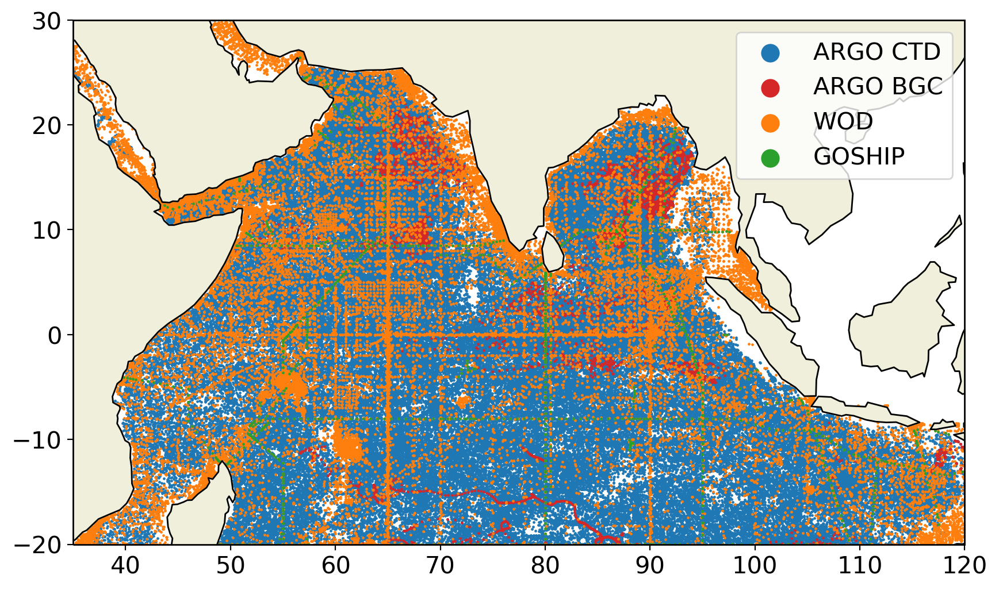

In [57]:
plt.rc('xtick',labelsize=15)
plt.rc('ytick',labelsize=15)

fig=plt.figure(figsize=(10,50),dpi=200)
ax=fig.add_subplot(111,projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100,110,120,130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10,0,10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())

s=0.5
ax.scatter(Core_LONGITUDE,Core_LATITUDE,s=s,label='ARGO CTD',c='C0')
ax.scatter(Bio_LONGITUDE,Bio_LATITUDE,s=s,label='ARGO BGC',c='C3')
ax.scatter(WOD_LONGITUDE,WOD_LATITUDE,s=s,label='WOD',c='C1')
ax.scatter(GOSHIP_LONGITUDE,GOSHIP_LATITUDE,s=s,label='GOSHIP',c='C2')

# ax.hlines(-10,50,70,linewidth=2),ax.hlines(10,50,70,linewidth=2)
# ax.vlines(50,-10,10,linewidth=2),ax.vlines(70,-10,10,linewidth=2)

# ax.hlines(-10,90,110,linewidth=2),ax.hlines(0,90,110,linewidth=2)
# ax.vlines(90,-10,0,linewidth=2),ax.vlines(110,-10,0,linewidth=2,label="DMI boxes")

# ax.text(0.275,0.37,"A",fontsize=50, transform=ax.transAxes)
# ax.text(0.75,0.27,"B",fontsize=50, transform=ax.transAxes)

plt.legend(markerscale=15,fontsize=15)
plt.savefig('space distribution.png')
plt.show()

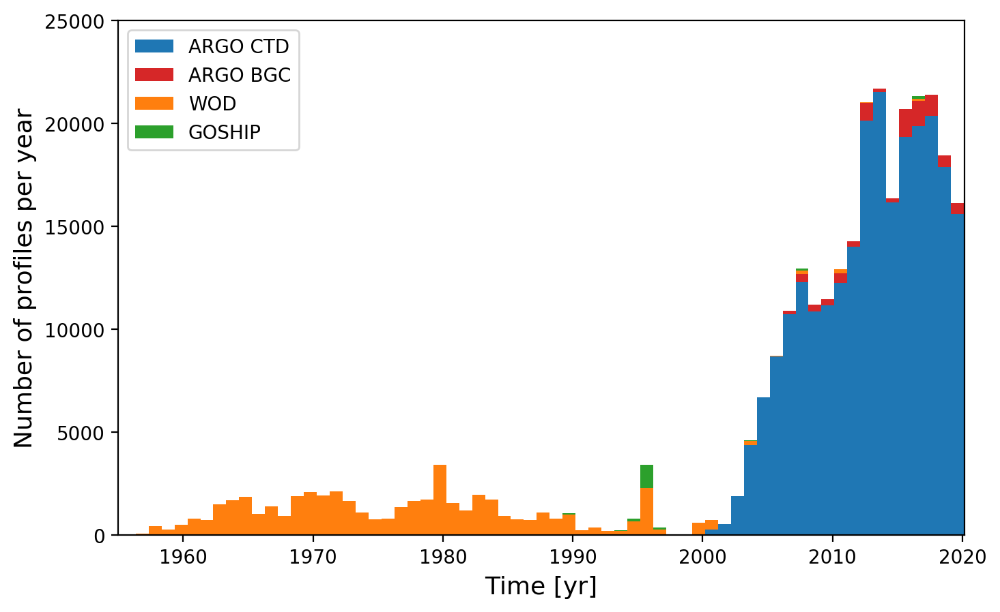

In [58]:
n_bins=193
legend = ['ARGO CTD','ARGO BGC','WOD', 'GOSHIP']
color=['C0','C3','C1','C2']

plt.rc('xtick',labelsize=10)
plt.rc('ytick',labelsize=10)

fig=plt.figure(figsize=(8,5),dpi=200)
ax=fig.add_subplot(111)

ax.hist([Core_TIME,Bio_TIME,WOD_TIME,GOSHIP_TIME], n_bins, color=color, 
         histtype='bar', stacked=True, label=legend)
ax.legend(loc="upper left")
ax.set_xlim(dt.date(1955,1,1),dt.date(2020,3,1))
ax.set_ylim(0,25000)

ax.set_ylabel('Number of profiles per year',fontsize=13)
ax.set_xlabel('Time [yr]',fontsize=13)

plt.legend(fontsize=10)
plt.savefig('time distribution.png')
fig.show()

## 4)a) Mean thermocline / oxycline : real and smooth

-1

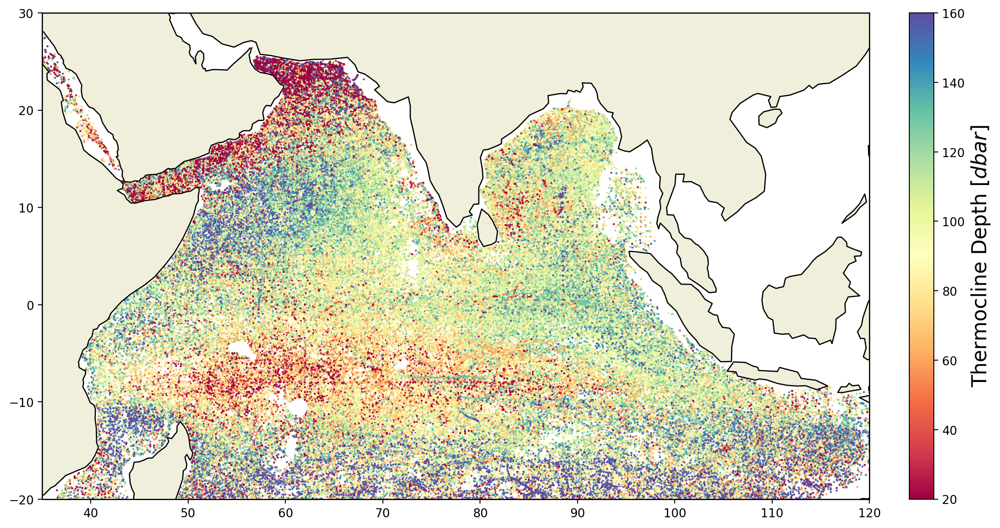

In [180]:
vmin=20
vmax=160
fsize=17

fig=plt.figure(figsize=(15,7.5),dpi=200)
ax=fig.add_subplot(111,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
#ax.set_title("Raw data - Thermocline Depth",fontsize=20)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100,110,120,130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10,0,10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())
c=ax.scatter(conc_LON,conc_LAT,s=0.5,vmin=vmin,vmax=vmax,c=conc_therm,cmap=plt.cm.Spectral)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Thermocline Depth [$dbar$]',size=fsize)
-1

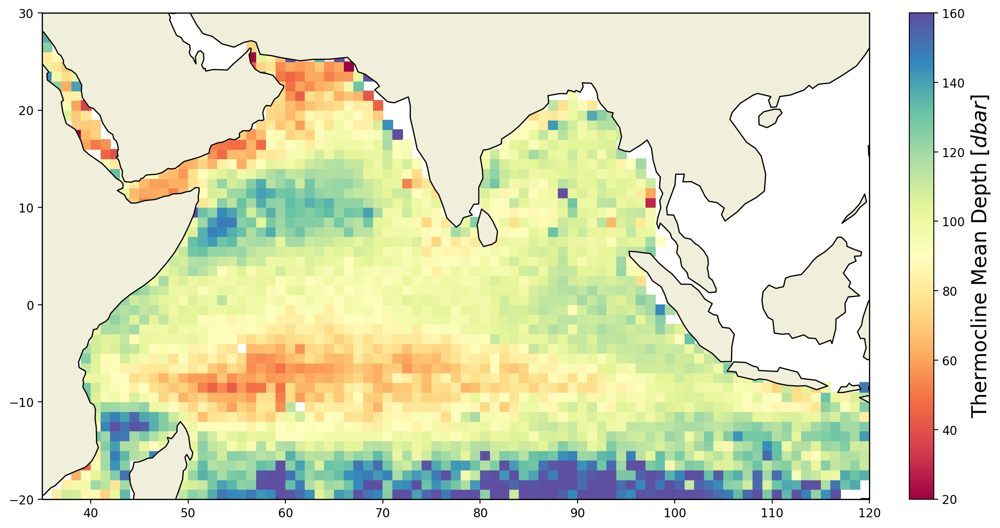

In [183]:
n=1
s=60
sig=1
vmin,vmax=20,160

moyenne,ecarttype,index,lat_range,lon_range=grid(conc_therm,conc_LON,conc_LAT,n=n)
fig=plt.figure(figsize=(15,7.5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
#ax.set_title("Gridded raw data - Thermocline Depth",fontsize=20)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne,s=s,cmap=plt.cm.Spectral,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Thermocline Mean Depth [$dbar$]',size=fsize)

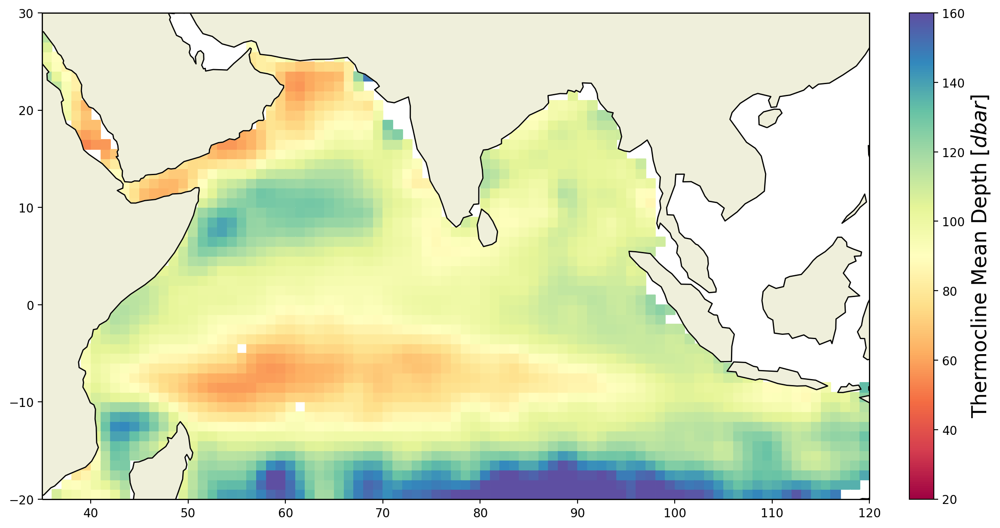

In [185]:
n=1
s=60
sig=1
vmin,vmax=20,160

moyenne,ecarttype,index,lat_range,lon_range=grid(conc_therm,conc_LON,conc_LAT,n=n)
fig=plt.figure(figsize=(15,7.5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
#ax.set_title("Gridded and smoothed raw data - Thermocline Depth",fontsize=20)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())

moyenne=smooth(moyenne,sigma=sig)
c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne,s=s,cmap=plt.cm.Spectral,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Thermocline Mean Depth [$dbar$]',size=fsize)

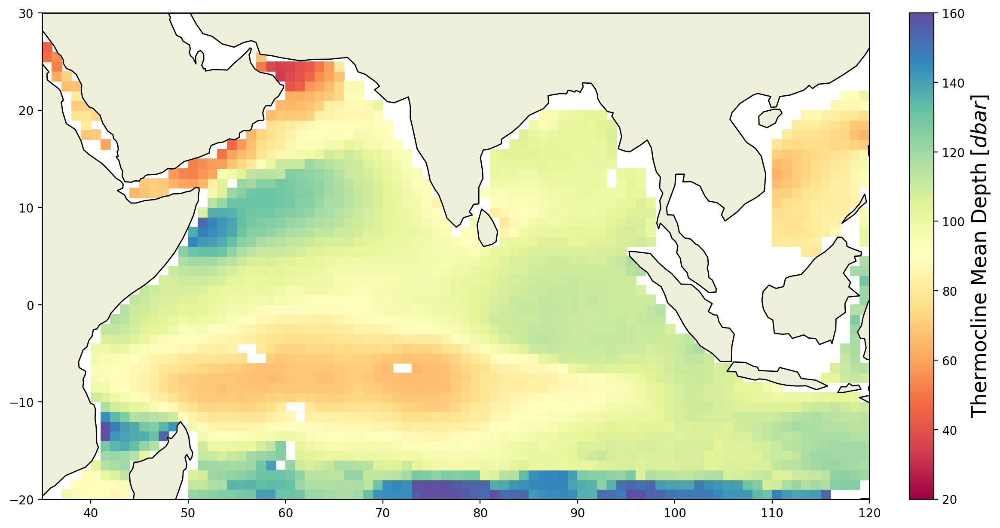

In [196]:
n=1
s=60
sig=1
vmin,vmax=20,160

moyenne,ecarttype,index,lat_range,lon_range=grid(WOA_therm,WOA_LONGITUDE,WOA_LATITUDE,n=n)
fig=plt.figure(figsize=(15,7.5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
#ax.set_title("Gridded WOA data - Thermocline Depth",fontsize=20)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne,s=s,cmap=plt.cm.Spectral,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Thermocline Mean Depth [$dbar$]',size=fsize)

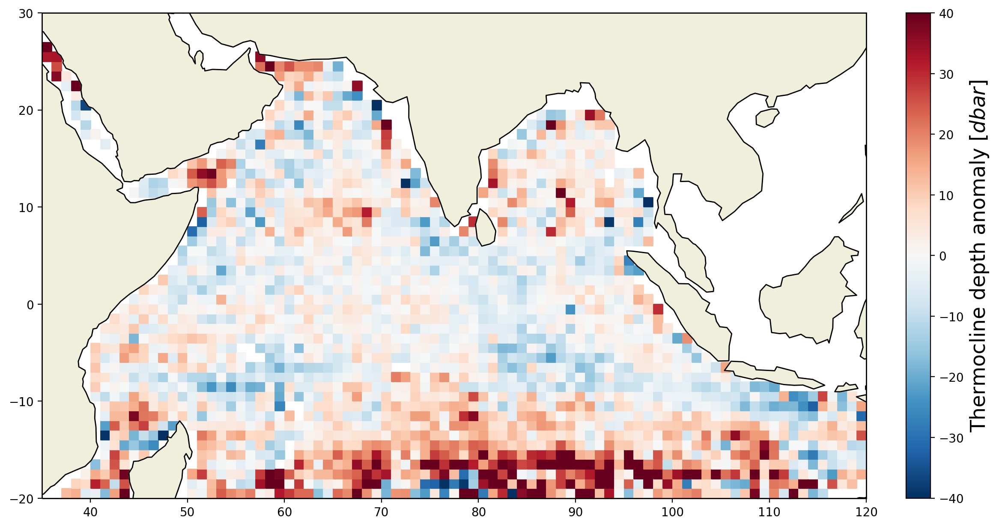

In [203]:
n=1
s=60
sig=1
vmin,vmax=-40,40

moyenne2,ecarttype,index,lat_range,lon_range=grid(WOA_therm,WOA_LONGITUDE,WOA_LATITUDE,n=n)
moyenne1,ecarttype,index,lat_range,lon_range=grid(conc_therm,conc_LON,conc_LAT,n=n)
moyenne=moyenne1-moyenne2

fig=plt.figure(figsize=(15,7.5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
#ax.set_title("Gridded WOA data - Oxycline Depth",fontsize=20)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne,s=s,cmap=plt.cm.RdBu_r,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Thermocline depth anomaly [$dbar$]',size=fsize)

-1

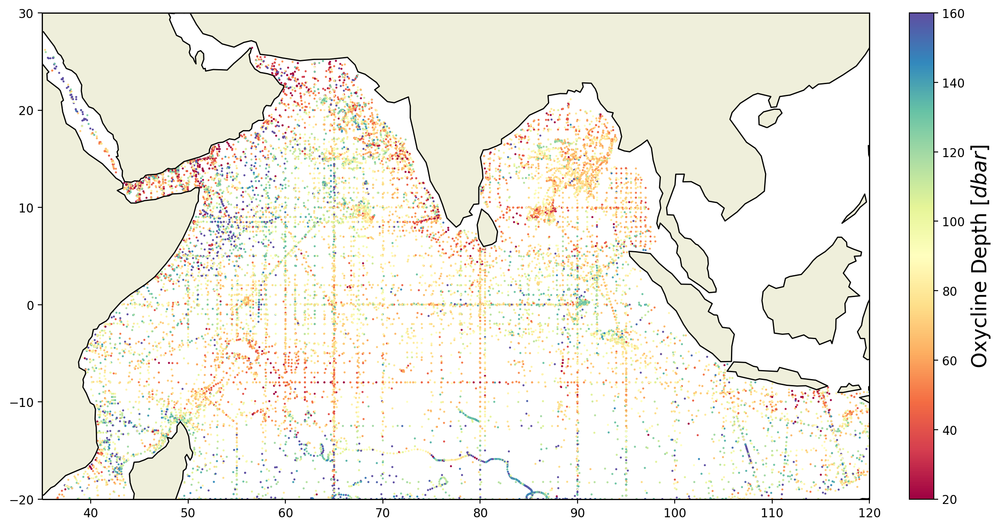

In [188]:
vmin=20
vmax=160

fig=plt.figure(figsize=(15,7.5),dpi=200)
ax=fig.add_subplot(111,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
#ax.set_title("Raw data - Oxycline Depth",fontsize=20)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100,110,120,130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10,0,10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())
c=ax.scatter(conc_LON_ox,conc_LAT_ox,s=0.5,vmin=vmin,vmax=vmax,c=conc_oxyc,cmap=plt.cm.Spectral)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Oxycline Depth [$dbar$]',size=fsize)
-1

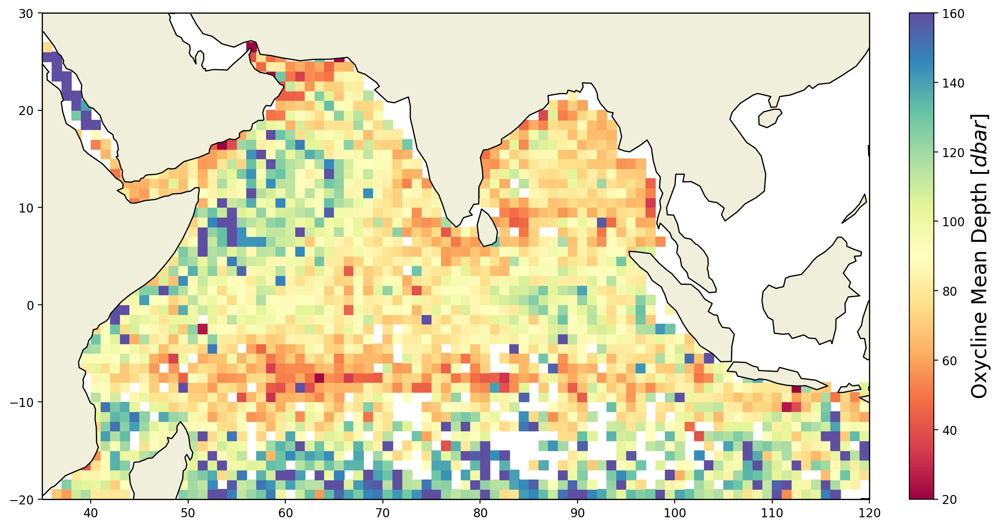

In [189]:
n=1
s=60
sig=1
vmin,vmax=20,160

moyenne,ecarttype,index,lat_range,lon_range=grid(conc_oxyc,conc_LON_ox,conc_LAT_ox,n=n)
fig=plt.figure(figsize=(15,7.5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
#ax.set_title("Gridded real data - Oxycline Depth",fontsize=20)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne,s=s,cmap=plt.cm.Spectral,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Oxycline Mean Depth [$dbar$]',size=fsize)

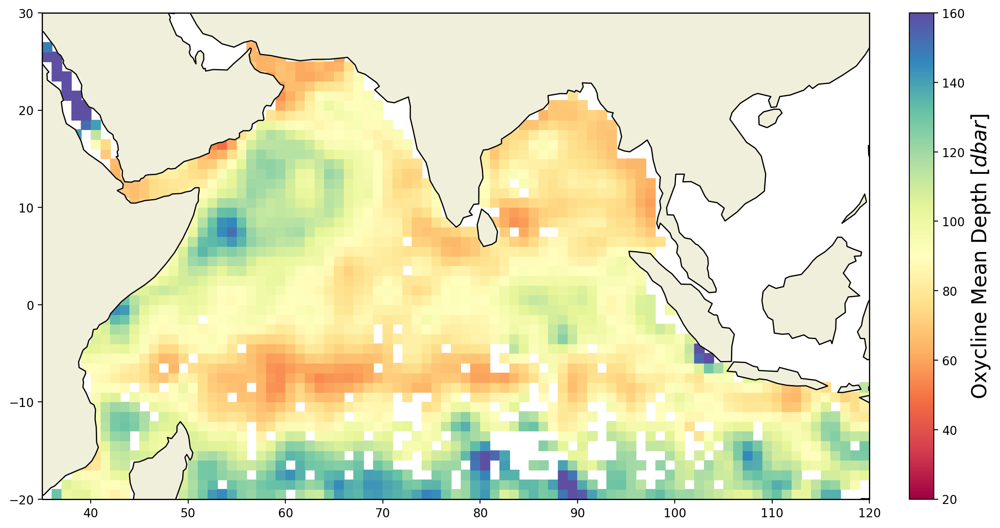

In [190]:
n=1
s=60
sig=1
vmin,vmax=20,160

moyenne,ecarttype,index,lat_range,lon_range=grid(conc_oxyc,conc_LON_ox,conc_LAT_ox,n=n)
fig=plt.figure(figsize=(15,7.5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
#ax.set_title("Gridded and smoothed real data - Oxycline Depth",fontsize=20)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())

moyenne=smooth(moyenne,sigma=sig)
c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne,s=s,cmap=plt.cm.Spectral,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Oxycline Mean Depth [$dbar$]',size=fsize)

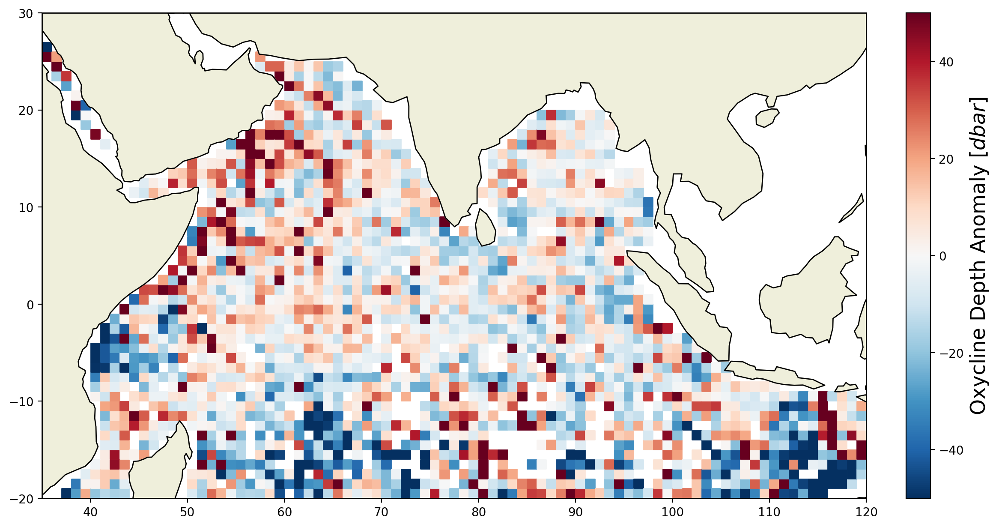

In [206]:
n=1
s=60
sig=1
vmin,vmax=-50,50

moyenne2,ecarttype,index,lat_range,lon_range=grid(WOA_oxyc,WOA_LONGITUDE,WOA_LATITUDE,n=n)
moyenne1,ecarttype,index,lat_range,lon_range=grid(conc_oxyc,conc_LON_ox,conc_LAT_ox,n=n)
moyenne=moyenne1-moyenne2

fig=plt.figure(figsize=(15,7.5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
#ax.set_title("Gridded WOA data - Oxycline Depth",fontsize=20)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne,s=s,cmap=plt.cm.RdBu_r,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Oxycline Depth Anomaly [$dbar$]',size=fsize)

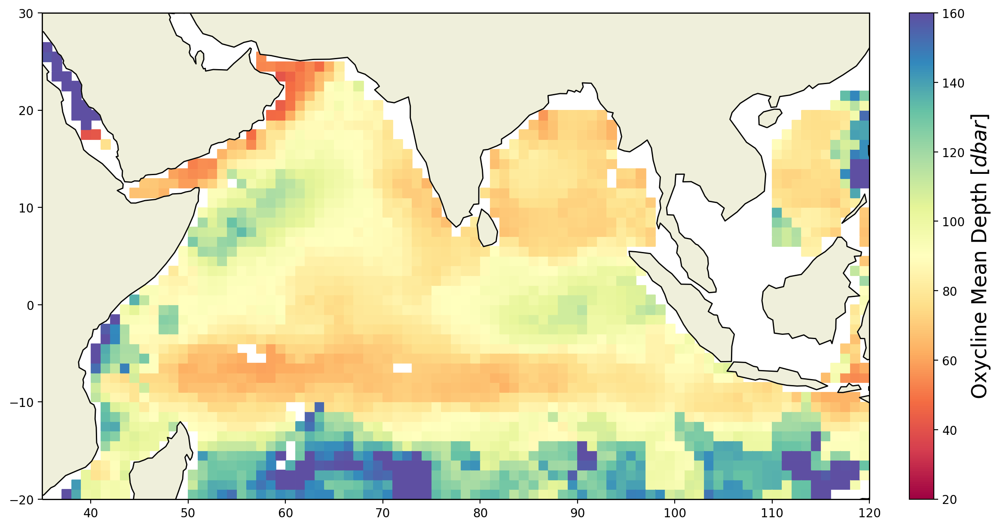

In [205]:
n=1
s=60
sig=1
vmin,vmax=20,160

moyenne,ecarttype,index,lat_range,lon_range=grid(WOA_oxyc,WOA_LONGITUDE,WOA_LATITUDE,n=n)
fig=plt.figure(figsize=(15,7.5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
#ax.set_title("Gridded WOA data - Oxycline Depth",fontsize=20)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne,s=s,cmap=plt.cm.Spectral,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Oxycline Mean Depth [$dbar$]',size=fsize)

## 4)b) Map mean/min thermocline oxycline 

### 4)b)i) All Indian Ocean

-1

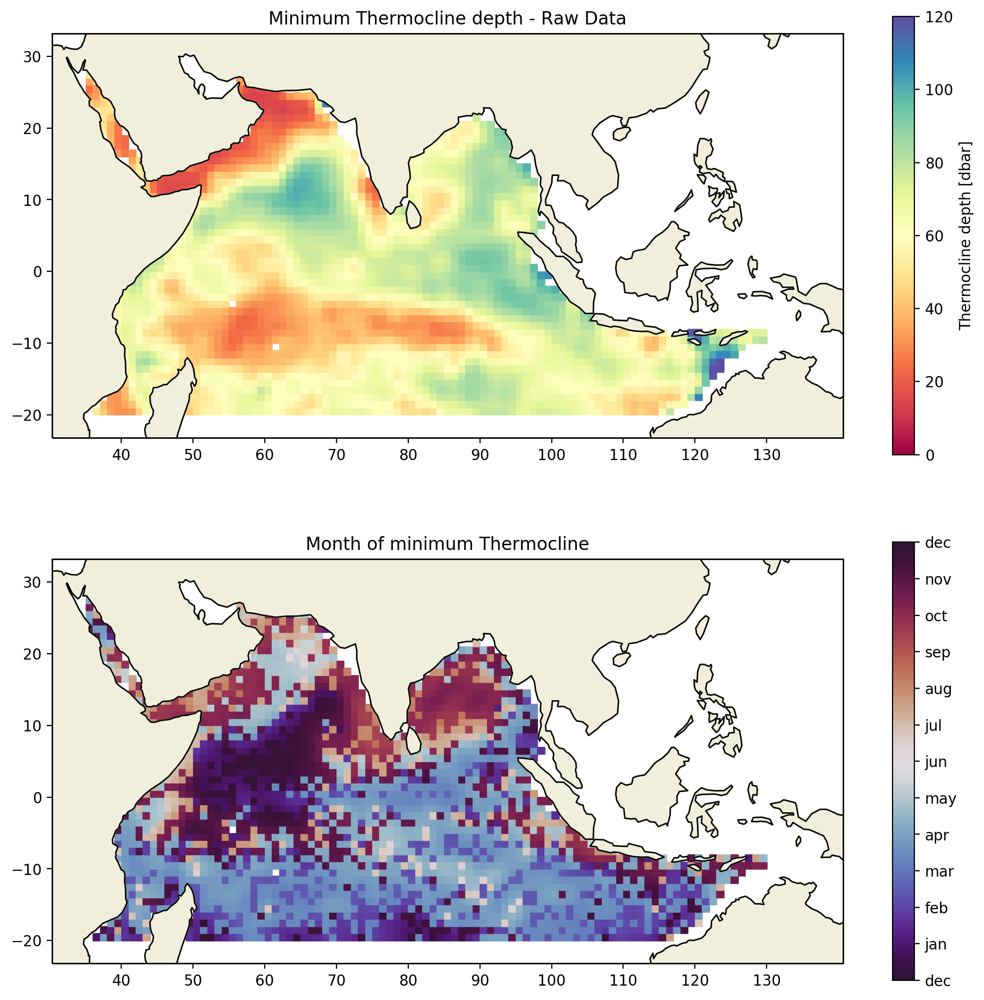

In [68]:
n=1
s=20 #8
vmin=0
vmax=120

grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_therm,conc_LON,conc_LAT,conc_Month,n=n)
minimum=np.nanmin(grid_value,axis=2)

minimum_month=np.full(np.shape(minimum),np.nan)
minimum_season=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini
            seas=int((mini-1)/3)+0.5
            minimum_season[i,j]=seas

minimum=smooth(minimum)
minimum_month_cos=smooth_cos(minimum_month)
minimum_month_sin=smooth_sin(minimum_month)
minimum_month=estimation_mois(minimum_month,minimum_month_sin,minimum_month_cos)


fig=plt.figure(figsize=(12,12),dpi=200)

ax=fig.add_subplot(211,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum,marker='s',cmap=plt.cm.Spectral,s=s,vmin=vmin,vmax=vmax)
plt.colorbar(c,label='Thermocline depth [dbar]')

ax.set_title("Minimum Thermocline depth - Raw Data")

ax=fig.add_subplot(212,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum_month,marker='s',
              vmin=0,vmax=12,cmap=plt.cm.twilight_shifted,s=s)
cbar=plt.colorbar(c)
cbar.set_ticks(np.linspace(0,12,13))
cbar.set_ticklabels(['dec','jan','feb','mar','apr','may','jun',
                    'jul','aug','sep','oct','nov','dec'])

ax.set_title("Month of minimum Thermocline")

# ax=fig.add_subplot(313,projection=ccrs.PlateCarree())
# ax.add_feature(cfeature.COASTLINE,zorder=2)
# ax.add_feature(cfeature.LAND,zorder=1)
# ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
# ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

# c=ax.scatter(lon_range,lat_range,c=minimum_season,marker='s',
#               vmin=0,vmax=4,cmap=plt.cm.twilight_shifted,s=s)
# cbar=plt.colorbar(c)
# cbar.set_ticks([0.5,1.5,2.5,3.5])
# cbar.set_ticklabels(['win','spr','sum','aut'])

# ax.set_title("Season of minimum Thermocline")
-1

Text(0.5, 1.0, 'Month of minimum seasonnal oxycline')

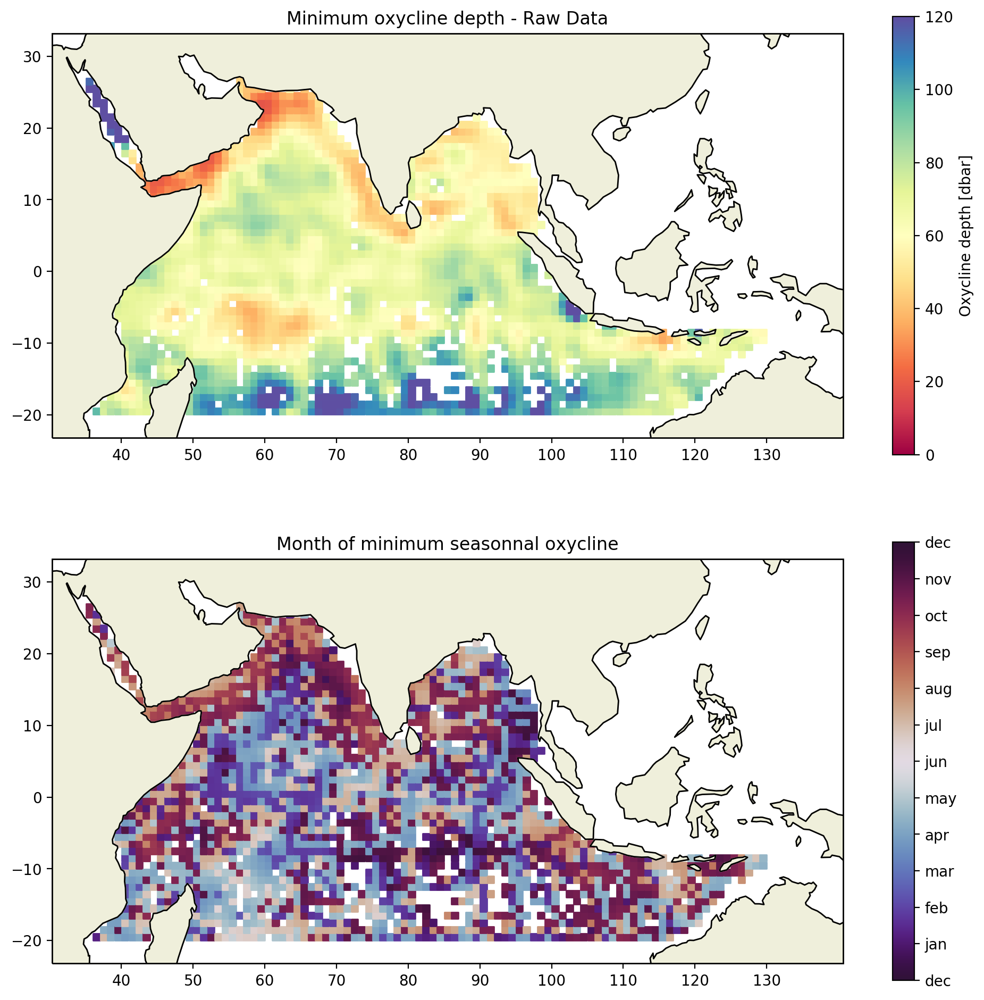

In [69]:
n=1
s=20 #8
vmin=0
vmax=120

grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_oxyc,conc_LON_ox,conc_LAT_ox,conc_Month_ox,n=n)
minimum=np.nanmin(grid_value,axis=2)

minimum_month=np.full(np.shape(minimum),np.nan)
minimum_season=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini
            seas=int((mini-1)/3)+0.5
            minimum_season[i,j]=seas
            
minimum=smooth(minimum)
minimum_month_cos=smooth_cos(minimum_month)
minimum_month_sin=smooth_sin(minimum_month)
minimum_month=estimation_mois(minimum_month,minimum_month_sin,minimum_month_cos)

            
fig=plt.figure(figsize=(12,12),dpi=200)


ax=fig.add_subplot(211,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20, 30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum,marker='s',cmap=plt.cm.Spectral,s=s,vmin=vmin,vmax=vmax)
plt.colorbar(c,label="Oxycline depth [dbar]")

ax.set_title("Minimum oxycline depth - Raw Data")

ax=fig.add_subplot(212,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20, 30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum_month,marker='s',
              vmin=0,vmax=12,cmap=plt.cm.twilight_shifted,s=s)
cbar=plt.colorbar(c)
cbar.set_ticks(np.linspace(0,12,13))
cbar.set_ticklabels(['dec','jan','feb','mar','apr','may','jun',
                    'jul','aug','sep','oct','nov','dec'])

ax.set_title("Month of minimum seasonnal oxycline")

# ax=fig.add_subplot(313,projection=ccrs.PlateCarree())
# ax.add_feature(cfeature.COASTLINE,zorder=2)
# ax.add_feature(cfeature.LAND,zorder=1)
# ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
# ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

# c=ax.scatter(lon_range,lat_range,c=minimum_season,marker='s',
#               vmin=0,vmax=4,cmap=plt.cm.twilight_shifted,s=s)
# cbar=plt.colorbar(c)
# cbar.set_ticks([0.5,1.5,2.5,3.5])
# cbar.set_ticklabels(['win','spr','sum','aut'])

# ax.set_title("Season of minimum oxycline")

-1

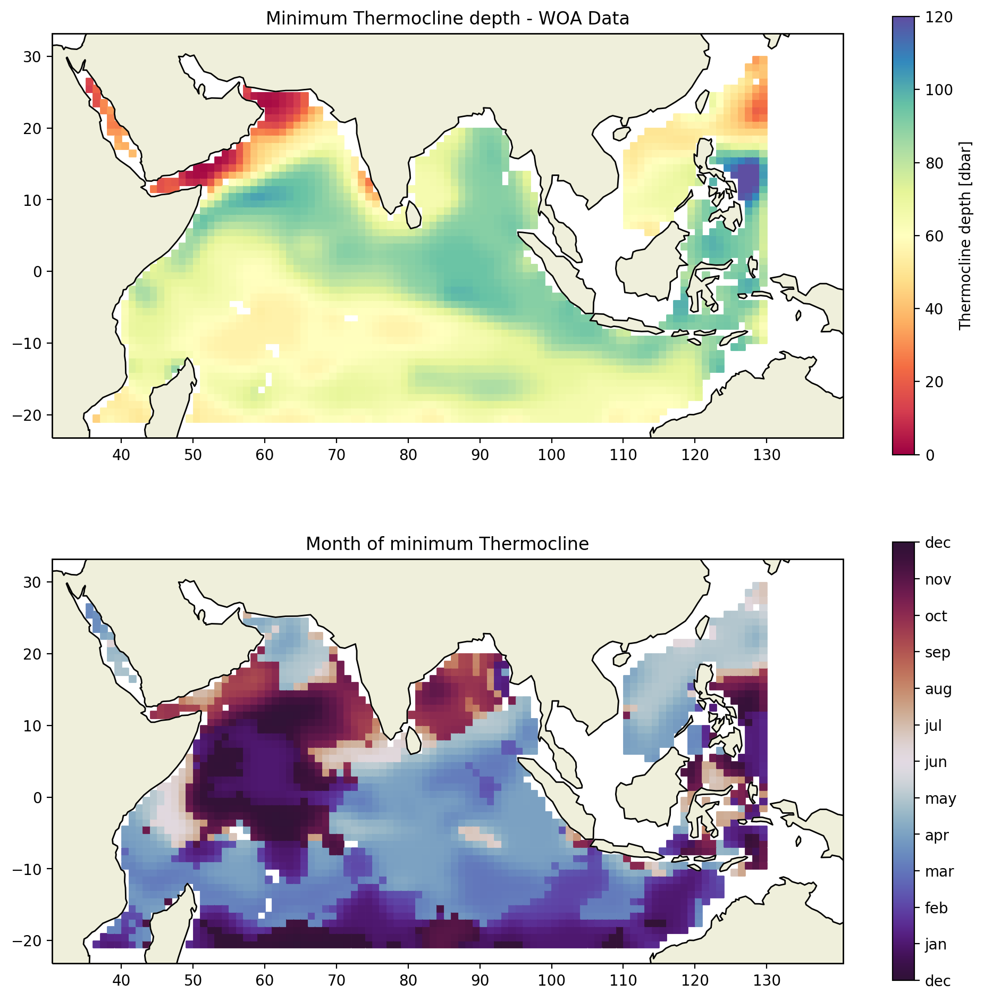

In [70]:
n=1
s=20 #8
vmin=0
vmax=120

grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(WOA_therm,WOA_LONGITUDE,WOA_LATITUDE,WOA_Month,n=n)
minimum=np.nanmin(grid_value,axis=2)

minimum_month=np.full(np.shape(minimum),np.nan)
minimum_season=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini
            seas=int((mini-1)/3)+0.5
            minimum_season[i,j]=seas

minimum=smooth(minimum)
minimum_month_cos=smooth_cos(minimum_month)
minimum_month_sin=smooth_sin(minimum_month)
minimum_month=estimation_mois(minimum_month,minimum_month_sin,minimum_month_cos)

fig=plt.figure(figsize=(12,12),dpi=200)

ax=fig.add_subplot(211,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum,marker='s',cmap=plt.cm.Spectral,s=s,vmin=vmin,vmax=vmax)
plt.colorbar(c,label='Thermocline depth [dbar]')          

ax.set_title("Minimum Thermocline depth - WOA Data")

ax=fig.add_subplot(212,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum_month,marker='s',
              vmin=0,vmax=12,cmap=plt.cm.twilight_shifted,s=s)
cbar=plt.colorbar(c)
cbar.set_ticks(np.linspace(0,12,13))
cbar.set_ticklabels(['dec','jan','feb','mar','apr','may','jun',
                    'jul','aug','sep','oct','nov','dec'])

ax.set_title("Month of minimum Thermocline")

# ax=fig.add_subplot(313,projection=ccrs.PlateCarree())
# ax.add_feature(cfeature.COASTLINE,zorder=2)
# ax.add_feature(cfeature.LAND,zorder=1)
# ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
# ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

# c=ax.scatter(lon_range,lat_range,c=minimum_season,marker='s',
#               vmin=0,vmax=4,cmap=plt.cm.twilight_shifted,s=s)
# cbar=plt.colorbar(c)
# cbar.set_ticks([0.5,1.5,2.5,3.5])
# cbar.set_ticklabels(['win','spr','sum','aut'])

# ax.set_title("Season of minimum Thermocline")
-1

Text(0.5, 1.0, 'Month of minimum oxycline')

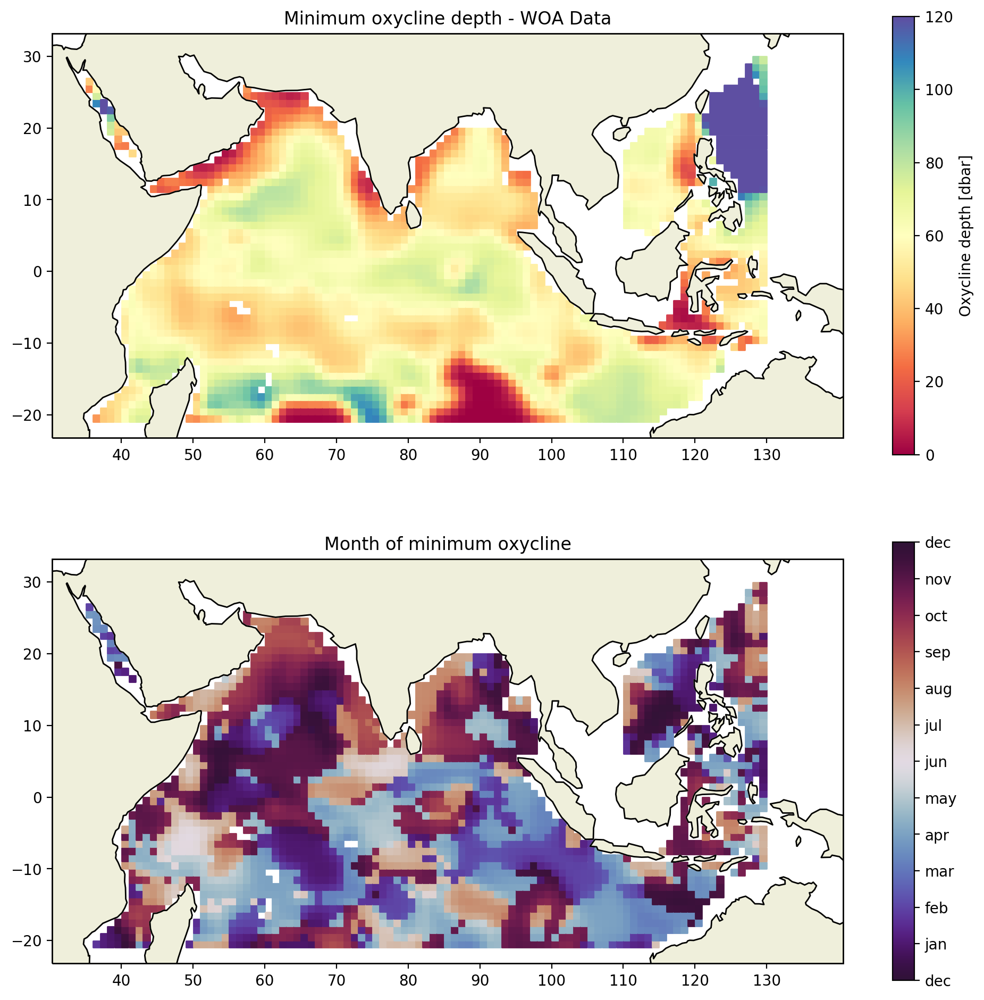

In [71]:
n=1
s=20 #8
vmin=0
vmax=120

grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(WOA_oxyc,WOA_LONGITUDE,WOA_LATITUDE,WOA_Month,n=n)
minimum=np.nanmin(grid_value,axis=2)


minimum_month=np.full(np.shape(minimum),np.nan)
minimum_season=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini
            seas=int((mini-1)/3)+0.5
            minimum_season[i,j]=seas

minimum=smooth(minimum)
minimum_month_cos=smooth_cos(minimum_month)
minimum_month_sin=smooth_sin(minimum_month)
minimum_month=estimation_mois(minimum_month,minimum_month_sin,minimum_month_cos)


fig=plt.figure(figsize=(12,12),dpi=200)

ax=fig.add_subplot(211,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20, 30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum,marker='s',cmap=plt.cm.Spectral,s=s,vmin=vmin,vmax=vmax)
plt.colorbar(c,label="Oxycline depth [dbar]")

ax.set_title("Minimum oxycline depth - WOA Data")

ax=fig.add_subplot(212,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20, 30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum_month,marker='s',
              vmin=0,vmax=12,cmap=plt.cm.twilight_shifted,s=s)
cbar=plt.colorbar(c)
cbar.set_ticks(np.linspace(0,12,13))
cbar.set_ticklabels(['dec','jan','feb','mar','apr','may','jun',
                    'jul','aug','sep','oct','nov','dec'])

ax.set_title("Month of minimum oxycline")

# ax=fig.add_subplot(313,projection=ccrs.PlateCarree())
# ax.add_feature(cfeature.COASTLINE,zorder=2)
# ax.add_feature(cfeature.LAND,zorder=1)
# ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
# ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

# c=ax.scatter(lon_range,lat_range,c=minimum_season,marker='s',
#               vmin=0,vmax=4,cmap=plt.cm.twilight_shifted,s=s)
# cbar=plt.colorbar(c)
# cbar.set_ticks([0.5,1.5,2.5,3.5])
# cbar.set_ticklabels(['win','spr','sum','aut'])

# ax.set_title("Season of minimum oxycline")

### 4)b)ii) Coastal

-1

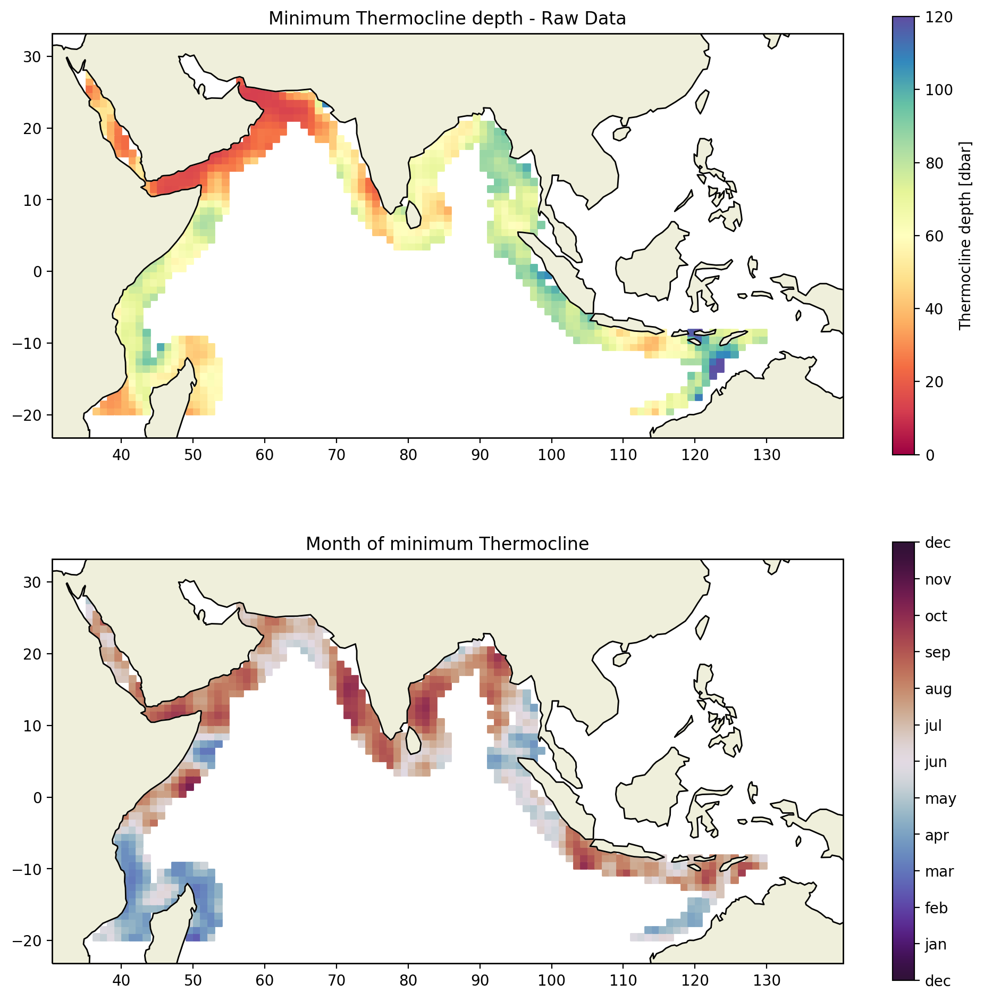

In [72]:
n=1
s=20 #8
vmin=0
vmax=120

mask=mask_coast(conc_LON,conc_LAT,lonmin,lonmax,latmin,latmax)

grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_therm[mask],conc_LON[mask],conc_LAT[mask],conc_Month[mask],n=n)
minimum=np.nanmin(grid_value,axis=2)


minimum_month=np.full(np.shape(minimum),np.nan)
minimum_season=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini
            seas=int((mini-1)/3)+0.5
            minimum_season[i,j]=seas

minimum=smooth(minimum)
minimum_month=smooth(minimum_month)*12/np.nanmax(minimum_month)
minimum_season=smooth(minimum_season)
            
fig=plt.figure(figsize=(12,12),dpi=200)

ax=fig.add_subplot(211,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum,marker='s',cmap=plt.cm.Spectral,s=s,vmin=vmin,vmax=vmax)
plt.colorbar(c,label='Thermocline depth [dbar]')            

ax.set_title("Minimum Thermocline depth - Raw Data")

ax=fig.add_subplot(212,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum_month,marker='s',
              vmin=0,vmax=12,cmap=plt.cm.twilight_shifted,s=s)
cbar=plt.colorbar(c)
cbar.set_ticks(np.linspace(0,12,13))
cbar.set_ticklabels(['dec','jan','feb','mar','apr','may','jun',
                    'jul','aug','sep','oct','nov','dec'])

ax.set_title("Month of minimum Thermocline")

# ax=fig.add_subplot(313,projection=ccrs.PlateCarree())
# ax.add_feature(cfeature.COASTLINE,zorder=2)
# ax.add_feature(cfeature.LAND,zorder=1)
# ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
# ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

# c=ax.scatter(lon_range,lat_range,c=minimum_season,marker='s',
#               vmin=0,vmax=4,cmap=plt.cm.twilight_shifted,s=s)
# cbar=plt.colorbar(c)
# cbar.set_ticks([0.5,1.5,2.5,3.5])
# cbar.set_ticklabels(['win','spr','sum','aut'])

# ax.set_title("Season of minimum Thermocline")
-1

Text(0.5, 1.0, 'Month of minimum oxycline')

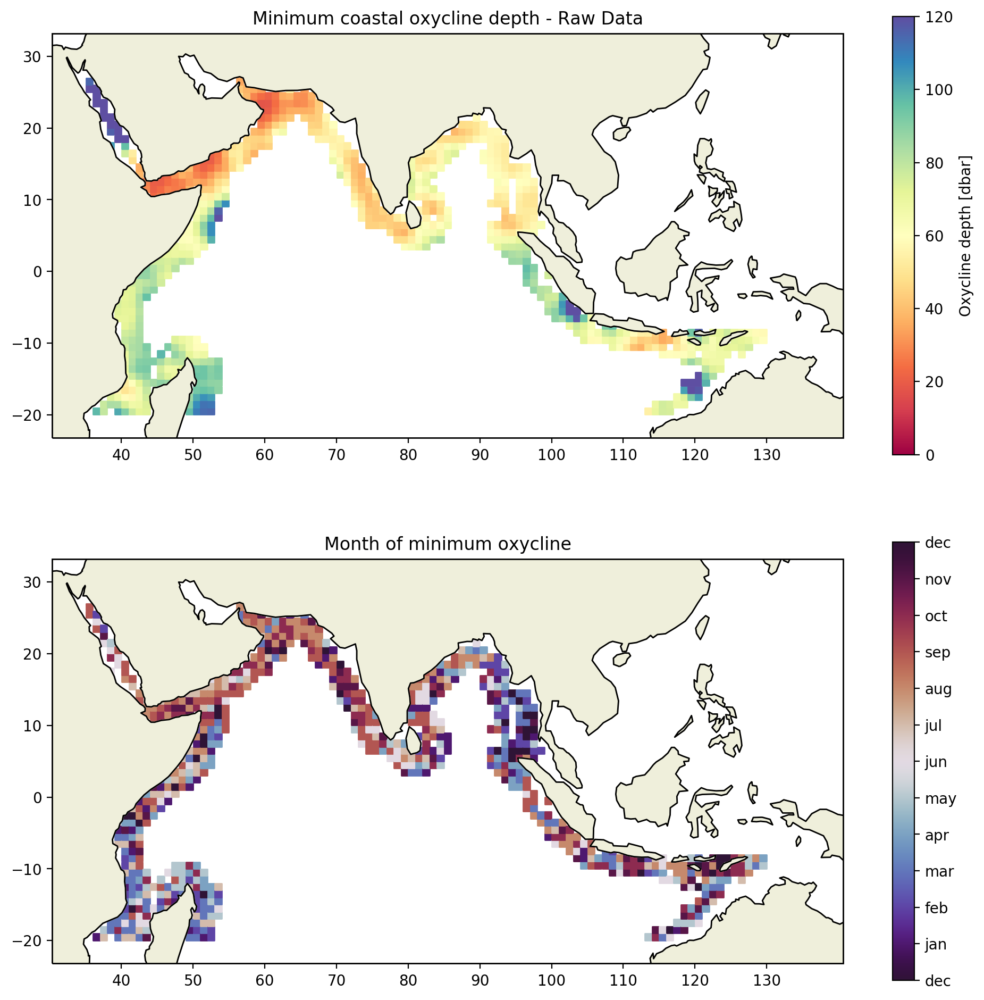

In [73]:
n=1
s=20 #8
vmin=0
vmax=120

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lonmin,lonmax,latmin,latmax)

grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_oxyc[mask],conc_LON_ox[mask],conc_LAT_ox[mask],conc_Month_ox[mask],n=n)
minimum=np.nanmin(grid_value,axis=2)


minimum_month=np.full(np.shape(minimum),np.nan)
minimum_season=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini
            seas=int((mini-1)/3)+0.5
            minimum_season[i,j]=seas

minimum=smooth(minimum)
#minimum_month=smooth(minimum_month)*12/np.nanmax(minimum_month)
minimum_season=smooth(minimum_season)
            
fig=plt.figure(figsize=(12,12),dpi=200)

ax=fig.add_subplot(211,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20, 30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum,marker='s',cmap=plt.cm.Spectral,s=s,vmin=vmin,vmax=vmax)
plt.colorbar(c,label="Oxycline depth [dbar]")

ax.set_title("Minimum coastal oxycline depth - Raw Data")

ax=fig.add_subplot(212,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20, 30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum_month,marker='s',
              vmin=0,vmax=12,cmap=plt.cm.twilight_shifted,s=s)
cbar=plt.colorbar(c)
cbar.set_ticks(np.linspace(0,12,13))
cbar.set_ticklabels(['dec','jan','feb','mar','apr','may','jun',
                    'jul','aug','sep','oct','nov','dec'])

ax.set_title("Month of minimum oxycline")

# ax=fig.add_subplot(313,projection=ccrs.PlateCarree())
# ax.add_feature(cfeature.COASTLINE,zorder=2)
# ax.add_feature(cfeature.LAND,zorder=1)
# ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
# ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

# c=ax.scatter(lon_range,lat_range,c=minimum_season,marker='s',
#               vmin=0,vmax=4,cmap=plt.cm.twilight_shifted,s=s)
# cbar=plt.colorbar(c)
# cbar.set_ticks([0.5,1.5,2.5,3.5])
# cbar.set_ticklabels(['win','spr','sum','aut'])

# ax.set_title("Season of minimum oxycline")

## 4)c) correlation

### 4)c)i) Thermocline vs oxycline: saisonnier et interanuel

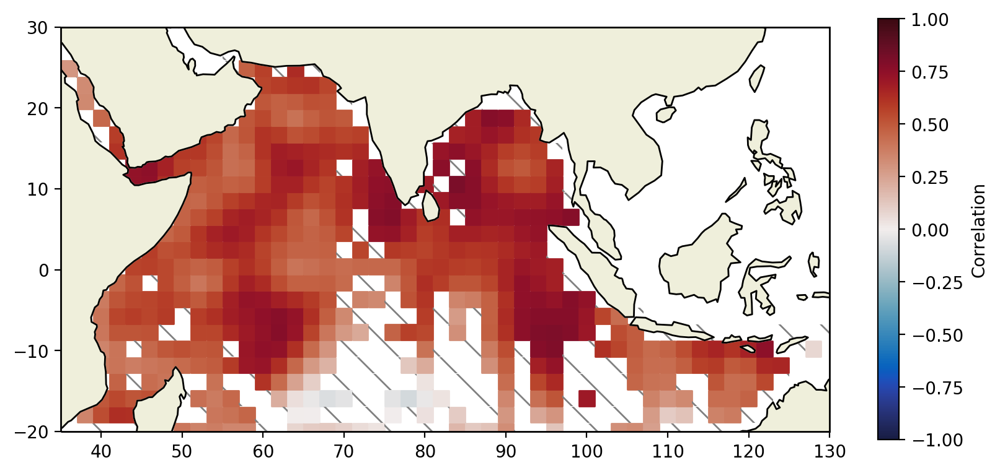

In [74]:
n=2
s=80
nbr=11
space=n/2
fsize=13

corr,reg,index,lat,lon,_,_=grid_correlation(conc_oxyc, conc_therm_ox, conc_LON_ox, 
                                                conc_LAT_ox, 
                                                reg_slope=False,n=n)
corr=smooth(corr)

fig=plt.figure(figsize=(10,5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20, 30], crs=ccrs.PlateCarree())
#ax.set_title('Thermocline vs Oxycline seasonnal - Raw Data [fill: n<10]',fontsize=25)
ax.set_extent((35,130,-20,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon,lat,marker='s',c=corr,s=s,vmin=-1,vmax=1,cmap=cmocean.cm.balance)
plt.colorbar(c,shrink=0.9,label='Correlation')

for i in range(np.shape(lon)[0]):
    for j in range(np.shape(lon)[1]):
        if index[i,j]<nbr and index[i,j]>0:
            lon_tmp=lon[i,j]
            lat_tmp=lat[i,j]
            ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                    [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                    fill=False, hatch='\\ ',c='grey',linewidth=0.0001)
            
for i,j in zip([24,23,24,19],
                [3,3,2,5]):
    lon_tmp,lat_tmp=lon[i,j],lat[i,j]
    ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                        [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                        fill=False, hatch='\\ ',c='grey',linewidth=0.0001)

    
plt.savefig("Seasonnal correlation.png")

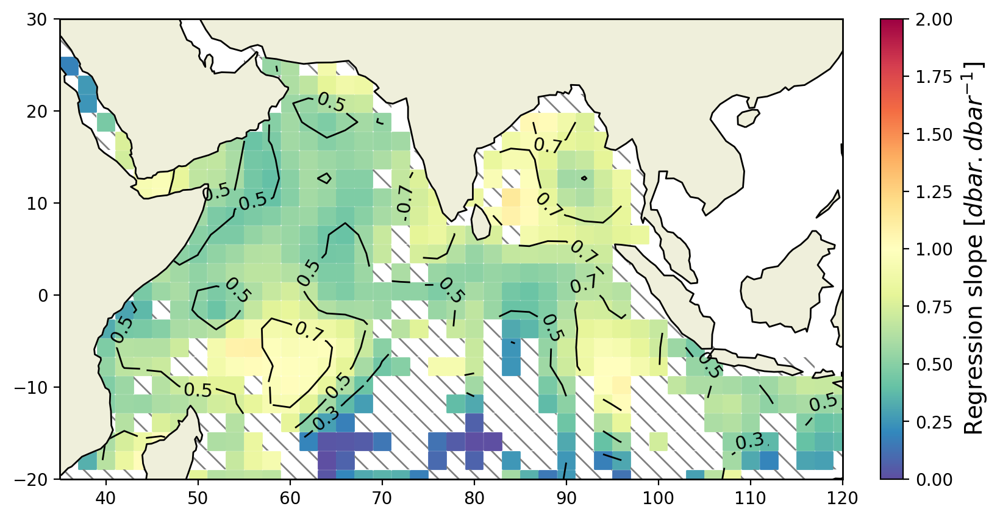

In [75]:
n=2
s=100
nbr=11
space=n/2
fsize=14

corr,reg,index,lat,lon,_,_=grid_correlation(conc_oxyc, conc_therm_ox, conc_LON_ox, 
                                                conc_LAT_ox, 
                                                reg_slope=True,n=n)
corr=smooth(corr)

fig=plt.figure(figsize=(10,5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20, 30], crs=ccrs.PlateCarree())
#ax.set_title('Thermocline vs Oxycline seasonnal - Raw Data [fill: n<10]',fontsize=25)
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon,lat,marker='s',c=corr,s=s,vmin=0,vmax=2,cmap=plt.cm.Spectral_r)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Regression slope [$dbar.dbar^{-1}$]',size=fsize)

for i in range(np.shape(lon)[0]):
    for j in range(np.shape(lon)[1]):
        if index[i,j]<nbr and index[i,j]>0:
            lon_tmp=lon[i,j]
            lat_tmp=lat[i,j]
            ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                    [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                    fill=False, hatch='\\\ ',c='grey',linewidth=0.0001)
            
for i,j in zip([24,23,24,19],
                [3,3,2,5]):
    lon_tmp,lat_tmp=lon[i,j],lat[i,j]
    ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                        [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                        fill=False, hatch='\\\ ',c='grey',linewidth=0.0001)
    
corr,reg,index,lat,lon,_,_=grid_correlation(conc_oxyc, conc_therm_ox, conc_LON_ox, conc_LAT_ox, reg_slope=False,n=n)
corr=smooth(corr)
contours = ax.contour(lon,lat,corr,levels=[0.3,0.5,0.7],linewidths=1,colors='black')
plt.clabel(contours, inline=True, fontsize=11 ,fmt='%1.1f')
    
plt.savefig("Seasonnal regression.png")

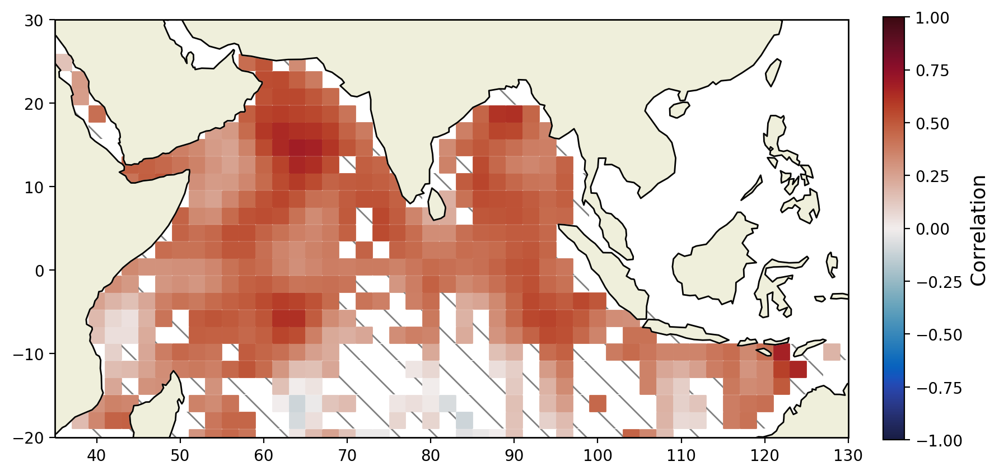

In [76]:
n=2
s=101
nbr=11
space=n/2
fsize=13

corr,reg,index,lat,lon,_,_=grid_correlation(conc_oxyc_an, conc_therm_an_ox, conc_LON_ox, 
                                                conc_LAT_ox, 
                                                reg_slope=False,n=n)
corr=smooth(corr)

fig=plt.figure(figsize=(10,5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20, 30], crs=ccrs.PlateCarree())
#ax.set_title('Thermocline vs Oxycline interannual - Raw Data [fill: n<10]',fontsize=25)
ax.set_extent((35,130,-20,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon,lat,marker='s',c=corr,s=s,vmin=-1,vmax=1,cmap=cmocean.cm.balance)
cb=fig.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label('Correlation',size=fsize)


for i in range(np.shape(lon)[0]):
    for j in range(np.shape(lon)[1]):
        if index[i,j]<nbr and index[i,j]>0:
            lon_tmp=lon[i,j]
            lat_tmp=lat[i,j]
            ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                    [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                    fill=False, hatch='\\ ',c='grey',linewidth=0.0001)

for i,j in zip([24,23,24,19],
                [3,3,2,5]):
    lon_tmp,lat_tmp=lon[i,j],lat[i,j]
    ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                        [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                        fill=False, hatch='\\ ',c='grey',linewidth=0.0001)
    
plt.savefig("Interannual correlation.png")

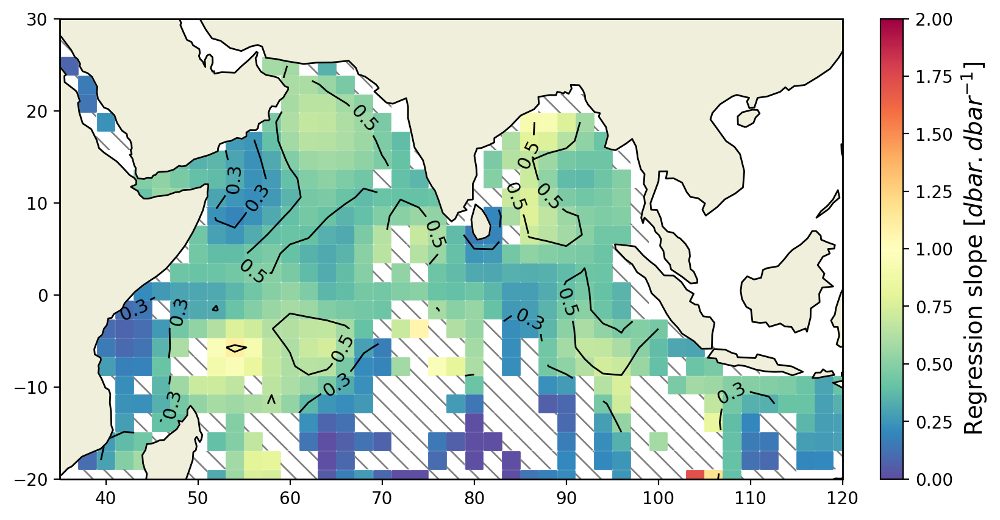

In [77]:
n=2
s=100
nbr=11
space=n/2
fsize=14

corr,reg,index,lat,lon,_,_=grid_correlation(conc_oxyc_an, conc_therm_an_ox, conc_LON_ox, 
                                                conc_LAT_ox, 
                                                reg_slope=True,n=n)
corr=smooth(corr)

fig=plt.figure(figsize=(10,5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20, 30], crs=ccrs.PlateCarree())
#ax.set_title('Thermocline vs Oxycline seasonnal - Raw Data [fill: n<10]',fontsize=25)
ax.set_extent((35,120,-20,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon,lat,marker='s',c=corr,s=s,vmin=0,vmax=2,cmap=plt.cm.Spectral_r)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Regression slope [$dbar.dbar^{-1}$]',size=fsize)

for i in range(np.shape(lon)[0]):
    for j in range(np.shape(lon)[1]):
        if index[i,j]<nbr and index[i,j]>0:
            lon_tmp=lon[i,j]
            lat_tmp=lat[i,j]
            ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                    [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                    fill=False, hatch='\\\ ',c='grey',linewidth=0.0001)
            
for i,j in zip([24,23,24,19],
                [3,3,2,5]):
    lon_tmp,lat_tmp=lon[i,j],lat[i,j]
    ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                        [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                        fill=False, hatch='\\\ ',c='grey',linewidth=0.0001)
    
corr,reg,index,lat,lon,_,_=grid_correlation(conc_oxyc_an, conc_therm_an_ox, conc_LON_ox, conc_LAT_ox, reg_slope=False,n=n)
corr=smooth(corr)
contours = ax.contour(lon,lat,corr,levels=[0.3,0.5,0.7],linewidths=1,colors='black')
plt.clabel(contours, inline=True, fontsize=11 ,fmt='%1.1f')
    
plt.savefig("Interannual regression.png")

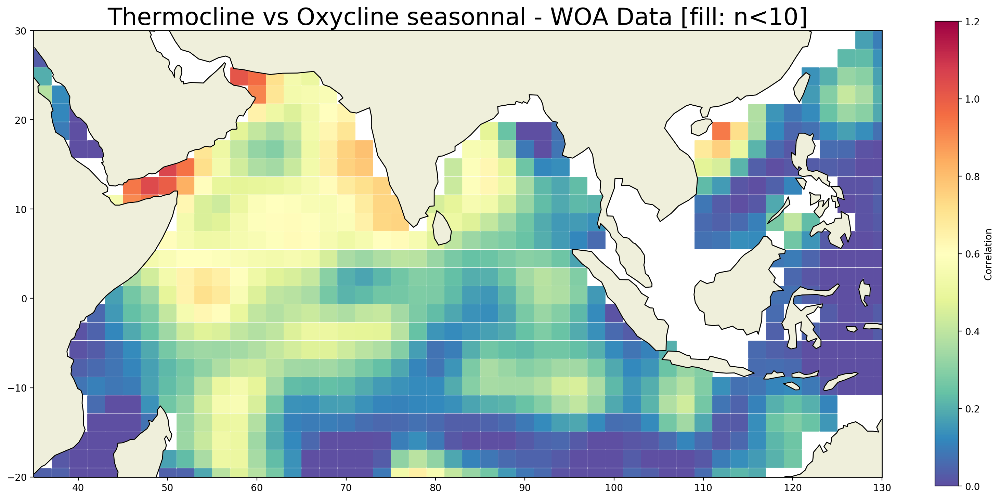

In [78]:
n=2
s=320
nbr=11
space=n/2

corr,reg,index,lat,lon,_,_=grid_correlation(WOA_oxyc, WOA_therm, WOA_LONGITUDE, 
                                                WOA_LATITUDE,
                                                reg_slope=True,n=n)
corr=smooth(corr)

fig=plt.figure(figsize=(20,10),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20, 30], crs=ccrs.PlateCarree())
ax.set_title('Thermocline vs Oxycline seasonnal - WOA Data [fill: n<10]',fontsize=25)
ax.set_extent((35,130,-20,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon,lat,marker='s',c=corr,s=s,vmin=0,vmax=1.2,cmap=plt.cm.Spectral_r)
plt.colorbar(c,shrink=0.9,label='Correlation')

for i in range(np.shape(lon)[0]):
    for j in range(np.shape(lon)[1]):
        if index[i,j]<nbr and index[i,j]>0:
            lon_tmp=lon[i,j]
            lat_tmp=lat[i,j]
            ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                    [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                    fill=False, hatch='\\ ',c='grey',linewidth=0.0001)

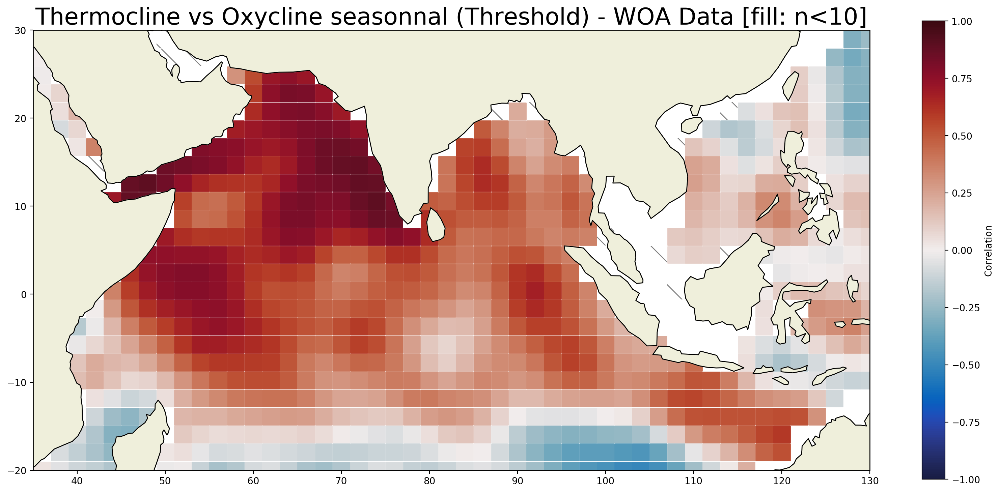

In [79]:
n=2
s=320
nbr=11
space=n/2

corr,reg,index,lat,lon,_,_=grid_correlation(WOA_OCD, WOA_TCD, WOA_LONGITUDE, 
                                                WOA_LATITUDE, 
                                                reg_slope=False,n=n)
corr=smooth(corr)

fig=plt.figure(figsize=(20,10),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20, 30], crs=ccrs.PlateCarree())
ax.set_title('Thermocline vs Oxycline seasonnal (Threshold) - WOA Data [fill: n<10]',fontsize=25)
ax.set_extent((35,130,-20,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon,lat,marker='s',c=corr,s=s,vmin=-1,vmax=1,cmap=cmocean.cm.balance)
plt.colorbar(c,shrink=0.9,label='Correlation')

for i in range(np.shape(lon)[0]):
    for j in range(np.shape(lon)[1]):
        if index[i,j]<nbr and index[i,j]>0:
            lon_tmp=lon[i,j]
            lat_tmp=lat[i,j]
            ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                    [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                    fill=False, hatch='\\ ',c='grey',linewidth=0.0001)

### 4)c)ii). DMI vs Oxycline/Thermocline

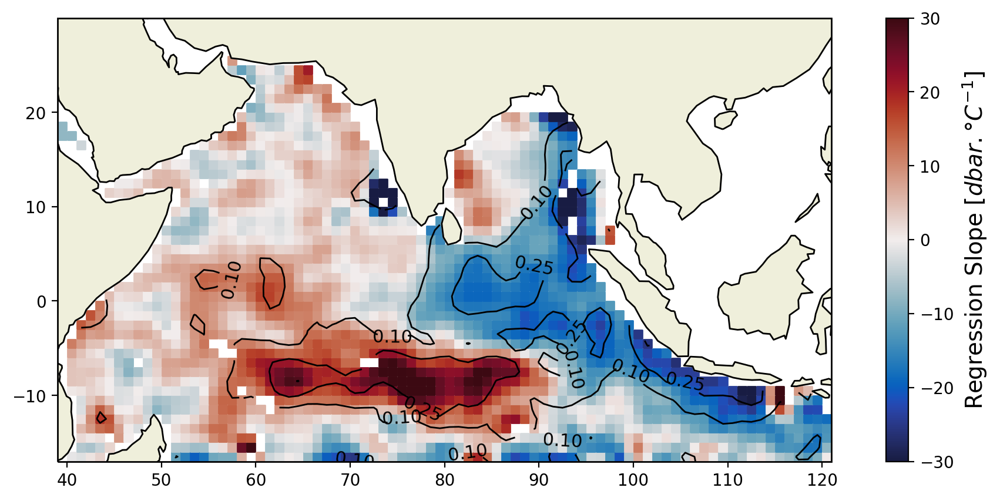

In [80]:
n=1
sr=1
s=26
space=n/2
nbr=10

corr,reg,index,lat,lon,_,_=grid_correlation_lag(conc_DMI_int, conc_therm_an, conc_LON,conc_LAT,conc_Month,reg_slope=True,n=n)

corr=smooth(corr)
reg=smooth(reg)

fig=plt.figure(figsize=(15,5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-10, 0, 10, 20], crs=ccrs.PlateCarree())
#ax.set_title('Thermocline depth anomaly vs DMI - contour: r² - [fill: n <10]',fontsize=11)
ax.set_extent((39,121,-17,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon,lat,marker='s',c=corr,s=s,vmin=-30,vmax=30,cmap=cmocean.cm.balance)
cb=fig.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Regression Slope [$dbar.°C^{-1}$]',size=fsize)

contours = ax.contour(lon,lat,reg,levels=[0.1,0.25,0.5],
                      linewidths=1,colors='black')
plt.clabel(contours, inline=True, fontsize=11 ,fmt='%1.2f')



# for i in range(np.shape(lon)[0]):
#     for j in range(np.shape(lon)[1]):
#         if index[i,j]<nbr and index[i,j]>0:
#             lon_tmp=lon[i,j]
#             lat_tmp=lat[i,j]
#             ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
#                     [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
#                     fill=False, hatch='\\\ ',c='grey',linewidth=0.0001)

plt.savefig("regressionThDMI.png")

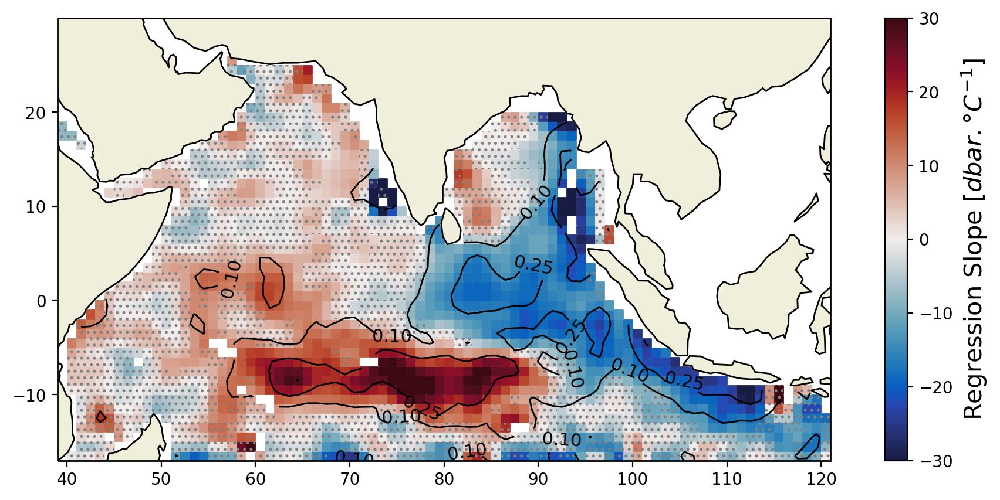

In [173]:
n=1
sr=1
s=26
space=n/2
nbr=10

corr,reg,index,lat,lon,_,_,error=grid_correlation_lag_error(conc_DMI_int, conc_therm_an, conc_LON,conc_LAT,conc_Month,reg_slope=True,n=n)

corr=smooth(corr)
reg=smooth(reg)

fig=plt.figure(figsize=(15,5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-10, 0, 10, 20], crs=ccrs.PlateCarree())
#ax.set_title('Thermocline depth anomaly vs DMI - contour: r² - [fill: n <10]',fontsize=11)
ax.set_extent((39,121,-17,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon,lat,marker='s',c=corr,s=s,vmin=-30,vmax=30,cmap=cmocean.cm.balance)
cb=fig.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Regression Slope [$dbar.°C^{-1}$]',size=fsize)

contours = ax.contour(lon,lat,reg,levels=[0.1,0.25,0.5],
                      linewidths=1,colors='black')
plt.clabel(contours, inline=True, fontsize=11 ,fmt='%1.2f')



for i in range(np.shape(lon)[0]):
    for j in range(np.shape(lon)[1]):
        if np.abs(error[i,j])>np.abs(corr[i,j]):
            lon_tmp=lon[i,j]
            lat_tmp=lat[i,j]
            ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                    [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                    fill=False, hatch='...',c='grey',linewidth=0.0001)

plt.savefig("regressionThDMI.png")

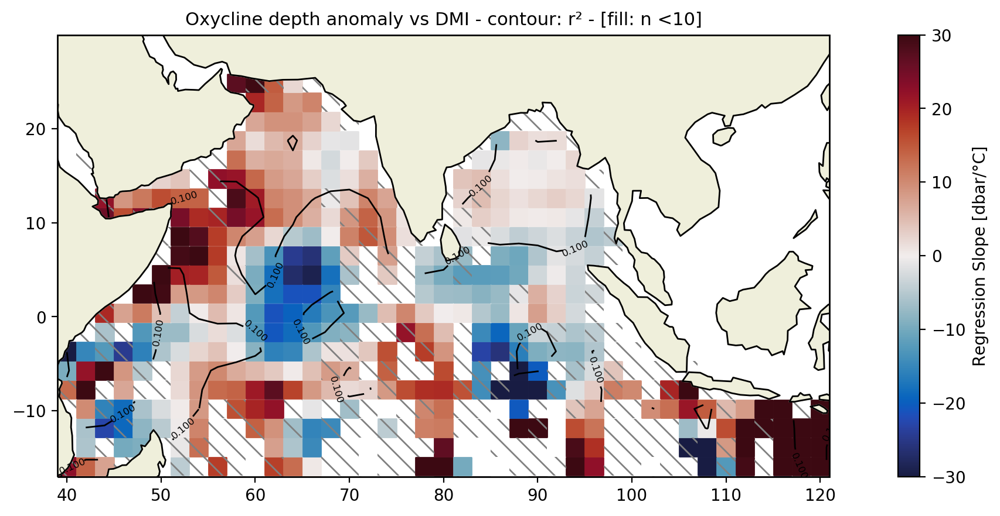

In [81]:
n=2
sr=1
s=120
space=n/2
nbr=10

corr,reg,index,lat,lon,_,_=grid_correlation_lag(conc_DMI_int_ox, conc_oxyc_an, conc_LON_ox,conc_LAT_ox,conc_Month_ox,reg_slope=True,n=n)

corr=smooth(corr)
reg=smooth(reg)

fig=plt.figure(figsize=(15,5),dpi=200)

ax=fig.add_subplot(111,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-10, 0, 10, 20], crs=ccrs.PlateCarree())
ax.set_title('Oxycline depth anomaly vs DMI - contour: r² - [fill: n <10]',fontsize=11)
ax.set_extent((39,121,-17,30),crs=ccrs.PlateCarree())

c=ax.scatter(lon,lat,marker='s',c=corr,s=s,vmin=-30,vmax=30,cmap=cmocean.cm.balance)
plt.colorbar(c,shrink=sr,label='Regression Slope [dbar/°C]')

contours = ax.contour(lon,lat,reg,levels=[0.1,0.5],
                      linewidths=1,colors='black')
plt.clabel(contours, inline=True, fontsize=6)



for i in range(np.shape(lon)[0]):
    for j in range(np.shape(lon)[1]):
        if index[i,j]<nbr and index[i,j]>0:
            lon_tmp=lon[i,j]
            lat_tmp=lat[i,j]
            ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                    [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                    fill=False, hatch='\\\ ',c='grey',linewidth=0.0001)

## 4)d) Time series

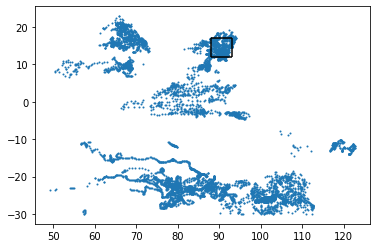

In [82]:
lon_min,lon_max=66,70
lat_min,lat_max=15,20

lon_min,lon_max=88,93
lat_min,lat_max=12,17


plt.hlines(lat_min,lon_min,lon_max),plt.hlines(lat_max,lon_min,lon_max)
plt.vlines(lon_min,lat_min,lat_max),plt.vlines(lon_max,lat_min,lat_max)
plt.scatter(Bio_LONGITUDE,Bio_LATITUDE,s=1)

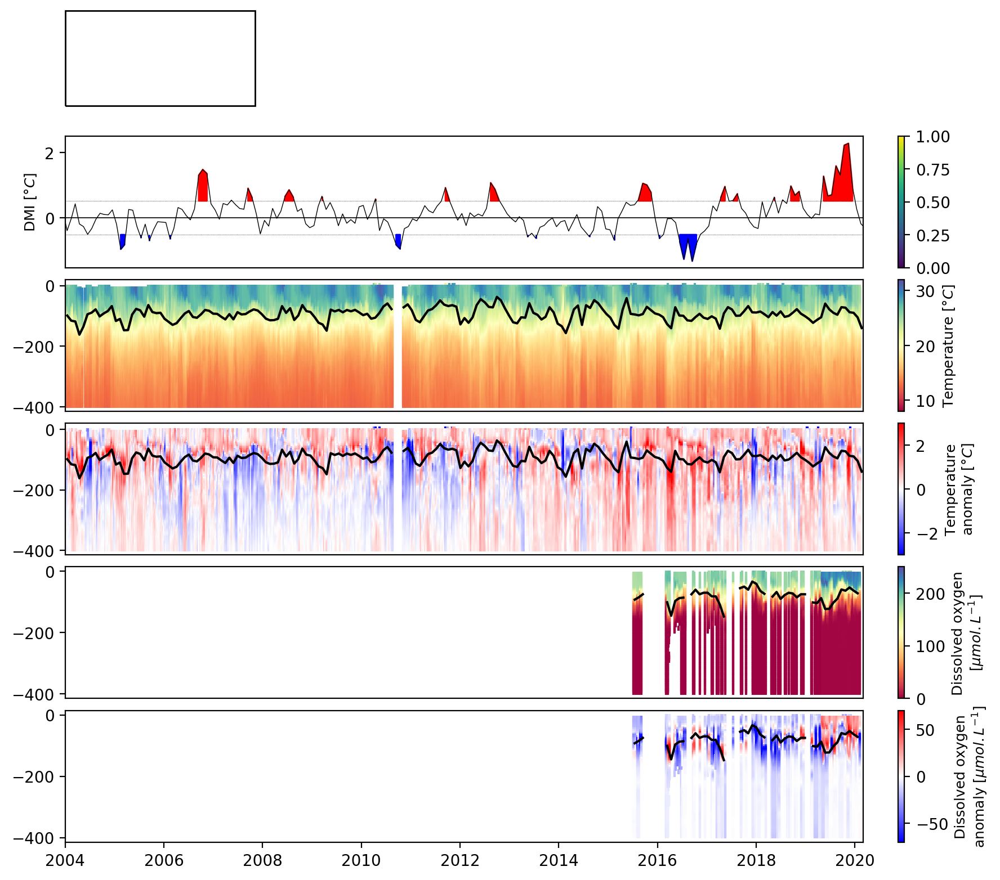

In [106]:
### Param ###
s=10
fsize=9

# BB
# lon_min,lon_max=88,93
# lat_min,lat_max=12,17

# AS
lon_min,lon_max=66,70
lat_min,lat_max=15,20

year_up   = 2004 #1960
year_down = 2020

mask_pres=PRES_i<400

#
th1=np.std(DMI_long_val)
th2=np.std(DMI_value)

lon_mask=np.logical_and(conc_LON>lon_min,conc_LON<lon_max)
lat_mask=np.logical_and(conc_LAT>lat_min,conc_LAT<lat_max)
mask_core=np.logical_and(lon_mask,lat_mask)

lon_mask_ox=np.logical_and(conc_LON_ox>lon_min,conc_LON_ox<lon_max)
lat_mask_ox=np.logical_and(conc_LAT_ox>lat_min,conc_LAT_ox<lat_max)
mask_doxy=np.logical_and(lon_mask_ox,lat_mask_ox)

fig=plt.figure(figsize=(10,10),dpi=200)
gs = GridSpec(12, 4, figure=fig)

# Axe 1: DMI
ax = fig.add_subplot(gs[2:4,:])

tmp_time,tmp_val=[],[]
for year in range(1981,2021):
    for month in range(1,13):
        mask=np.logical_and(DMI_TIME>dt.date(year,month,1),DMI_TIME<dt.date(year,month,28))
        tmp_time.append(dt.date(year,month,15)),tmp_val.append(np.nanmean(DMI_value[mask]))
tmp_time,tmp_val=np.array(tmp_time),np.array(tmp_val)

ax.plot(tmp_time,tmp_val,c='k',linewidth=0.5)

seuil=np.nanstd(tmp_val)
ax.fill_between(tmp_time,tmp_val,seuil,where=tmp_val>seuil,color='r')
ax.fill_between(tmp_time,tmp_val,-seuil,where=tmp_val<-seuil,color='b')

plt.hlines(0,tmp_time[0],tmp_time[-1],linewidth=0.6)
plt.hlines((-seuil,seuil),tmp_time[0],tmp_time[-1],linestyles='dotted',linewidth=0.3)

# threshold=np.nanstd(DMI_value)
# ax.plot(DMI_TIME,DMI_value,c='k',linewidth=0.5)
# ax.fill_between(DMI_TIME,DMI_value,0.6,where=DMI_value>0.6,color='r')
# ax.fill_between(DMI_TIME,DMI_value,-0.6,where=DMI_value<-0.6,color='b')
# ax.hlines(0,DMI_long_date[0],DMI_TIME[-1],linewidth=0.6)
# ax.hlines((-0.6,0.6),DMI_long_date[0],DMI_TIME[-1],linestyles='dotted',linewidth=0.3)

# ax.plot(DMI_long_date,DMI_long_val*th2/th1,c='k',linewidth=0.5)
# ax.fill_between(DMI_long_date,DMI_long_val*th2/th1,0.6,where=DMI_long_val*th2/th1>0.6,color='r')
# ax.fill_between(DMI_long_date,DMI_long_val*th2/th1,-0.6,where=DMI_long_val*th2/th1<-0.6,color='b')

ax.set_ylabel(r'DMI [$°C$]',fontsize=fsize)
ax.set_xlim(dt.datetime(year_up,1,1),dt.datetime(year_down,3,1))
c=ax.scatter([dt.date(year_up,1,1)],[0],s=0.0001,c='k')
plt.colorbar(c,fraction=0.046, pad=0.04)
ax.set_xticks([]),ax.set_xticks([], minor=True)

# Axe 1 bis:
ax = fig.add_subplot(gs[0:2,0],projection=ccrs.PlateCarree())
# ax.set_extent([50,110,-15,25],crs=ccrs.PlateCarree())
# ax.add_feature(cfeature.COASTLINE)
# ax.set_xticks([40, 50, 60, 70, 80, 90, 100], crs=ccrs.PlateCarree())
# ax.set_yticks([-10,0, 10, 20], crs=ccrs.PlateCarree())  
# ax.scatter(conc_LON[mask_core],conc_LAT[mask_core],s=1)
# ax.hlines(lat_min,lon_min,lon_max),ax.hlines(lat_max,lon_min,lon_max)
# ax.vlines(lon_min,lat_min,lat_max),ax.vlines(lon_max,lat_min,lat_max)

# Axe 2: Temperature
ax = fig.add_subplot(gs[4:6,:])
col=True
vmin,vmax=8,32

tmp_temp,tmp_pres,tmp_time=[],[],[]
for temp,time in zip(conc_TEMP[mask_core],conc_TIME[mask_core]):
    if np.nanmin(temp[mask_pres])>0:
        tmp_temp.append(temp[mask_pres])
    else:
        tmp_temp.append([np.nan for i in range(len(temp[mask_pres]))])
    tmp_time.append([time for i in range(len(PRES_i[mask_pres]))])
    tmp_pres.append(PRES_i[mask_pres])

tmp_time,tmp_temp,tmp_pres=np.array(tmp_time),np.array(tmp_temp),np.array(tmp_pres)
c=ax.scatter(tmp_time,-tmp_pres,c=tmp_temp,s=s,marker="|",cmap=plt.cm.Spectral,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r"Temperature [$°C$]",size=fsize)
        
mask2=np.logical_and(np.isfinite(conc_therm),mask_core)
x,y=time_line(conc_TIME[mask2],-conc_therm[mask2],year_up,30)
ax.plot(x,y,c='k')
ax.set_xlim(dt.datetime(year_up,1,1),dt.datetime(year_down,3,1))
ax.set_xticks([]),ax.set_xticks([], minor=True)

# Axe 3: Temperature anomalie
ax = fig.add_subplot(gs[6:8,:])
col=True
vmin,vmax=-3,3

tmp_temp,tmp_pres,tmp_time=[],[],[]
for temp,time in zip(conc_TEMP_an[mask_core],conc_TIME[mask_core]):
    tmp_temp.append(temp[mask_pres])
    tmp_time.append([time for i in range(len(PRES_i[mask_pres]))])
    tmp_pres.append(PRES_i[mask_pres])

tmp_time,tmp_temp,tmp_pres=np.array(tmp_time),np.array(tmp_temp),np.array(tmp_pres)
c=ax.scatter(tmp_time,-tmp_pres,c=tmp_temp,s=s,marker="|",cmap=plt.cm.bwr,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label("Temperature"+"\n"+r"anomaly [$°C$]",size=fsize)
        
mask2=np.logical_and(np.isfinite(conc_therm),mask_core)
x,y=time_line(conc_TIME[mask2],-conc_therm[mask2],year_up,30)
ax.plot(x,y,c='k')
ax.set_xlim(dt.datetime(year_up,1,1),dt.datetime(year_down,3,1))
ax.set_xticks([]),ax.set_xticks([], minor=True)

# Axe 4: Oxygen
ax = fig.add_subplot(gs[8:10,:])
col=True
vmin,vmax=0,250

tmp_temp,tmp_pres,tmp_time=[],[],[]
for temp,time in zip(conc_DOXY[mask_doxy],conc_TIME_ox[mask_doxy]):
    tmp_temp.append(temp[mask_pres])
    tmp_time.append([time for i in range(len(PRES_i[mask_pres]))])
    tmp_pres.append(PRES_i[mask_pres])

tmp_time,tmp_temp,tmp_pres=np.array(tmp_time),np.array(tmp_temp),np.array(tmp_pres)
mask=tmp_temp>0
c=ax.scatter(tmp_time[mask],-tmp_pres[mask],c=tmp_temp[mask],s=s,marker="|",cmap=plt.cm.Spectral,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label("Dissolved oxygen"+"\n"+r"[$\mu mol.L^{-1}$]",size=fsize)

mask2=np.logical_and(np.isfinite(conc_oxyc),mask_doxy)
mask3=np.logical_and(mask2,conc_oxyc<200)
x,y=time_line(conc_TIME_ox[mask3],-conc_oxyc[mask3],year_up,30)
ax.plot(x,y,c='k')
ax.set_xlim(dt.datetime(year_up,1,1),dt.datetime(year_down,3,1))
ax.set_xticks([]),ax.set_xticks([], minor=True)

# Axe 5: Oxygen anomalie
ax = fig.add_subplot(gs[10:12,:])
col=True
vmin,vmax=-70,70

tmp_temp,tmp_pres,tmp_time=[],[],[]
for temp,time in zip(conc_DOXY_an[mask_doxy],conc_TIME_ox[mask_doxy]):
    tmp_temp.append(temp[mask_pres])
    tmp_time.append([time for i in range(len(PRES_i[mask_pres]))])
    tmp_pres.append(PRES_i[mask_pres])

tmp_time,tmp_temp,tmp_pres=np.array(tmp_time),np.array(tmp_temp),np.array(tmp_pres)
c=ax.scatter(tmp_time[mask],-tmp_pres[mask],c=tmp_temp[mask],s=s,marker="|",cmap=plt.cm.bwr,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label("Dissolved oxygen"+"\n"+r"anomaly [$\mu mol.L^{-1}$]",size=fsize)


mask2=np.logical_and(np.isfinite(conc_oxyc),mask_doxy)
mask3=np.logical_and(mask2,conc_oxyc<200)
x,y=time_line(conc_TIME_ox[mask3],-conc_oxyc[mask3],year_up,30)
ax.plot(x,y,c='k')
ax.set_xlim(dt.datetime(year_up,1,1),dt.datetime(year_down,3,1))

#plt.tight_layout()
plt.savefig("profiles_series.png")
plt.show()

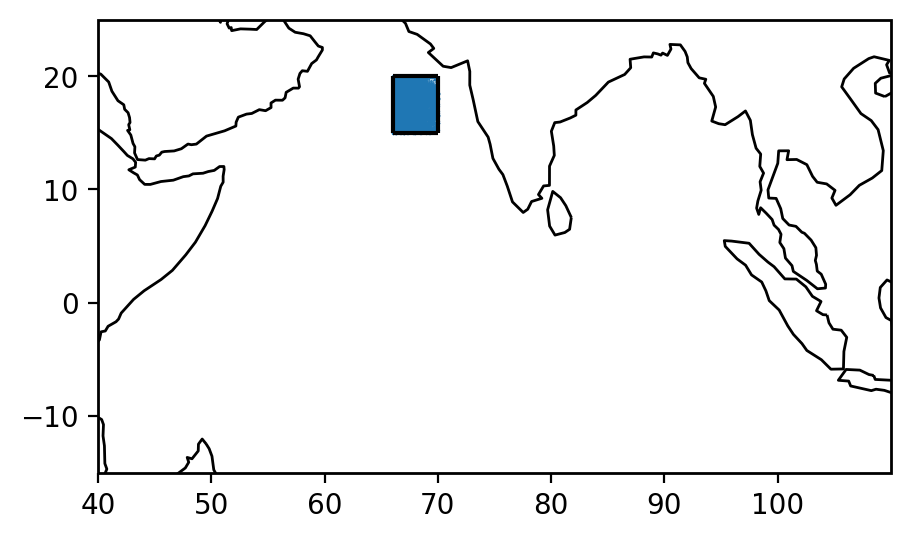

In [121]:
fig=plt.figure(figsize=(6,3),dpi=200)
ax = fig.add_subplot(111,projection=ccrs.PlateCarree())
ax.set_extent([50,110,-15,25],crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100], crs=ccrs.PlateCarree())
ax.set_yticks([-10,0, 10, 20], crs=ccrs.PlateCarree())  
ax.scatter(conc_LON[mask_core],conc_LAT[mask_core],s=0.05)
ax.hlines(lat_min,lon_min,lon_max),ax.hlines(lat_max,lon_min,lon_max)
ax.vlines(lon_min,lat_min,lat_max),ax.vlines(lon_max,lat_min,lat_max)

plt.savefig("map.png")

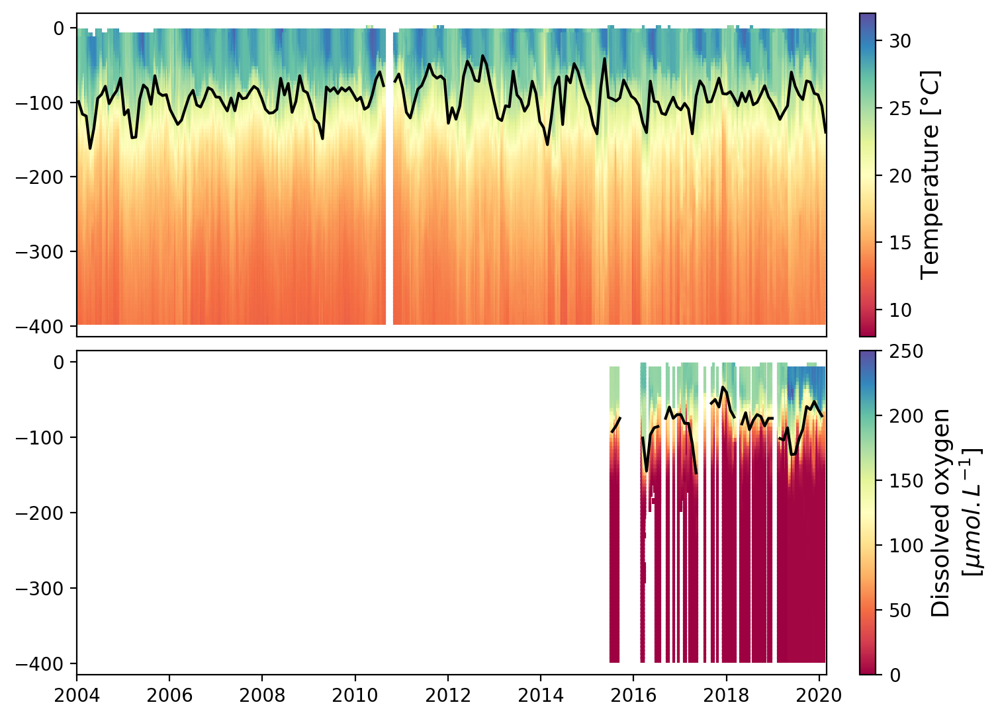

In [122]:
### Param ###
s=10
fsize=13

# BB
# lon_min,lon_max=88,93
# lat_min,lat_max=12,17

# AS
lon_min,lon_max=66,70
lat_min,lat_max=15,20

year_up   = 2004 #1960
year_down = 2020

mask_pres=PRES_i<400

#
th1=np.std(DMI_long_val)
th2=np.std(DMI_value)

lon_mask=np.logical_and(conc_LON>lon_min,conc_LON<lon_max)
lat_mask=np.logical_and(conc_LAT>lat_min,conc_LAT<lat_max)
mask_core=np.logical_and(lon_mask,lat_mask)

lon_mask_ox=np.logical_and(conc_LON_ox>lon_min,conc_LON_ox<lon_max)
lat_mask_ox=np.logical_and(conc_LAT_ox>lat_min,conc_LAT_ox<lat_max)
mask_doxy=np.logical_and(lon_mask_ox,lat_mask_ox)

fig=plt.figure(figsize=(8,10),dpi=200)
gs = GridSpec(12, 4, figure=fig)



# Axe 1 bis:
# ax = fig.add_subplot(gs[0:4,0],projection=ccrs.PlateCarree())
# ax.set_extent([50,110,-15,25],crs=ccrs.PlateCarree())
# ax.add_feature(cfeature.COASTLINE)
# ax.set_xticks([40, 50, 60, 70, 80, 90, 100], crs=ccrs.PlateCarree())
# ax.set_yticks([-10,0, 10, 20], crs=ccrs.PlateCarree())  
# ax.scatter(conc_LON[mask_core],conc_LAT[mask_core],s=1)
# ax.hlines(lat_min,lon_min,lon_max),ax.hlines(lat_max,lon_min,lon_max)
# ax.vlines(lon_min,lat_min,lat_max),ax.vlines(lon_max,lat_min,lat_max)

# Axe 2: Temperature
ax = fig.add_subplot(gs[4:8,:])
col=True
vmin,vmax=8,32

tmp_temp,tmp_pres,tmp_time=[],[],[]
for temp,time in zip(conc_TEMP[mask_core],conc_TIME[mask_core]):
    if np.nanmin(temp[mask_pres])>0:
        tmp_temp.append(temp[mask_pres])
    else:
        tmp_temp.append([np.nan for i in range(len(temp[mask_pres]))])
    tmp_time.append([time for i in range(len(PRES_i[mask_pres]))])
    tmp_pres.append(PRES_i[mask_pres])

tmp_time,tmp_temp,tmp_pres=np.array(tmp_time),np.array(tmp_temp),np.array(tmp_pres)
c=ax.scatter(tmp_time,-tmp_pres,c=tmp_temp,s=s,marker="|",cmap=plt.cm.Spectral,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r"Temperature [$°C$]",size=fsize)
        
mask2=np.logical_and(np.isfinite(conc_therm),mask_core)
x,y=time_line(conc_TIME[mask2],-conc_therm[mask2],year_up,30)
ax.plot(x,y,c='k')
ax.set_xlim(dt.datetime(year_up,1,1),dt.datetime(year_down,3,1))
ax.set_xticks([]),ax.set_xticks([], minor=True)


# Axe 4: Oxygen
ax = fig.add_subplot(gs[8:12,:])
col=True
vmin,vmax=0,250

tmp_temp,tmp_pres,tmp_time=[],[],[]
for temp,time in zip(conc_DOXY[mask_doxy],conc_TIME_ox[mask_doxy]):
    tmp_temp.append(temp[mask_pres])
    tmp_time.append([time for i in range(len(PRES_i[mask_pres]))])
    tmp_pres.append(PRES_i[mask_pres])

tmp_time,tmp_temp,tmp_pres=np.array(tmp_time),np.array(tmp_temp),np.array(tmp_pres)
mask=tmp_temp>0
c=ax.scatter(tmp_time[mask],-tmp_pres[mask],c=tmp_temp[mask],s=s,marker="|",cmap=plt.cm.Spectral,vmin=vmin,vmax=vmax)
cb=plt.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label("Dissolved oxygen"+"\n"+r"[$\mu mol.L^{-1}$]",size=fsize)

mask2=np.logical_and(np.isfinite(conc_oxyc),mask_doxy)
mask3=np.logical_and(mask2,conc_oxyc<200)
x,y=time_line(conc_TIME_ox[mask3],-conc_oxyc[mask3],year_up,30)
ax.plot(x,y,c='k')
ax.set_xlim(dt.datetime(year_up,1,1),dt.datetime(year_down,3,1))



#plt.tight_layout()
plt.savefig("profiles_series.png")
plt.show()

## 4)e) Profils

-1

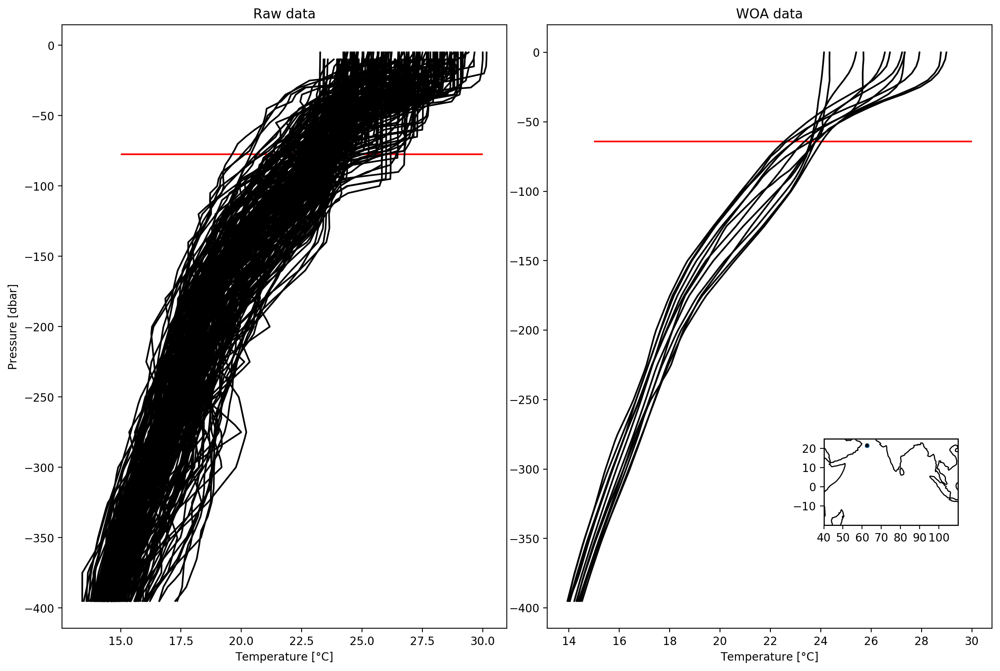

In [85]:
lon_min,lon_max=62,63
lat_min,lat_max=21,22

mask_pres=PRES_i<400


lon_mask=np.logical_and(conc_LON>lon_min,conc_LON<lon_max)
lat_mask=np.logical_and(conc_LAT>lat_min,conc_LAT<lat_max)
mask_core=np.logical_and(lon_mask,lat_mask)

lon_mask_WOA=np.logical_and(WOA_LONGITUDE>lon_min,WOA_LONGITUDE<lon_max)
lat_mask_WOA=np.logical_and(WOA_LATITUDE>lat_min,WOA_LATITUDE<lat_max)
mask_woa=np.logical_and(lon_mask_WOA,lat_mask_WOA)

###
fig=plt.figure(figsize=(15,10),dpi=200)
gs = GridSpec(6, 4, figure=fig)

# Axe core:
ax = fig.add_subplot(gs[:,0:2])
ax.set_title("Raw data")
ax.set_ylabel("Pressure [dbar]")
ax.set_xlabel("Temperature [°C]")

for temp in conc_TEMP[mask_core]:
    #if np.nanmin(temp[mask_pres])<12:
    #if np.nanmin(temp)>1:
    if np.nanmin(temp[mask_pres])<20:
        ax.plot(temp[mask_pres],-PRES_i[mask_pres],c='k')
        
ax.hlines(-np.nanmean(conc_therm[mask_core]),15,30,color='r')

# Axe WOA:
ax = fig.add_subplot(gs[:,2:4])
ax.set_title("WOA data")
ax.set_xlabel("Temperature [°C]")

for temp in WOA_TEMP[mask_woa]:
    ax.plot(temp[mask_pres],-PRES_i[mask_pres],c='k')
    
ax.hlines(-np.nanmean(WOA_therm[mask_woa]),15,30,color='r')

# Axe MAP:
ax = fig.add_subplot(gs[4:5,3:4],projection=ccrs.PlateCarree())

ax.set_extent([50,110,-20,25],crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100], crs=ccrs.PlateCarree())
ax.set_yticks([-10,0, 10, 20], crs=ccrs.PlateCarree())  
ax.scatter(conc_LON[mask_core],conc_LAT[mask_core],s=1)
ax.hlines(lat_min,lon_min,lon_max),ax.hlines(lat_max,lon_min,lon_max)
ax.vlines(lon_min,lat_min,lat_max),ax.vlines(lon_max,lat_min,lat_max)
-1

## 4)f) Composites

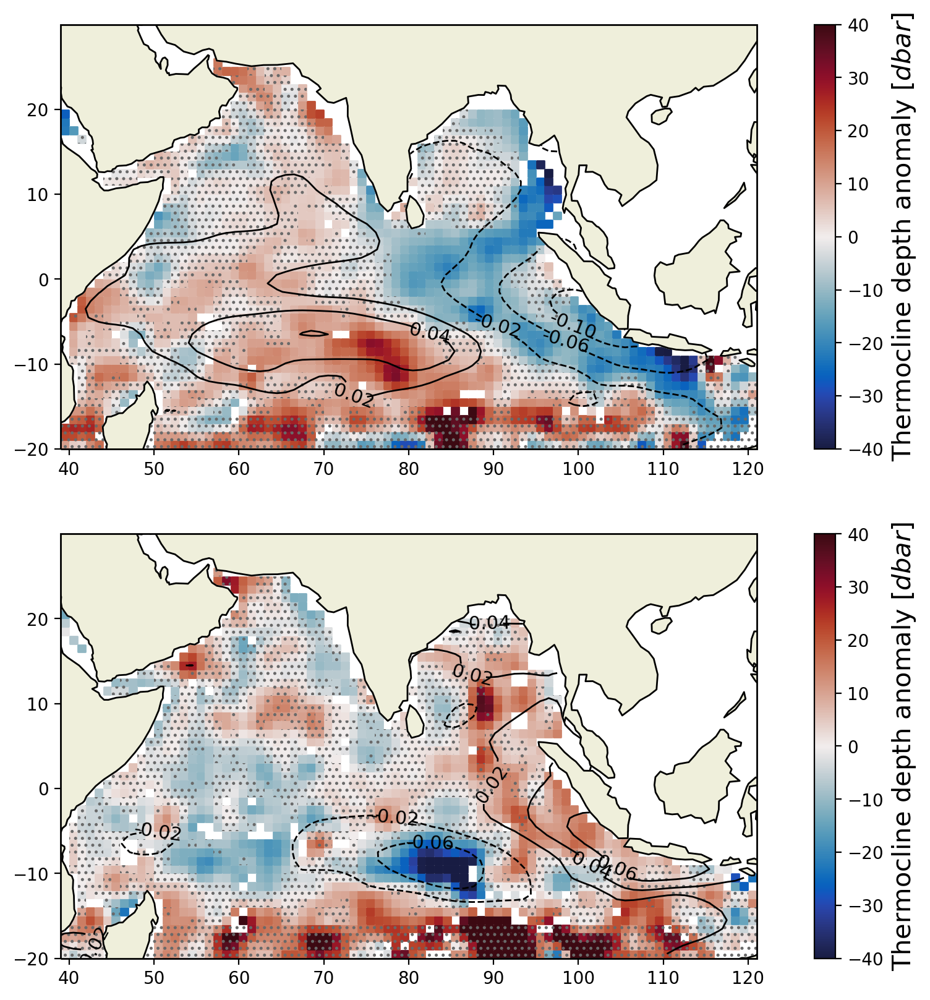

In [171]:
n=1
s=18
sr=1
space=n/2
m_e=0.3
nbr=0
fsizecont=11
fsize=15
col='dimgrey'

lon,lat=LonLon_SSH,LatLat_SSH
sel1=np.logical_or(lon<98.797,lat<8.984)
sel2=np.logical_or(lon<100.07,lat<6.731)
sel3=np.logical_or(lon<101.628,lat<-2.695)
sel4=np.logical_or(lon<105.639,lat<-6.747)
sel5=np.logical_or(lon<112.978,lat<-8.421)
sel6=np.logical_and(sel1,sel2)
sel7=np.logical_and(sel3,sel4)
sel8=np.logical_and(sel5,sel6)
sel9=np.logical_and(sel7,sel8)
SSH_iodan_pos_mask=np.ma.array(SSH_iodan_pos, mask=~sel9)
SSH_iodan_neg_mask=np.ma.array(SSH_iodan_neg, mask=~sel9)


borne=-np.nanmin(SSH_iodan_pos)

mask_time_pos=conc_DMI_int>0.5
mask_time_neg=conc_DMI_int<-0.3

fig=plt.figure(figsize=(15,10),dpi=200)

ax=fig.add_subplot(211,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20], crs=ccrs.PlateCarree())
#ax.set_title('IOD positive - Thermocline',fontsize=12)
ax.set_extent((39,121,-20,30),crs=ccrs.PlateCarree())

moyenne,ecarttype,index,lat_range,lon_range=grid(conc_therm_an[mask_time_pos],conc_LON[mask_time_pos],conc_LAT[mask_time_pos],n=n)
moyenne = smooth(moyenne)

c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne,s=s,vmin=-40,vmax=40,cmap=cmocean.cm.balance)
cb=fig.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Thermocline depth anomaly [$dbar$]',size=fsize)

contours = ax.contour(LonLon_SSH,LatLat_SSH,SSH_iodan_pos_mask,levels=[-0.1,-0.06,-0.02,0.02,0.04,0.06,0.1],linewidths=1,vmin=-borne,vmax=borne,
                      colors='black')
plt.clabel(contours, inline=True, fontsize=fsizecont ,fmt='%1.2f')

for i in range(np.shape(lon_range)[0]):
    for j in range(np.shape(lon_range)[1]):
        if np.abs(moyenne[i,j]/ecarttype[i,j])<m_e or lat_range[i,j]<-16:
            lon=lon_range[i,j]
            lat=lat_range[i,j]
            #ax.fill([lon-space, lon+space, lon+space, lon-space], [lat-space, lat-space, lat+space, lat+space],fill=False, hatch='///',linewidth=0.0001, c=col)
            ax.fill([lon-space, lon+space, lon+space, lon-space ], [lat-space, lat-space, lat+space, lat+space], fill=False, hatch='...',linewidth=0.0001, c=col)

        if index[i,j]<nbr and index[i,j]>0:
            lon=lon_range[i,j]
            lat=lat_range[i,j]
            ax.fill([lon-space, lon+space, lon+space, lon-space],
                    [lat-space, lat-space, lat+space, lat+space],
                    fill=False, hatch='\\\ ',linewidth=0.0001)

ax=fig.add_subplot(212,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20], crs=ccrs.PlateCarree())
#ax.set_title('IOD negative - Thermocline',fontsize=12)
ax.set_extent((39,121,-20,30),crs=ccrs.PlateCarree())


moyenne,ecarttype,index,lat_range,lon_range=grid(conc_therm_an[mask_time_neg],conc_LON[mask_time_neg],conc_LAT[mask_time_neg],n=n)
moyenne = smooth(moyenne)

c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne,s=s,vmin=-40,vmax=40,cmap=cmocean.cm.balance)
cb=fig.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Thermocline depth anomaly [$dbar$]',size=fsize)

contours = ax.contour(LonLon_SSH,LatLat_SSH,SSH_iodan_neg_mask,levels=[-0.1,-0.06,-0.02,0.02,0.04,0.06,0.1],linewidths=1,vmin=-borne,vmax=borne,
                      colors='black')
plt.clabel(contours, inline=True, fontsize=fsizecont ,fmt='%1.2f')

for i in range(np.shape(lon_range)[0]):
    for j in range(np.shape(lon_range)[1]):
        if np.abs(moyenne[i,j]/ecarttype[i,j])<m_e or lat_range[i,j]<-16:
            lon=lon_range[i,j]
            lat=lat_range[i,j]
            #ax.fill([lon-space, lon+space, lon+space, lon-space], [lat-space, lat-space, lat+space, lat+space],  fill=False, hatch='///',linewidth=0.0001, c=col)
            ax.fill([lon-space, lon+space, lon+space, lon-space ], [lat-space, lat-space, lat+space, lat+space], fill=False, hatch='...',linewidth=0.0001, c=col)
        if index[i,j]<nbr and index[i,j]>0:
            lon=lon_range[i,j]
            lat=lat_range[i,j]
            ax.fill([lon-space, lon+space, lon+space, lon-space],
                    [lat-space, lat-space, lat+space, lat+space],
                    fill=False, hatch='\\\ ',linewidth=0.0001)
        
plt.savefig('composite IOD thermocline.png')

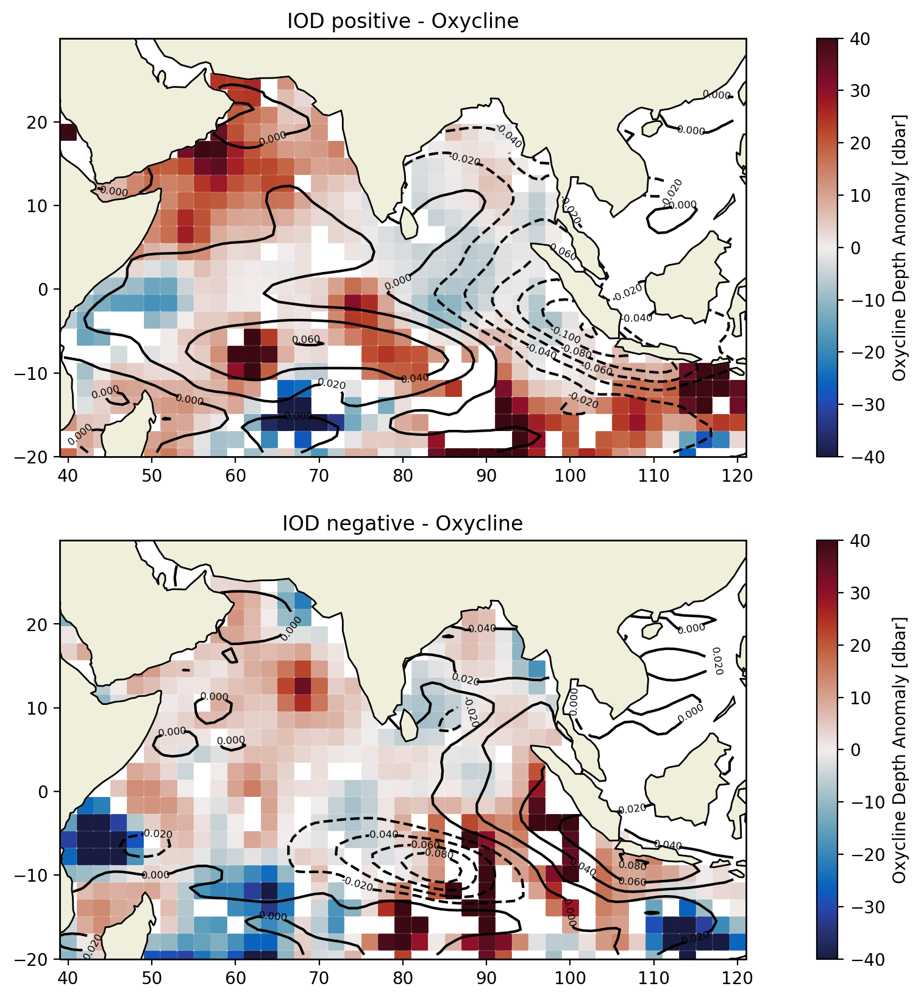

In [87]:
n=2
s=80
sr=1
space=n/2
m_e=0
nbr=0

borne=-np.nanmin(SSH_iodan_pos)

mask_time_pos=conc_DMI_int_ox>0.5
mask_time_neg=conc_DMI_int_ox<-0.3

fig=plt.figure(figsize=(15,10),dpi=200)

ax=fig.add_subplot(211,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20], crs=ccrs.PlateCarree())
ax.set_title('IOD positive - Oxycline',fontsize=12)
ax.set_extent((39,121,-20,30),crs=ccrs.PlateCarree())

moyenne,ecarttype,index,lat_range,lon_range=grid(conc_oxyc_an[mask_time_pos],conc_LON_ox[mask_time_pos],conc_LAT_ox[mask_time_pos],n=n)
moyenne = smooth(moyenne)

c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne,s=s,vmin=-40,vmax=40,cmap=cmocean.cm.balance)
plt.colorbar(c,shrink=sr,label='Oxycline Depth Anomaly [dbar]')

contours = ax.contour(LonLon_SSH,LatLat_SSH,SSH_iodan_pos,levels=9,linewidths=1.5,vmin=-borne,vmax=borne,
                      colors='black')
plt.clabel(contours, inline=True, fontsize=6)

for i in range(np.shape(lon_range)[0]):
    for j in range(np.shape(lon_range)[1]):
        if np.abs(moyenne[i,j]/ecarttype[i,j])<m_e:
            lon=lon_range[i,j]
            lat=lat_range[i,j]
            ax.fill([lon-space, lon+space, lon+space, lon-space],
                    [lat-space, lat-space, lat+space, lat+space],
                    fill=False, hatch='///',linewidth=0.0001)
        if index[i,j]<nbr and index[i,j]>0:
            lon=lon_range[i,j]
            lat=lat_range[i,j]
            ax.fill([lon-space, lon+space, lon+space, lon-space],
                    [lat-space, lat-space, lat+space, lat+space],
                    fill=False, hatch='\\\ ',linewidth=0.0001)

ax=fig.add_subplot(212,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20], crs=ccrs.PlateCarree())
ax.set_title('IOD negative - Oxycline',fontsize=12)
ax.set_extent((39,121,-20,30),crs=ccrs.PlateCarree())


moyenne,ecarttype,index,lat_range,lon_range=grid(conc_oxyc_an[mask_time_neg],conc_LON_ox[mask_time_neg],conc_LAT_ox[mask_time_neg],n=n)
moyenne = smooth(moyenne)

c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne,s=s,vmin=-40,vmax=40,cmap=cmocean.cm.balance)
plt.colorbar(c,shrink=sr,label='Oxycline Depth Anomaly [dbar]')

contours = ax.contour(LonLon_SSH,LatLat_SSH,SSH_iodan_neg,levels=9,linewidths=1.5,vmin=-borne,vmax=borne,
                      colors='black')
plt.clabel(contours, inline=True, fontsize=6)

for i in range(np.shape(lon_range)[0]):
    for j in range(np.shape(lon_range)[1]):
        if np.abs(moyenne[i,j]/ecarttype[i,j])<m_e:
            lon=lon_range[i,j]
            lat=lat_range[i,j]
            ax.fill([lon-space, lon+space, lon+space, lon-space],
                    [lat-space, lat-space, lat+space, lat+space],
                    fill=False, hatch='///',linewidth=0.0001)
        if index[i,j]<nbr and index[i,j]>0:
            lon=lon_range[i,j]
            lat=lat_range[i,j]
            ax.fill([lon-space, lon+space, lon+space, lon-space],
                    [lat-space, lat-space, lat+space, lat+space],
                    fill=False, hatch='\\\ ',linewidth=0.0001)

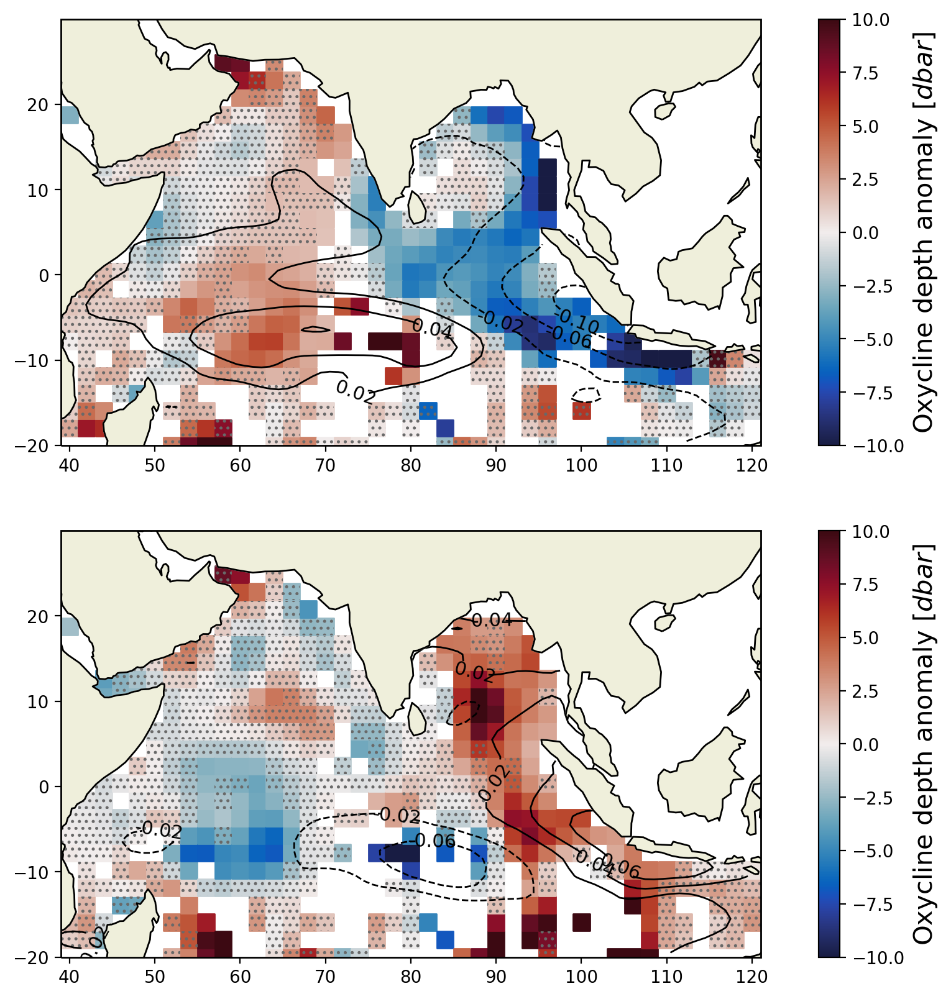

In [172]:
n=2
s=90
nbr=15
space=n/2
vlim=10
fsizecont=11
fsize=15

lon,lat=LonLon_SSH,LatLat_SSH
sel1=np.logical_or(lon<98.797,lat<8.984)
sel2=np.logical_or(lon<100.07,lat<6.731)
sel3=np.logical_or(lon<101.628,lat<-2.695)
sel4=np.logical_or(lon<105.639,lat<-6.747)
sel5=np.logical_or(lon<112.978,lat<-8.421)
sel6=np.logical_and(sel1,sel2)
sel7=np.logical_and(sel3,sel4)
sel8=np.logical_and(sel5,sel6)
sel9=np.logical_and(sel7,sel8)
SSH_iodan_pos_mask=np.ma.array(SSH_iodan_pos, mask=~sel9)
SSH_iodan_neg_mask=np.ma.array(SSH_iodan_neg, mask=~sel9)

corr,reg,index,lat,lon,_,_,error_corr=grid_correlation_and_incertitude(conc_oxyc_an, conc_therm_an_ox, conc_LON_ox,conc_LAT_ox, reg_slope=True,n=n)
corr=smooth(corr)

borne=-np.nanmin(SSH_iodan_pos)

mask_time_pos=conc_DMI_int>0.5
mask_time_neg=conc_DMI_int<-0.3

fig=plt.figure(figsize=(15,10),dpi=200)

ax=fig.add_subplot(211,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20], crs=ccrs.PlateCarree())
#ax.set_title('IOD positive - Oxycline - Proxy',fontsize=12)
ax.set_extent((39,121,-20,30),crs=ccrs.PlateCarree())

moyenne,ecarttype,index,lat_range,lon_range=grid(conc_therm_an[mask_time_pos],conc_LON[mask_time_pos],conc_LAT[mask_time_pos],n=n)
moyenne = smooth(moyenne)

c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne*corr,s=s,vmin=-vlim,vmax=vlim,cmap=cmocean.cm.balance)
cb=fig.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Oxycline depth anomaly [$dbar$]',size=fsize)

contours = ax.contour(LonLon_SSH,LatLat_SSH,SSH_iodan_pos_mask,levels=[-0.1,-0.06,-0.02,0.02,0.04,0.06,0.1],linewidths=1,vmin=-borne,vmax=borne,
                      colors='black')
plt.clabel(contours, inline=True, fontsize=fsizecont ,fmt='%1.2f')

for i in range(np.shape(lon_range)[0]):
    for j in range(np.shape(lon_range)[1]):
        if np.abs(np.sqrt(ecarttype[i,j]**2+error_corr[i,j]**2)/(moyenne[i,j]*corr[i,j]))>10:
            lon=lon_range[i,j]
            lat=lat_range[i,j]
            ax.fill([lon-space, lon+space, lon+space, lon-space ], [lat-space, lat-space, lat+space, lat+space], fill=False, hatch='...',linewidth=0.0001, c=col)


ax=fig.add_subplot(212,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=3)
ax.add_feature(cfeature.LAND,zorder=2)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20], crs=ccrs.PlateCarree())
#ax.set_title('IOD negative - Oxycline - Proxy',fontsize=12)
ax.set_extent((39,121,-20,30),crs=ccrs.PlateCarree())


moyenne,ecarttype,index,lat_range,lon_range=grid(conc_therm_an[mask_time_neg],conc_LON[mask_time_neg],conc_LAT[mask_time_neg],n=n)
moyenne = smooth(moyenne)

c=ax.scatter(lon_range,lat_range,marker='s',c=moyenne*corr,s=s,vmin=-vlim,vmax=vlim,cmap=cmocean.cm.balance)
cb=fig.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Oxycline depth anomaly [$dbar$]',size=fsize)

contours = ax.contour(LonLon_SSH,LatLat_SSH,SSH_iodan_neg_mask,levels=[-0.1,-0.06,-0.02,0.02,0.04,0.06,0.1],linewidths=1,vmin=-borne,vmax=borne,
                      colors='black')
plt.clabel(contours, inline=True, fontsize=fsizecont ,fmt='%1.2f')

for i in range(np.shape(lon_range)[0]):
    for j in range(np.shape(lon_range)[1]):
        if np.abs(np.sqrt(ecarttype[i,j]**2+error_corr[i,j]**2)/(moyenne[i,j]*corr[i,j]))>10:
            lon=lon_range[i,j]
            lat=lat_range[i,j]
            ax.fill([lon-space, lon+space, lon+space, lon-space ], [lat-space, lat-space, lat+space, lat+space], fill=False, hatch='...',linewidth=0.0001, c=col)


plt.savefig('composite IOD oxycline.png')

# 5) Oxygen

-1

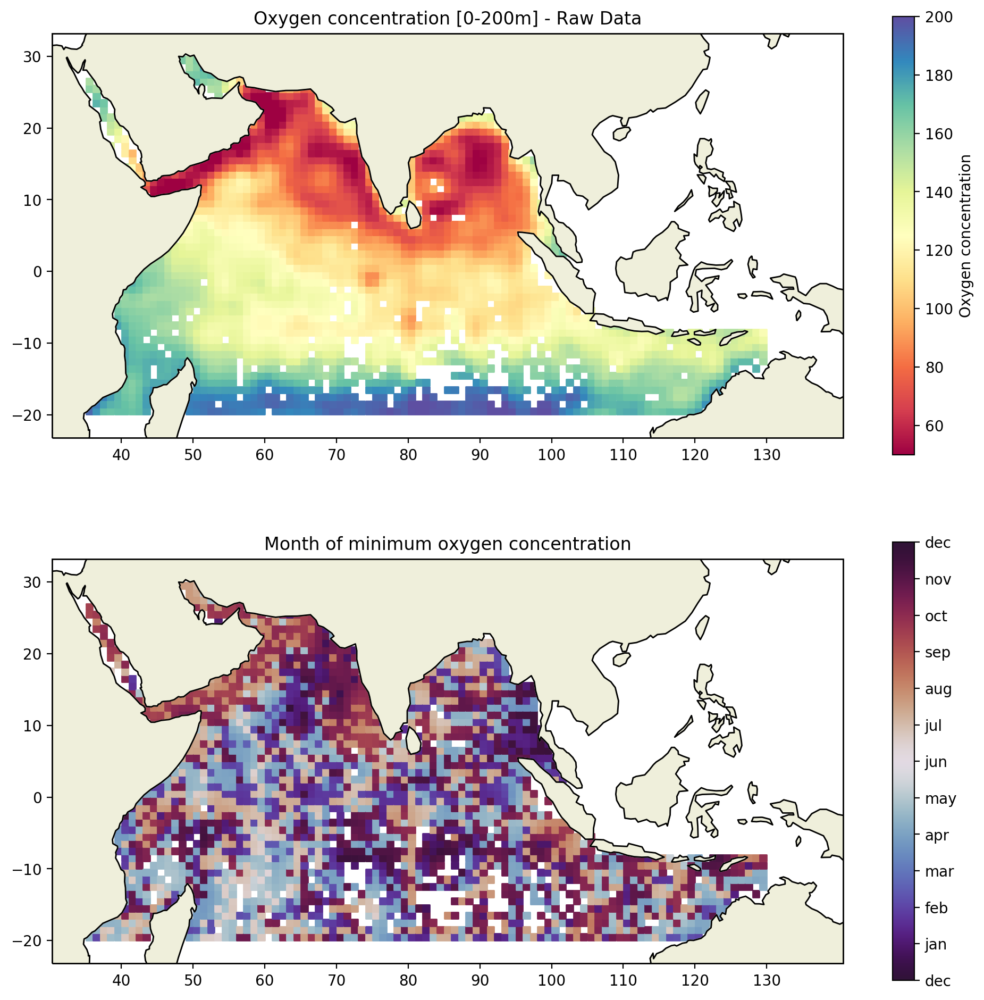

In [89]:
tmp=np.nanmean(conc_DOXY[:,PRES_i<200],axis=1)

n=1
s=20 #8
vmin=50
vmax=200

grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(tmp,conc_LON_ox,conc_LAT_ox,conc_Month_ox,n=n)
minimum=np.nanmin(grid_value,axis=2)

minimum_month=np.full(np.shape(minimum),np.nan)
minimum_season=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini
            seas=int((mini-1)/3)+0.5
            minimum_season[i,j]=seas

minimum=smooth(minimum)
minimum_month_cos=smooth_cos(minimum_month)
minimum_month_sin=smooth_sin(minimum_month)
minimum_month=estimation_mois(minimum_month,minimum_month_sin,minimum_month_cos)


fig=plt.figure(figsize=(12,12),dpi=200)

ax=fig.add_subplot(211,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum,marker='s',cmap=plt.cm.Spectral,s=s,vmin=vmin,vmax=vmax)
plt.colorbar(c,label='Oxygen concentration')

ax.set_title("Oxygen concentration [0-200m] - Raw Data")

ax=fig.add_subplot(212,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum_month,marker='s',
              vmin=0,vmax=12,cmap=plt.cm.twilight_shifted,s=s)
cbar=plt.colorbar(c)
cbar.set_ticks(np.linspace(0,12,13))
cbar.set_ticklabels(['dec','jan','feb','mar','apr','may','jun',
                    'jul','aug','sep','oct','nov','dec'])

ax.set_title("Month of minimum oxygen concentration")

# ax=fig.add_subplot(313,projection=ccrs.PlateCarree())
# ax.add_feature(cfeature.COASTLINE,zorder=2)
# ax.add_feature(cfeature.LAND,zorder=1)
# ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
# ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

# c=ax.scatter(lon_range,lat_range,c=minimum_season,marker='s',
#               vmin=0,vmax=4,cmap=plt.cm.twilight_shifted,s=s)
# cbar=plt.colorbar(c)
# cbar.set_ticks([0.5,1.5,2.5,3.5])
# cbar.set_ticklabels(['win','spr','sum','aut'])

# ax.set_title("Season of minimum Thermocline")
-1

In [90]:
def is_min_month_int(month,min_month):
    if month==min_month:
        return True
    elif month==min_month-1:
        return True
    elif month==min_month+1:
        return True
    elif month==1 and min_month==12:
        return True
    elif month==12 and min_month==1:
        return True
    else:
        return False

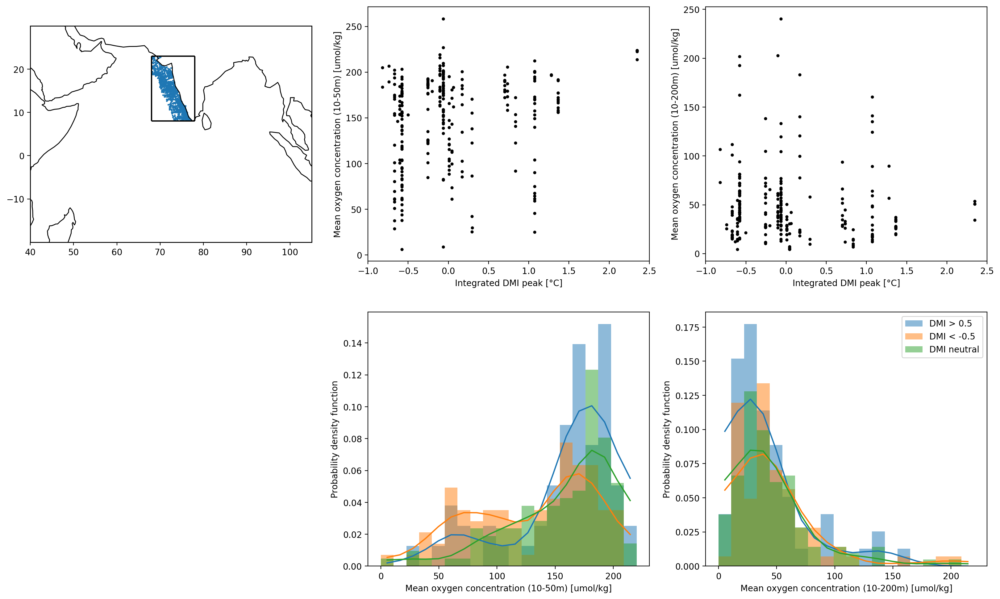

In [91]:
# name="WEST_INDIAN_COAST"
# lon_min,lon_max=72,78
# lat_min,lat_max=8,20

# name="NORTH_INDIAN_COAST"
# lon_min,lon_max=60,68
# lat_min,lat_max=17,25

# name="EAST_INDIAN_COAST"
# lon_min,lon_max=79,85
# lat_min,lat_max=10,16

# name="WEST_BB"
# lon_min,lon_max=90,101
# lat_min,lat_max=2,20

name="INDIAN_COAST"
lon_min,lon_max=68,78
lat_min,lat_max=8,23

n=1
grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_oxyc,conc_LON_ox,conc_LAT_ox,conc_Month_ox,n=n)
minimum=np.nanmin(grid_value,axis=2)

minimum_month=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini

lon_mask=np.logical_and(conc_LON_ox>lon_min,conc_LON_ox<lon_max)
lat_mask=np.logical_and(conc_LAT_ox>lat_min,conc_LAT_ox<lat_max)
mask=np.logical_and(lon_mask,lat_mask)

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lon_min,lon_max,lat_min,lat_max)

latitude  = conc_LAT_ox[mask]
longitude = conc_LON_ox[mask]
mois      = conc_Month_ox[mask]
dmi       = conc_DMI_int_ox[mask]
doxy      = conc_DOXY[mask]
year      = conc_Year_ox[mask]

fig=plt.figure(figsize=(20,12),dpi=200)
ax = fig.add_subplot(231,projection=ccrs.PlateCarree())
ax1=fig.add_subplot(232)
ax2=fig.add_subplot(233)

ax.set_extent([45,105,-20,30],crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100], crs=ccrs.PlateCarree())
ax.set_yticks([-10,0, 10, 20], crs=ccrs.PlateCarree())  
ax.scatter(longitude,latitude,s=1)
ax.hlines(lat_min,lon_min,lon_max),ax.hlines(lat_max,lon_min,lon_max)
ax.vlines(lon_min,lat_min,lat_max),ax.vlines(lon_max,lat_min,lat_max)

ax1.set_xlabel("Integrated DMI peak [°C]")
ax2.set_xlabel("Integrated DMI peak [°C]")

ax1.set_ylabel("Mean oxygen concentration (10-50m) [umol/kg]")
ax2.set_ylabel("Mean oxygen concentration (10-200m) [umol/kg]")

ax1.set_xlim(-1,2.5)
ax2.set_xlim(-1,2.5)

m10_50=np.logical_and(PRES_i<=50,PRES_i>=10)
m10_200=np.logical_and(PRES_i<=200,PRES_i>=50)

upper_pos,upper_neg=[],[]
lower_pos,lower_neg=[],[]
upper_mid,lower_mid=[],[]

nbr_dot=0
for n in range(len(latitude)):
    lat=latitude[n]
    lon=longitude[n]
    lat_rank=closest_x(lat,lat_range[0])
    lon_rank=closest_x(lon,lon_range[:,0])

    minmon_tmp=minimum_month[lon_rank,lat_rank]
    if is_min_month_int(mois[n],minmon_tmp):
        nbr_dot+=1
        ax1.scatter(dmi[n],np.nanmean(doxy[n,m10_50]),s=7,c='k')
        ax2.scatter(dmi[n],np.nanmean(doxy[n,m10_200]),s=7,c='k')
        
        if dmi[n]>0.5:
            upper_pos.append(np.nanmean(doxy[n,m10_50]))
            lower_pos.append(np.nanmean(doxy[n,m10_200]))
        elif dmi[n]<-0.5:
            upper_neg.append(np.nanmean(doxy[n,m10_50]))
            lower_neg.append(np.nanmean(doxy[n,m10_200]))
            
        elif dmi[n]>-0.3 and dmi[n]<0.3:
            upper_mid.append(np.nanmean(doxy[n,m10_50]))
            lower_mid.append(np.nanmean(doxy[n,m10_200]))

upper_pos,upper_neg,upper_mid=np.array(upper_pos),np.array(upper_neg),np.array(upper_mid)
lower_pos,lower_neg,lower_mid=np.array(lower_pos),np.array(lower_neg),np.array(lower_mid)
 
nbr_bar=20
sig=1.5
nbr_dot=[len(upper_pos),len(upper_mid),len(upper_neg)]
# Ax3: PDF UPPER OCEAN
ax3=fig.add_subplot(235)

hist_pos=np.histogram(upper_pos, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[0]
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax3.bar(bins,val,width=bins[0]*2,alpha=0.5,label='DMI > 0.5')

ax3.plot(bins,gaussian_filter(val,sigma=sig))

hist_pos=np.histogram(upper_neg, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[2]
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax3.bar(bins,val,width=bins[0]*2,alpha=0.5,label='DMI < -0.5')

ax3.plot(bins,gaussian_filter(val,sigma=sig))

hist_pos=np.histogram(upper_mid, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[1]
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax3.bar(bins,val,width=bins[0]*2,alpha=0.5,label='DMI neutral')

ax3.plot(bins,gaussian_filter(val,sigma=sig))


ax3.set_xlabel("Mean oxygen concentration (10-50m) [umol/kg]")
ax3.set_ylabel("Probability density function")
#ax3.set_ylabel("Number of Profiles")

# Ax4: PDF LOWER OCEAN
ax4=fig.add_subplot(236)

hist_pos=np.histogram(lower_pos, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[0]
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax4.bar(bins,val,width=bins[0]*2,alpha=0.5,label='DMI > 0.5')

ax4.plot(bins,gaussian_filter(val,sigma=sig))

hist_pos=np.histogram(lower_neg, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[2]
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax4.bar(bins,val,width=bins[0]*2,alpha=0.5,label='DMI < -0.5')

ax4.plot(bins,gaussian_filter(val,sigma=sig))

hist_pos=np.histogram(lower_mid, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[1]
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax4.bar(bins,val,width=bins[0]*2,alpha=0.5,label='DMI neutral')

ax4.plot(bins,gaussian_filter(val,sigma=sig))



ax4.set_xlabel("Mean oxygen concentration (10-200m) [umol/kg]")
ax4.set_ylabel("Probability density function")
#ax4.set_ylabel("Number of Profiles")

plt.legend()

plt.savefig(name+'.pdf')

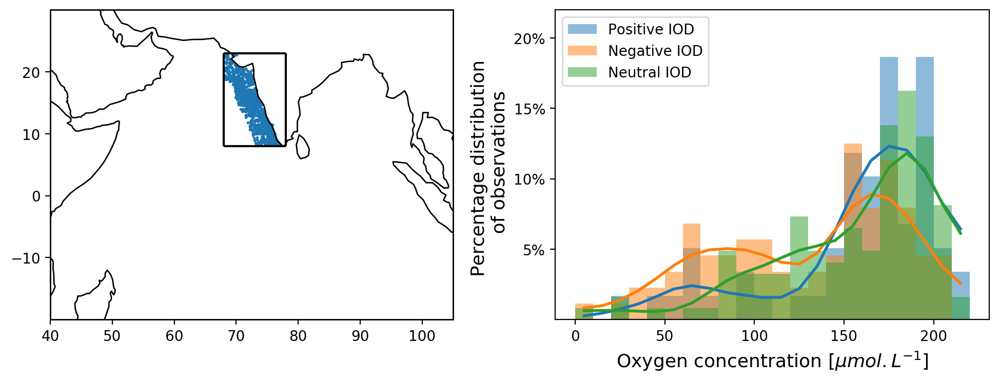

In [311]:
name="INDIAN_COAST"
lon_min,lon_max=68,78
lat_min,lat_max=8,23
fsize=13

n=1
grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_oxyc,conc_LON_ox,conc_LAT_ox,conc_Month_ox,n=n)
minimum=np.nanmin(grid_value,axis=2)

minimum_month=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini

lon_mask=np.logical_and(conc_LON_ox>lon_min,conc_LON_ox<lon_max)
lat_mask=np.logical_and(conc_LAT_ox>lat_min,conc_LAT_ox<lat_max)
mask=np.logical_and(lon_mask,lat_mask)

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lon_min,lon_max,lat_min,lat_max)

latitude  = conc_LAT_ox[mask]
longitude = conc_LON_ox[mask]
mois      = conc_Month_ox[mask]
dmi       = conc_DMI_int_ox[mask]
doxy      = conc_DOXY[mask]
year      = conc_Year_ox[mask]

fig=plt.figure(figsize=(12,4),dpi=200)
ax = fig.add_subplot(121,projection=ccrs.PlateCarree())

ax.set_extent([45,105,-20,30],crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100], crs=ccrs.PlateCarree())
ax.set_yticks([-10,0, 10, 20], crs=ccrs.PlateCarree())  
ax.scatter(longitude,latitude,s=1)
ax.hlines(lat_min,lon_min,lon_max),ax.hlines(lat_max,lon_min,lon_max)
ax.vlines(lon_min,lat_min,lat_max),ax.vlines(lon_max,lat_min,lat_max)


m10_50=np.logical_and(PRES_i<=50,PRES_i>=10)
m10_200=np.logical_and(PRES_i<=200,PRES_i>=50)

upper_pos,upper_neg=[],[]
lower_pos,lower_neg=[],[]
upper_mid,lower_mid=[],[]

nbr_dot=0
for n in range(len(latitude)):
    lat=latitude[n]
    lon=longitude[n]
    lat_rank=closest_x(lat,lat_range[0])
    lon_rank=closest_x(lon,lon_range[:,0])

    minmon_tmp=minimum_month[lon_rank,lat_rank]
    if is_min_month_int(mois[n],minmon_tmp):
        nbr_dot+=1
        
        if dmi[n]>0.5:
            upper_pos.append(np.nanmean(doxy[n,m10_50]))
            lower_pos.append(np.nanmean(doxy[n,m10_200]))
        elif dmi[n]<-0.5:
            upper_neg.append(np.nanmean(doxy[n,m10_50]))
            lower_neg.append(np.nanmean(doxy[n,m10_200]))
            
        elif dmi[n]>-0.3 and dmi[n]<0.3:
            upper_mid.append(np.nanmean(doxy[n,m10_50]))
            lower_mid.append(np.nanmean(doxy[n,m10_200]))

upper_pos,upper_neg,upper_mid=np.array(upper_pos),np.array(upper_neg),np.array(upper_mid)
lower_pos,lower_neg,lower_mid=np.array(lower_pos),np.array(lower_neg),np.array(lower_mid)
 
nbr_bar=22
sig=1.5
nbr_dot=[len(upper_pos),len(upper_mid),len(upper_neg)]

# Ax3: PDF UPPER OCEAN
ax3=fig.add_subplot(122)

hist_pos=np.histogram(upper_pos, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[0]
val=val/np.sum(val)
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax3.bar(bins,val,width=bins[0]*2,alpha=0.5,label='Positive IOD')#: DMI > 0.5')

ax3.plot(bins,gaussian_filter(val,sigma=sig),linewidth=2)

hist_pos=np.histogram(upper_neg, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[2]
val=val/np.sum(val)
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax3.bar(bins,val,width=bins[0]*2,alpha=0.5,label='Negative IOD')#: DMI < -0.5')

ax3.plot(bins,gaussian_filter(val,sigma=sig),linewidth=2)

hist_pos=np.histogram(upper_mid, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[1]
val=val/np.sum(val)
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax3.bar(bins,val,width=bins[0]*2,alpha=0.5,label='Neutral IOD')#: -0.3 < DMI < 0.3')

ax3.plot(bins,gaussian_filter(val,sigma=sig),linewidth=2)


ax3.set_xlabel(r"Oxygen concentration [$\mu mol.L^{-1}$]",fontsize=fsize)
ax3.set_ylabel("Percentage distribution \n of observations",fontsize=fsize)

ax3.set_yticks([0.05,0.1,0.15,0.2])
ax3.set_ylim(0,0.22)
ax3.yaxis.set_major_formatter(mtick.PercentFormatter(1.0,decimals=0))


plt.legend()

#plt.savefig(name+'.pdf')
plt.savefig(name+'.png')

In [316]:
n=1 # pos 15 / mid 13 / neg  31
# 5 , 10
thres_d=0
thres_u=60

nbr_dot=[len(upper_pos),len(upper_mid),len(upper_neg)]
lower=[upper_pos,upper_mid,upper_neg]

hist_pos=np.histogram(lower[n], bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[n]
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
mask=np.logical_and(bins>thres_d,bins<thres_u)

np.sum(val[mask])*100/np.sum(val)

3.252032520325203

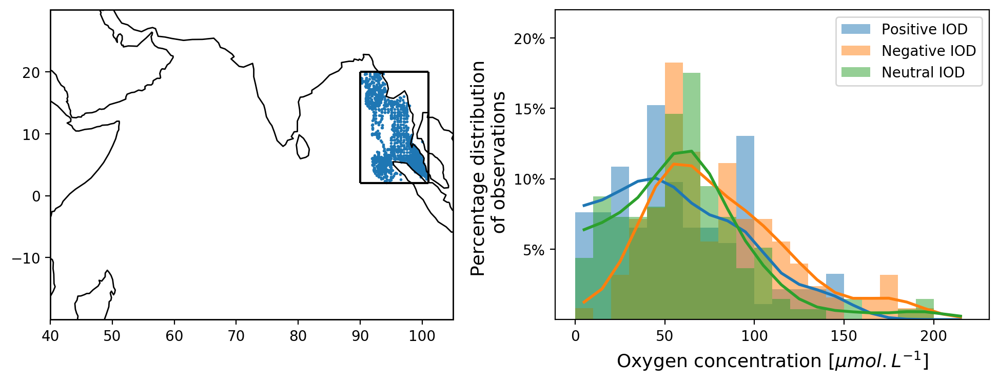

In [293]:
import matplotlib.ticker as mtick


name="WEST_BB"
lon_min,lon_max=90,101
lat_min,lat_max=2,20

n=1
grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_oxyc,conc_LON_ox,conc_LAT_ox,conc_Month_ox,n=n)
minimum=np.nanmin(grid_value,axis=2)

minimum_month=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini

lon_mask=np.logical_and(conc_LON_ox>lon_min,conc_LON_ox<lon_max)
lat_mask=np.logical_and(conc_LAT_ox>lat_min,conc_LAT_ox<lat_max)
mask=np.logical_and(lon_mask,lat_mask)

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lon_min,lon_max,lat_min,lat_max)

latitude  = conc_LAT_ox[mask]
longitude = conc_LON_ox[mask]
mois      = conc_Month_ox[mask]
dmi       = conc_DMI_int_ox[mask]
doxy      = conc_DOXY[mask]
year      = conc_Year_ox[mask]

fig=plt.figure(figsize=(12,4),dpi=200)
ax = fig.add_subplot(121,projection=ccrs.PlateCarree())

ax.set_extent([45,105,-20,30],crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100], crs=ccrs.PlateCarree())
ax.set_yticks([-10,0, 10, 20], crs=ccrs.PlateCarree())  
ax.scatter(longitude,latitude,s=1)
ax.hlines(lat_min,lon_min,lon_max),ax.hlines(lat_max,lon_min,lon_max)
ax.vlines(lon_min,lat_min,lat_max),ax.vlines(lon_max,lat_min,lat_max)


m10_50=np.logical_and(PRES_i<=50,PRES_i>=10)
m10_200=np.logical_and(PRES_i<=200,PRES_i>=50)

upper_pos,upper_neg=[],[]
lower_pos,lower_neg=[],[]
upper_mid,lower_mid=[],[]

nbr_dot=0
for n in range(len(latitude)):
    lat=latitude[n]
    lon=longitude[n]
    lat_rank=closest_x(lat,lat_range[0])
    lon_rank=closest_x(lon,lon_range[:,0])

    minmon_tmp=minimum_month[lon_rank,lat_rank]
    if is_min_month_int(mois[n],minmon_tmp):
        nbr_dot+=1
        
        if dmi[n]>0.5:
            upper_pos.append(np.nanmean(doxy[n,m10_50]))
            lower_pos.append(np.nanmean(doxy[n,m10_200]))
        elif dmi[n]<-0.5:
            upper_neg.append(np.nanmean(doxy[n,m10_50]))
            lower_neg.append(np.nanmean(doxy[n,m10_200]))
            
        elif dmi[n]>-0.3 and dmi[n]<0.3:
            upper_mid.append(np.nanmean(doxy[n,m10_50]))
            lower_mid.append(np.nanmean(doxy[n,m10_200]))

upper_pos,upper_neg,upper_mid=np.array(upper_pos),np.array(upper_neg),np.array(upper_mid)
lower_pos,lower_neg,lower_mid=np.array(lower_pos),np.array(lower_neg),np.array(lower_mid)
 
nbr_bar=22
sig=1.5
nbr_dot=[len(upper_pos),len(upper_mid),len(upper_neg)]

# Ax4: PDF LOWER OCEAN
ax4=fig.add_subplot(122)

hist_pos=np.histogram(lower_pos, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[0]
val=val/np.sum(val)
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax4.bar(bins,val,width=bins[0]*2,alpha=0.5,label='Positive IOD')#: DMI > 0.5')

ax4.plot(bins,gaussian_filter(val,sigma=sig),linewidth=2)

hist_pos=np.histogram(lower_neg, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[2]
val=val/np.sum(val)
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax4.bar(bins,val,width=bins[0]*2,alpha=0.5,label='Negative IOD')#: DMI < -0.5')

ax4.plot(bins,gaussian_filter(val,sigma=sig),linewidth=2)

hist_pos=np.histogram(lower_mid, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[1]
val=val/np.sum(val)
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax4.bar(bins,val,width=bins[0]*2,alpha=0.5,label='Neutral IOD')#: -0.3 < DMI < 0.3')

ax4.plot(bins,gaussian_filter(val,sigma=sig),linewidth=2)



ax4.set_xlabel(r"Oxygen concentration [$\mu mol.L^{-1}$]",fontsize=fsize)
ax4.set_ylabel("Percentage distribution \n of observations",fontsize=fsize)
#ax4.set_ylabel("Number of Profiles")


ax4.set_yticks([0.05,0.1,0.15,0.2])
ax4.set_ylim(0,0.22)
ax4.yaxis.set_major_formatter(mtick.PercentFormatter(1.0,decimals=0))

plt.legend()

#plt.savefig(name+'.pdf')
plt.savefig(name+'.png')

In [308]:
n=2
# pos 19  / mid 11 / neg 26 (>100)
# pos 23  / mid 15 / neg 34 (>90)
# pos 35 / mid 32 / neg 50 (>70)
# pos 47 / mid 35 / neg 19 (<50)
thres_d=70
thres_u=250

nbr_dot=[len(upper_pos),len(upper_mid),len(upper_neg)]
lower=[lower_pos,lower_mid,lower_neg]

hist_pos=np.histogram(lower[n], bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[n]
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
m=np.sum(val)

mask=np.logical_and(bins>thres_d,bins<thres_u)
np.sum(val[mask])*100/m

50.79365079365079

In [310]:
47-35

12

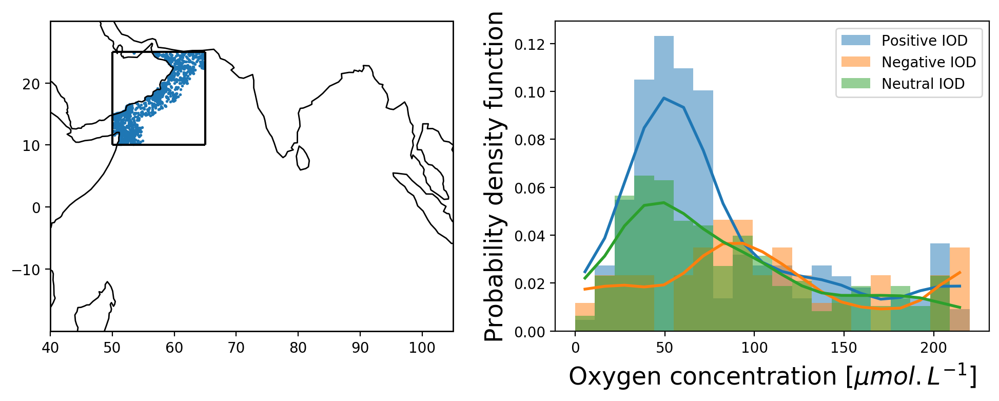

In [195]:
name="test"
lon_min,lon_max=50,65
lat_min,lat_max=10,25
n=1
grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_oxyc,conc_LON_ox,conc_LAT_ox,conc_Month_ox,n=n)
minimum=np.nanmin(grid_value,axis=2)

minimum_month=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini

lon_mask=np.logical_and(conc_LON_ox>lon_min,conc_LON_ox<lon_max)
lat_mask=np.logical_and(conc_LAT_ox>lat_min,conc_LAT_ox<lat_max)
mask=np.logical_and(lon_mask,lat_mask)

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lon_min,lon_max,lat_min,lat_max)

latitude  = conc_LAT_ox[mask]
longitude = conc_LON_ox[mask]
mois      = conc_Month_ox[mask]
dmi       = conc_DMI_int_ox[mask]
doxy      = conc_DOXY[mask]
year      = conc_Year_ox[mask]

fig=plt.figure(figsize=(12,4),dpi=200)
ax = fig.add_subplot(121,projection=ccrs.PlateCarree())

ax.set_extent([45,105,-20,30],crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100], crs=ccrs.PlateCarree())
ax.set_yticks([-10,0, 10, 20], crs=ccrs.PlateCarree())  
ax.scatter(longitude,latitude,s=1)
ax.hlines(lat_min,lon_min,lon_max),ax.hlines(lat_max,lon_min,lon_max)
ax.vlines(lon_min,lat_min,lat_max),ax.vlines(lon_max,lat_min,lat_max)


m10_50=np.logical_and(PRES_i<=50,PRES_i>=10)
m10_200=np.logical_and(PRES_i<=200,PRES_i>=0)

upper_pos,upper_neg=[],[]
lower_pos,lower_neg=[],[]
upper_mid,lower_mid=[],[]

nbr_dot=0
for n in range(len(latitude)):
    lat=latitude[n]
    lon=longitude[n]
    lat_rank=closest_x(lat,lat_range[0])
    lon_rank=closest_x(lon,lon_range[:,0])

    minmon_tmp=minimum_month[lon_rank,lat_rank]
    if is_min_month_int(mois[n],minmon_tmp):
        nbr_dot+=1
        
        if dmi[n]>0.5:
            upper_pos.append(np.nanmean(doxy[n,m10_50]))
            lower_pos.append(np.nanmean(doxy[n,m10_200]))
        elif dmi[n]<-0.5:
            upper_neg.append(np.nanmean(doxy[n,m10_50]))
            lower_neg.append(np.nanmean(doxy[n,m10_200]))
            
        elif dmi[n]>-0.3 and dmi[n]<0.3:
            upper_mid.append(np.nanmean(doxy[n,m10_50]))
            lower_mid.append(np.nanmean(doxy[n,m10_200]))

upper_pos,upper_neg,upper_mid=np.array(upper_pos),np.array(upper_neg),np.array(upper_mid)
lower_pos,lower_neg,lower_mid=np.array(lower_pos),np.array(lower_neg),np.array(lower_mid)
 
nbr_bar=20
sig=1.5
nbr_dot=[len(upper_pos),len(upper_mid),len(upper_neg)]

# Ax4: PDF LOWER OCEAN
ax4=fig.add_subplot(122)

hist_pos=np.histogram(lower_pos, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[0]
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax4.bar(bins,val,width=bins[0]*2,alpha=0.5,label='Positive IOD')#: DMI > 0.5')

ax4.plot(bins,gaussian_filter(val,sigma=sig),linewidth=2)

hist_pos=np.histogram(lower_neg, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[2]
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax4.bar(bins,val,width=bins[0]*2,alpha=0.5,label='Negative IOD')#: DMI < -0.5')

ax4.plot(bins,gaussian_filter(val,sigma=sig),linewidth=2)

hist_pos=np.histogram(lower_mid, bins=nbr_bar, range=(0,220))
val=hist_pos[0]/nbr_dot[1]
bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
ax4.bar(bins,val,width=bins[0]*2,alpha=0.5,label='Neutral IOD')#: -0.3 < DMI < 0.3')

ax4.plot(bins,gaussian_filter(val,sigma=sig),linewidth=2)



ax4.set_xlabel(r"Oxygen concentration [$\mu mol.L^{-1}$]",fontsize=fsize)
ax4.set_ylabel("Probability density function",fontsize=fsize)
#ax4.set_ylabel("Number of Profiles")

plt.legend()

#plt.savefig(name+'.pdf')

89


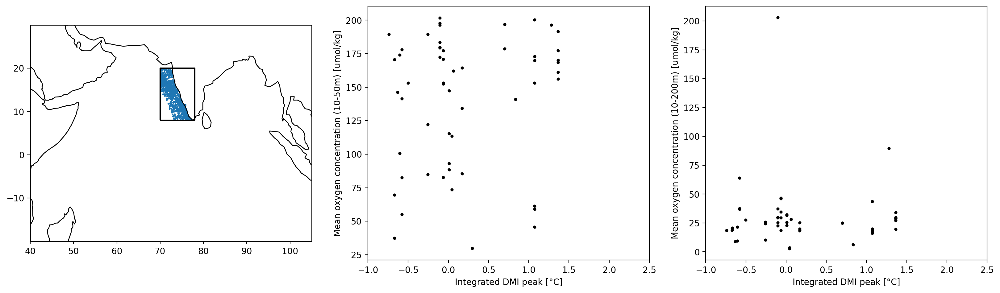

In [95]:
# WEST INDIAN COAST
lon_min,lon_max=70,78
lat_min,lat_max=8,20

# NORTH INDIAN COAST
# lon_min,lon_max=60,68
# lat_min,lat_max=17,25

# EAST INDIAN COAST
# lon_min,lon_max=79,85
# lat_min,lat_max=10,16

# WEST BB
# lon_min,lon_max=92,100
# lat_min,lat_max=7,20

n=1
grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_oxyc,conc_LON_ox,conc_LAT_ox,conc_Month_ox,n=n)
minimum=np.nanmin(grid_value,axis=2)

minimum_month=np.full(np.shape(minimum),np.nan)
minimum_season=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini
            seas=int((mini-1)/3)+0.5
            minimum_season[i,j]=seas

lon_mask=np.logical_and(conc_LON_ox>lon_min,conc_LON_ox<lon_max)
lat_mask=np.logical_and(conc_LAT_ox>lat_min,conc_LAT_ox<lat_max)
mask=np.logical_and(lon_mask,lat_mask)

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lon_min,lon_max,lat_min,lat_max)

latitude  = conc_LAT_ox[mask]
longitude = conc_LON_ox[mask]
mois      = conc_Month_ox[mask]
dmi       = conc_DMI_int_ox[mask]
doxy      = conc_DOXY[mask]
year      = conc_Year_ox[mask]

fig=plt.figure(figsize=(20,12),dpi=200)
ax = fig.add_subplot(231,projection=ccrs.PlateCarree())
ax1=fig.add_subplot(232)
ax2=fig.add_subplot(233)

ax.set_extent([45,105,-20,30],crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100], crs=ccrs.PlateCarree())
ax.set_yticks([-10,0, 10, 20], crs=ccrs.PlateCarree())  
ax.scatter(longitude,latitude,s=1)
ax.hlines(lat_min,lon_min,lon_max),ax.hlines(lat_max,lon_min,lon_max)
ax.vlines(lon_min,lat_min,lat_max),ax.vlines(lon_max,lat_min,lat_max)

ax1.set_xlabel("Integrated DMI peak [°C]")
ax2.set_xlabel("Integrated DMI peak [°C]")

ax1.set_ylabel("Mean oxygen concentration (10-50m) [umol/kg]")
ax2.set_ylabel("Mean oxygen concentration (10-200m) [umol/kg]")

ax1.set_xlim(-1,2.5)
ax2.set_xlim(-1,2.5)

m10_50=np.logical_and(PRES_i<=50,PRES_i>=10)
m10_200=np.logical_and(PRES_i<=300,PRES_i>=50)

upper_pos,upper_neg=[],[]
lower_pos,lower_neg=[],[]

nbr_dot=0
spatio_temp=[0,0,0]
mean_up=[]
mean_down=[]

for n in range(len(latitude)):
    lat,lon=latitude[n],longitude[n]
    lat_rank=closest_x(lat,lat_range[0])
    lon_rank=closest_x(lon,lon_range[:,0])
    
    minmon_tmp=minimum_month[lon_rank,lat_rank]
    if mois[n]==minmon_tmp:
        if spatio_temp[0]==year[n] and spatio_temp[1]==lon_rank and spatio_temp[2]==lat_rank:
            
            last_dmi=dmi[n]
            mean_up.append(np.nanmean(doxy[n,m10_50]))
            mean_down.append(np.nanmean(doxy[n,m10_200]))
                

        else:
            nbr_dot+=1
            spatio_temp=[year[n],lon_rank,lat_rank]
            
            ax1.scatter(dmi[n],np.nanmean(doxy[n,m10_50]),s=7,c='k')
            ax2.scatter(dmi[n],np.nanmean(doxy[n,m10_200]),s=7,c='k')


            if dmi[n]>0.5:
                upper_pos.append(np.nanmean(doxy[n,m10_50]))
                lower_pos.append(np.nanmean(doxy[n,m10_200]))
            elif dmi[n]<-0.5:
                upper_neg.append(np.nanmean(doxy[n,m10_50]))
                lower_neg.append(np.nanmean(doxy[n,m10_200]))
            
            mean_up   = []
            mean_down = []

print(nbr_dot)


            
# upper_pos,upper_neg=np.array(upper_pos),np.array(upper_neg)
# lower_pos,lower_neg=np.array(lower_pos),np.array(lower_neg)
 

    
    
# nbr_bar=20

# # Ax3: PDF UPPER OCEAN
# ax3=fig.add_subplot(235)

# hist_pos=np.histogram(upper_pos, bins=nbr_bar, range=(0,220))
# val=hist_pos[0]/nbr_dot
# bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
# ax3.bar(bins,val,width=bins[0]*2,alpha=0.5,label='DMI > 0.5')

# hist_pos=np.histogram(upper_neg, bins=nbr_bar, range=(0,220))
# val=hist_pos[0]/nbr_dot
# bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
# ax3.bar(bins,val,width=bins[0]*2,alpha=0.5,label='DMI < -0.5')

# # Ax4: PDF LOWER OCEAN
# ax4=fig.add_subplot(236)

# hist_pos=np.histogram(lower_pos, bins=nbr_bar, range=(0,220))
# val=hist_pos[0]/nbr_dot
# bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
# ax4.bar(bins,val,width=bins[0]*2,alpha=0.5,label='DMI > 0.5')

# hist_pos=np.histogram(lower_neg, bins=nbr_bar, range=(0,220))
# val=hist_pos[0]/nbr_dot
# bins=(np.array(hist_pos[1])[:-1]+np.array(hist_pos[1])[1:])/2
# ax4.bar(bins,val,width=bins[0]*2,alpha=0.5,label='DMI < -0.5')

# plt.legend()

In [96]:
spatio_temp[0]==year[n], spatio_temp[1]==lon_rank, spatio_temp[2]==lat_rank

(True, False, False)

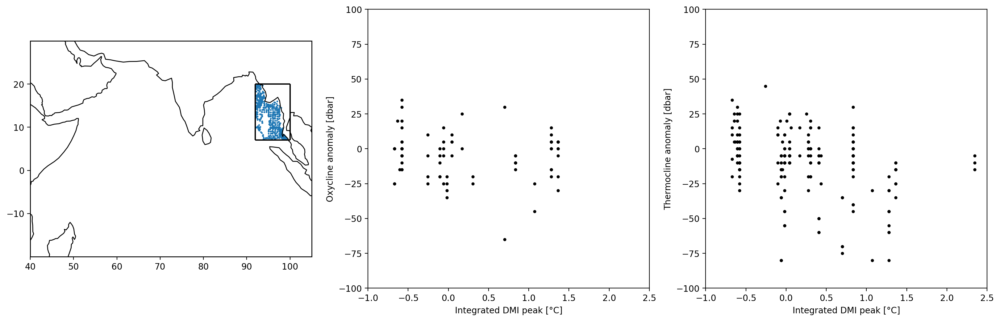

In [97]:
# WEST INDIAN COAST
# lon_min,lon_max=70,78
# lat_min,lat_max=8,20

# NORTH INDIAN COAST
# lon_min,lon_max=60,68
# lat_min,lat_max=17,25

# EAST INDIAN COAST
# lon_min,lon_max=79,85
# lat_min,lat_max=10,16

# WEST BB
lon_min,lon_max=92,100
lat_min,lat_max=7,20

n=1
grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_oxyc,conc_LON_ox,conc_LAT_ox,conc_Month_ox,n=n)
minimum=np.nanmin(grid_value,axis=2)

minimum_month=np.full(np.shape(minimum),np.nan)
minimum_season=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini

lon_mask=np.logical_and(conc_LON_ox>lon_min,conc_LON_ox<lon_max)
lat_mask=np.logical_and(conc_LAT_ox>lat_min,conc_LAT_ox<lat_max)
mask=np.logical_and(lon_mask,lat_mask)

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lon_min,lon_max,lat_min,lat_max)

latitude  = conc_LAT_ox[mask]
longitude = conc_LON_ox[mask]
mois      = conc_Month_ox[mask]
dmi       = conc_DMI_int_ox[mask]
doxy      = conc_oxyc_an[mask]

fig=plt.figure(figsize=(20,6),dpi=200)
ax = fig.add_subplot(131,projection=ccrs.PlateCarree())
ax1=fig.add_subplot(132)
ax2=fig.add_subplot(133)

ax.set_extent([45,105,-20,30],crs=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100], crs=ccrs.PlateCarree())
ax.set_yticks([-10,0, 10, 20], crs=ccrs.PlateCarree())  
ax.scatter(longitude,latitude,s=1)
ax.hlines(lat_min,lon_min,lon_max),ax.hlines(lat_max,lon_min,lon_max)
ax.vlines(lon_min,lat_min,lat_max),ax.vlines(lon_max,lat_min,lat_max)

ax1.set_xlabel("Integrated DMI peak [°C]")
ax2.set_xlabel("Integrated DMI peak [°C]")

ax1.set_ylabel("Oxycline anomaly [dbar]")
ax2.set_ylabel("Thermocline anomaly [dbar]")

ax1.set_ylim(-100,100)
ax2.set_ylim(-100,100)
ax1.set_xlim(-1,2.5)
ax2.set_xlim(-1,2.5)

for n in range(len(latitude)):
    lat,lon=latitude[n],longitude[n]
    lat_rank,lon_rank=closest_x(lat,lat_range[0]),closest_x(lon,lon_range[:,0])
    minmon_tmp=minimum_month[lon_rank,lat_rank]
    if mois[n]==minmon_tmp:
        ax1.scatter(dmi[n],doxy[n],s=7,c='k')
        
mask=mask_coast(conc_LON,conc_LAT,lon_min,lon_max,lat_min,lat_max)

latitude  = conc_LAT[mask]
longitude = conc_LON[mask]
mois      = conc_Month[mask]
dmi       = conc_DMI_int[mask]
therm     = conc_therm_an[mask]  

for n in range(len(latitude)):
    lat,lon=latitude[n],longitude[n]
    lat_rank,lon_rank=closest_x(lat,lat_range[0]),closest_x(lon,lon_range[:,0])
    minmon_tmp=minimum_month[lon_rank,lat_rank]
    if mois[n]==minmon_tmp:
        ax2.scatter(dmi[n],therm[n],s=7,c='k')

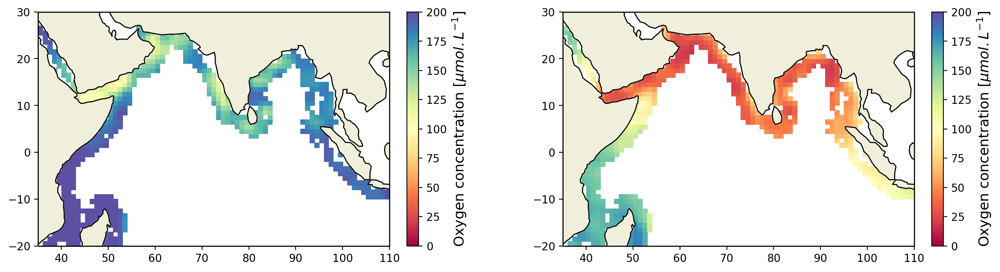

In [98]:
lon_min,lon_max=35,110
lat_min,lat_max=-30,30
s=15
vmin,vmax=0,200

n=1
grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_oxyc,conc_LON_ox,conc_LAT_ox,conc_Month_ox,n=n)
minimum=np.nanmin(grid_value,axis=2)

minimum_month=np.full(np.shape(minimum),np.nan)
minimum_season=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini
            
mask=mask_coast(conc_LON_ox,conc_LAT_ox,lon_min,lon_max,lat_min,lat_max)

latitude  = conc_LAT_ox[mask]
longitude = conc_LON_ox[mask]
mois      = conc_Month_ox[mask]
dmi       = conc_DMI_int_ox[mask]
doxy      = conc_DOXY[mask]

doxy_int_surf  = []
doxy_int_dept = []

m10_50=np.logical_and(PRES_i<=50,PRES_i>=10)
m10_200=np.logical_and(PRES_i<=300,PRES_i>=50)
                       
for n in range(len(latitude)):
    lat=latitude[n]
    lon=longitude[n]
    lat_rank=closest_x(lat,lat_range[0])
    lon_rank=closest_x(lon,lon_range[:,0])

    minmon_tmp=minimum_month[lon_rank,lat_rank]
    if mois[n]==minmon_tmp:
        doxy_int_surf.append(np.nanmean(doxy[n,m10_50]))
        doxy_int_dept.append(np.nanmean(doxy[n,m10_200]))
    else:
        doxy_int_surf.append(np.nan)
        doxy_int_dept.append(np.nan)
    
doxy_int_surf,doxy_int_dept=np.array(doxy_int_surf),np.array(doxy_int_dept)

grid_doxy_surf,grid_std,grid_index,lat_range,lon_range = grid(doxy_int_surf,longitude,latitude,n=1)
grid_doxy_dept,grid_std,grid_index,lat_range,lon_range = grid(doxy_int_dept,longitude,latitude,n=1)

grid_doxy_surf,grid_doxy_dept=smooth(grid_doxy_surf),smooth(grid_doxy_dept)

fig=plt.figure(figsize=(16,4),dpi=200)

ax=fig.add_subplot(121,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_extent([35,110,-20,30], crs=ccrs.PlateCarree())
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=grid_doxy_surf,marker='s',cmap=plt.cm.Spectral,s=s,vmin=vmin,vmax=vmax)
cb=fig.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Oxygen concentration [$\mu mol.L^{-1}$]',size=fsize)

#ax.set_title("Smoothed - Oxygen concentration at month of min oxycline [10-50m] - Raw Data")

ax=fig.add_subplot(122,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_extent([35,110,-20,30], crs=ccrs.PlateCarree())
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110], crs=ccrs.PlateCarree())
ax.set_yticks([-20,-10, 0, 10, 20,30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=grid_doxy_dept,marker='s',cmap=plt.cm.Spectral,s=s,vmin=vmin,vmax=vmax)
cb=fig.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Oxygen concentration [$\mu mol.L^{-1}$]',size=fsize)

#ax.set_title("Smoothed - Oxygen concentration at month of min oxycline [50-300m] - Raw Data")
plt.savefig("minimum concentration.png")

-1

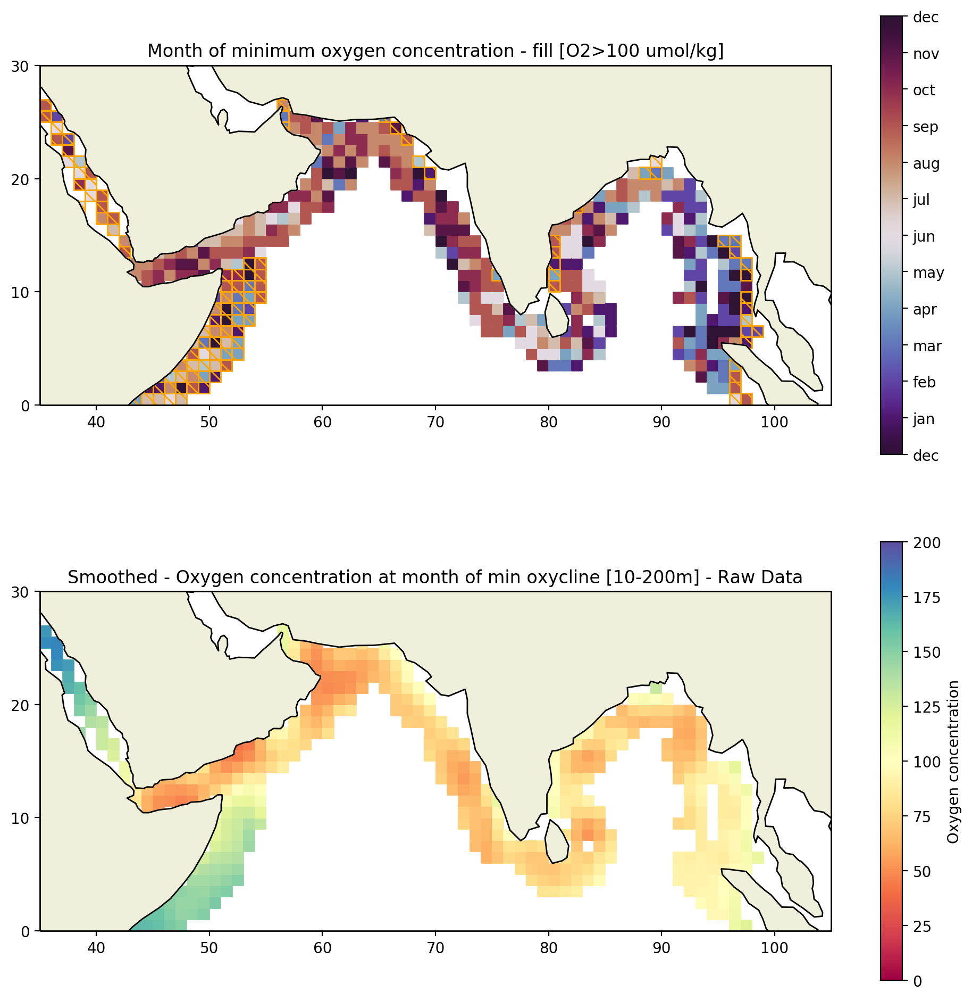

In [99]:
lon_min,lon_max=35,110
lat_min,lat_max=-30,30

n=1
s=50 #8
space=n/2
vmin=0
vmax=200

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lonmin,lonmax,latmin,latmax)

grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_oxyc[mask],conc_LON_ox[mask],conc_LAT_ox[mask],conc_Month_ox[mask],n=n)
minimum=np.nanmin(grid_value,axis=2)
minimum_month=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lon_min,lon_max,lat_min,lat_max)

latitude  = conc_LAT_ox[mask]
longitude = conc_LON_ox[mask]
mois      = conc_Month_ox[mask]
dmi       = conc_DMI_int_ox[mask]
doxy      = conc_DOXY[mask]

doxy_int_surf  = []
doxy_int_dept = []

m10_50=np.logical_and(PRES_i<=50,PRES_i>=10)
m10_200=np.logical_and(PRES_i<=200,PRES_i>=10)
                       
for n in range(len(latitude)):
    lat=latitude[n]
    lon=longitude[n]
    lat_rank=closest_x(lat,lat_range[0])
    lon_rank=closest_x(lon,lon_range[:,0])

    minmon_tmp=minimum_month[lon_rank,lat_rank]
    if mois[n]==minmon_tmp:
        doxy_int_surf.append(np.nanmean(doxy[n,m10_50]))
        doxy_int_dept.append(np.nanmean(doxy[n,m10_200]))
    else:
        doxy_int_surf.append(np.nan)
        doxy_int_dept.append(np.nan)
    
doxy_int_surf,doxy_int_dept=np.array(doxy_int_surf),np.array(doxy_int_dept)

grid_doxy_surf,grid_std,grid_index,lat_range,lon_range = grid(doxy_int_surf,longitude,latitude,n=1)
grid_doxy_dept,grid_std,grid_index,lat_range,lon_range = grid(doxy_int_dept,longitude,latitude,n=1)

grid_doxy_surf,grid_doxy_dept=smooth(grid_doxy_surf),smooth(grid_doxy_dept)


fig=plt.figure(figsize=(12,12),dpi=200)


ax=fig.add_subplot(211,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
ax.set_yticks([0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent([35, 105, 0, 30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum_month,marker='s',
              vmin=0,vmax=12,cmap=plt.cm.twilight_shifted,s=s)
cbar=plt.colorbar(c)
cbar.set_ticks(np.linspace(0,12,13))
cbar.set_ticklabels(['dec','jan','feb','mar','apr','may','jun',
                    'jul','aug','sep','oct','nov','dec'])

ax.set_title("Month of minimum oxygen concentration - fill [O2>100 umol/kg]")


for i in range(np.shape(lon_range)[0]):
    for j in range(np.shape(lon_range)[1]):
        if grid_doxy_dept[i,j]>100 or (np.isfinite(minimum_month[i,j]) and np.isnan(grid_doxy_dept[i,j])):
            lon_tmp=lon_range[i,j]
            lat_tmp=lat_range[i,j]
            ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                    [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                    fill=False, hatch='\\\ ',c='orange',linewidth=1)
            
ax=fig.add_subplot(212,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent([35, 105, 0, 30], crs=ccrs.PlateCarree())


c=ax.scatter(lon_range,lat_range,c=grid_doxy_dept,marker='s',cmap=plt.cm.Spectral,s=s,vmin=vmin,vmax=vmax)
plt.colorbar(c,label='Oxygen concentration')

ax.set_title("Smoothed - Oxygen concentration at month of min oxycline [10-200m] - Raw Data")
-1

In [100]:
def transformation_month(m,i):
    if np.isfinite(m):
        if m>i:
            return m-i
        else:
            return m+i
    else:
        return np.nan
    
def transformation_inv(m,i):
    if np.isfinite(m):
        if m>i:
            return m-i
        else:
            return m+i
    else:
        return np.nan

-1

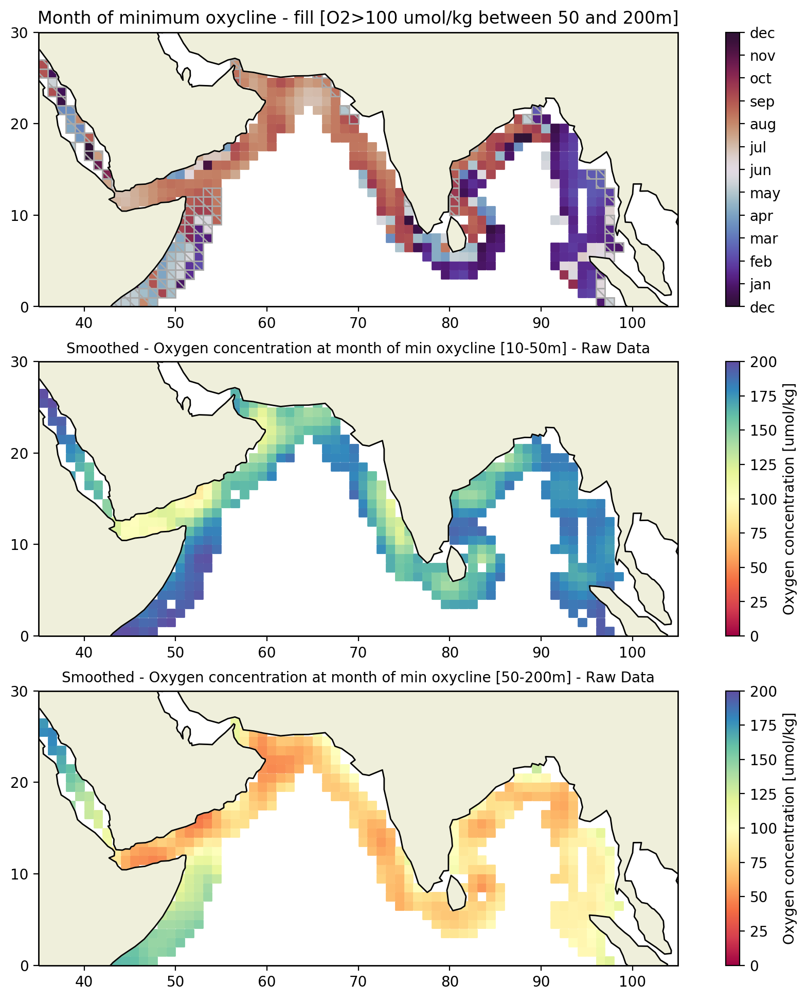

In [101]:
lon_min,lon_max=35,110
lat_min,lat_max=-30,30

n=1
s=32 #8
space=n/2
vmin=0
vmax=200

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lonmin,lonmax,latmin,latmax)

grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_oxyc[mask],conc_LON_ox[mask],conc_LAT_ox[mask],conc_Month_ox[mask],n=n)
minimum=np.nanmin(grid_value,axis=2)
minimum_month=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lon_min,lon_max,lat_min,lat_max)

latitude  = conc_LAT_ox[mask]
longitude = conc_LON_ox[mask]
mois      = conc_Month_ox[mask]
dmi       = conc_DMI_int_ox[mask]
doxy      = conc_DOXY[mask]

doxy_int_surf  = []
doxy_int_dept = []

m10_50=np.logical_and(PRES_i<=50,PRES_i>=10)
m10_200=np.logical_and(PRES_i<=200,PRES_i>=10)
                       
for n in range(len(latitude)):
    lat=latitude[n]
    lon=longitude[n]
    lat_rank=closest_x(lat,lat_range[0])
    lon_rank=closest_x(lon,lon_range[:,0])

    minmon_tmp=minimum_month[lon_rank,lat_rank]
    if mois[n]==minmon_tmp:
        doxy_int_surf.append(np.nanmean(doxy[n,m10_50]))
        doxy_int_dept.append(np.nanmean(doxy[n,m10_200]))
    else:
        doxy_int_surf.append(np.nan)
        doxy_int_dept.append(np.nan)
    
doxy_int_surf,doxy_int_dept=np.array(doxy_int_surf),np.array(doxy_int_dept)

grid_doxy_surf,grid_std,grid_index,lat_range,lon_range = grid(doxy_int_surf,longitude,latitude,n=1)
grid_doxy_dept,grid_std,grid_index,lat_range,lon_range = grid(doxy_int_dept,longitude,latitude,n=1)

grid_doxy_surf,grid_doxy_dept=smooth(grid_doxy_surf),smooth(grid_doxy_dept)

####
list_tmp=[4,6,7]
####
MinMonth=np.array([minimum_month for i in list_tmp])
for m,k in zip(list_tmp,range(len(list_tmp))):
    for i in range(np.shape(grid_value)[0]):
        for j in range(np.shape(grid_value)[1]):
            MinMonth[k,i,j]=transformation_month(MinMonth[k,i,j],m)
for k in range(len(list_tmp)):
    MinMonth[k]=smooth(MinMonth[k],sigma=1.2)
for m,k in zip(list_tmp,range(len(list_tmp))):
    for i in range(np.shape(grid_value)[0]):
        for j in range(np.shape(grid_value)[1]):
            MinMonth[k,i,j]=transformation_inv(MinMonth[k,i,j],m)
minimum_month=np.mean(MinMonth,axis=0)

#######
# FIG #
#######

fig=plt.figure(figsize=(12,12),dpi=200)

# AXE 1

ax=fig.add_subplot(311,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
ax.set_yticks([0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent([35, 105, 0, 30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum_month*12/np.nanmax(minimum_month),marker='s',
              vmin=0,vmax=12,cmap=plt.cm.twilight_shifted,s=s)
cbar=plt.colorbar(c)
cbar.set_ticks(np.linspace(0,12,13))
cbar.set_ticklabels(['dec','jan','feb','mar','apr','may','jun',
                    'jul','aug','sep','oct','nov','dec'])

ax.set_title("Month of minimum oxycline - fill [O2>100 umol/kg between 50 and 200m]")

for i in range(np.shape(lon_range)[0]):
    for j in range(np.shape(lon_range)[1]):
        if grid_doxy_dept[i,j]>100 or (np.isfinite(minimum_month[i,j]) and np.isnan(grid_doxy_dept[i,j])):
            lon_tmp=lon_range[i,j]
            lat_tmp=lat_range[i,j]
            ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                    [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                    fill=False, hatch='\\\ ',c='darkgrey',linewidth=1)

# AXE 2
            
ax=fig.add_subplot(312,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent([35, 105, 0, 30], crs=ccrs.PlateCarree())


c=ax.scatter(lon_range,lat_range,c=grid_doxy_surf,marker='s',cmap=plt.cm.Spectral,s=s,vmin=vmin,vmax=vmax)
plt.colorbar(c,label='Oxygen concentration [umol/kg]')

ax.set_title("Smoothed - Oxygen concentration at month of min oxycline [10-50m] - Raw Data",fontsize=10)

# AXE 3
            
ax=fig.add_subplot(313,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120, 130], crs=ccrs.PlateCarree())
ax.set_yticks([0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent([35, 105, 0, 30], crs=ccrs.PlateCarree())


c=ax.scatter(lon_range,lat_range,c=grid_doxy_dept,marker='s',cmap=plt.cm.Spectral,s=s,vmin=vmin,vmax=vmax)
plt.colorbar(c,label='Oxygen concentration [umol/kg]')

ax.set_title("Smoothed - Oxygen concentration at month of min oxycline [50-200m] - Raw Data",fontsize=10)

#plt.savefig('coastal_min_oxygen.pdf')
-1

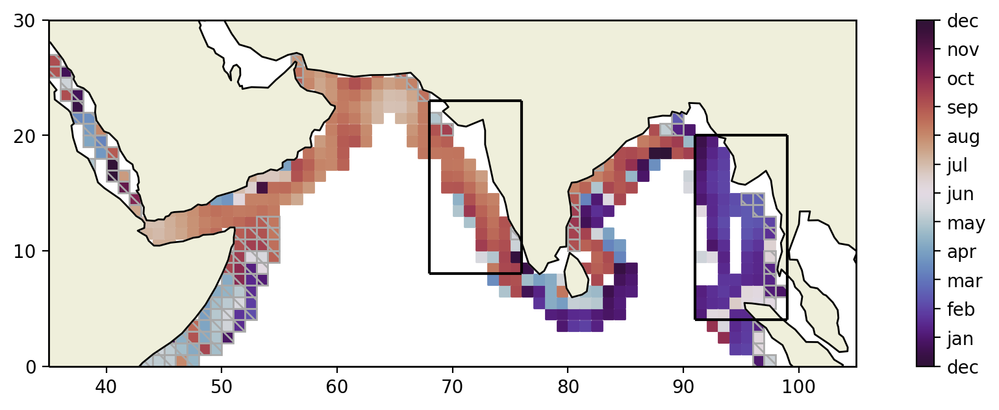

In [102]:
lon_min,lon_max=35,110
lat_min,lat_max=-30,30

n=1
s=32 #8
space=n/2
vmin=0
vmax=200

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lonmin,lonmax,latmin,latmax)

grid_value,grid_std,grid_index,lat_range,lon_range=grid_month(conc_oxyc[mask],conc_LON_ox[mask],conc_LAT_ox[mask],conc_Month_ox[mask],n=n)
minimum=np.nanmin(grid_value,axis=2)
minimum_month=np.full(np.shape(minimum),np.nan)

for i in range(np.shape(grid_value)[0]):
    for j in range(np.shape(grid_value)[1]):
        val=grid_value[i,j]
        mask=grid_value[i,j]==minimum[i,j]
        if len(np.linspace(1,12,12)[mask]):
            mini=int(np.linspace(1,12,12)[mask][0])
            minimum_month[i,j]=mini

mask=mask_coast(conc_LON_ox,conc_LAT_ox,lon_min,lon_max,lat_min,lat_max)

latitude  = conc_LAT_ox[mask]
longitude = conc_LON_ox[mask]
mois      = conc_Month_ox[mask]
dmi       = conc_DMI_int_ox[mask]
doxy      = conc_DOXY[mask]

doxy_int_surf  = []
doxy_int_dept = []

m10_50=np.logical_and(PRES_i<=50,PRES_i>=10)
m10_200=np.logical_and(PRES_i<=200,PRES_i>=10)
                       
for n in range(len(latitude)):
    lat=latitude[n]
    lon=longitude[n]
    lat_rank=closest_x(lat,lat_range[0])
    lon_rank=closest_x(lon,lon_range[:,0])

    minmon_tmp=minimum_month[lon_rank,lat_rank]
    if mois[n]==minmon_tmp:
        doxy_int_surf.append(np.nanmean(doxy[n,m10_50]))
        doxy_int_dept.append(np.nanmean(doxy[n,m10_200]))
    else:
        doxy_int_surf.append(np.nan)
        doxy_int_dept.append(np.nan)
    
doxy_int_surf,doxy_int_dept=np.array(doxy_int_surf),np.array(doxy_int_dept)

grid_doxy_surf,grid_std,grid_index,lat_range,lon_range = grid(doxy_int_surf,longitude,latitude,n=1)
grid_doxy_dept,grid_std,grid_index,lat_range,lon_range = grid(doxy_int_dept,longitude,latitude,n=1)

grid_doxy_surf,grid_doxy_dept=smooth(grid_doxy_surf),smooth(grid_doxy_dept)

####
list_tmp=[4,6,7]
####
MinMonth=np.array([minimum_month for i in list_tmp])
for m,k in zip(list_tmp,range(len(list_tmp))):
    for i in range(np.shape(grid_value)[0]):
        for j in range(np.shape(grid_value)[1]):
            MinMonth[k,i,j]=transformation_month(MinMonth[k,i,j],m)
for k in range(len(list_tmp)):
    MinMonth[k]=smooth(MinMonth[k],sigma=1.2)
for m,k in zip(list_tmp,range(len(list_tmp))):
    for i in range(np.shape(grid_value)[0]):
        for j in range(np.shape(grid_value)[1]):
            MinMonth[k,i,j]=transformation_inv(MinMonth[k,i,j],m)
minimum_month=np.mean(MinMonth,axis=0)

#######
# FIG #
#######

fig=plt.figure(figsize=(12,12),dpi=200)

# AXE 1

ax=fig.add_subplot(311,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_xticks([40, 50, 60, 70, 80, 90, 100, 110, 120,130], crs=ccrs.PlateCarree())
ax.set_yticks([0, 10, 20,30], crs=ccrs.PlateCarree())
ax.set_extent([35, 105, 0, 30], crs=ccrs.PlateCarree())

c=ax.scatter(lon_range,lat_range,c=minimum_month*12/np.nanmax(minimum_month),marker='s',
              vmin=0,vmax=12,cmap=plt.cm.twilight_shifted,s=s)
cbar=plt.colorbar(c)
cbar.set_ticks(np.linspace(0,12,13))
cbar.set_ticklabels(['dec','jan','feb','mar','apr','may','jun',
                    'jul','aug','sep','oct','nov','dec'])

#ax.set_title("Month of minimum oxycline - fill [O2>100 umol/kg between 50 and 200m]")

for i in range(np.shape(lon_range)[0]):
    for j in range(np.shape(lon_range)[1]):
        if grid_doxy_dept[i,j]>100 or (np.isfinite(minimum_month[i,j]) and np.isnan(grid_doxy_dept[i,j])):
            lon_tmp=lon_range[i,j]
            lat_tmp=lat_range[i,j]
            ax.fill([lon_tmp-space, lon_tmp+space, lon_tmp+space, lon_tmp-space],
                    [lat_tmp-space, lat_tmp-space, lat_tmp+space, lat_tmp+space],
                    fill=False, hatch='\\\ ',c='darkgrey',linewidth=1)

lon_min,lon_max=91,99
lat_min,lat_max=4,20

ax.hlines(lat_min,lon_min,lon_max),ax.hlines(lat_max,lon_min,lon_max)
ax.vlines(lon_min,lat_min,lat_max),ax.vlines(lon_max,lat_min,lat_max)

lon_min,lon_max=68,76
lat_min,lat_max=8,23

ax.hlines(lat_min,lon_min,lon_max),ax.hlines(lat_max,lon_min,lon_max)
ax.vlines(lon_min,lat_min,lat_max),ax.vlines(lon_max,lat_min,lat_max)

plt.savefig("minimum month oxycline.png")

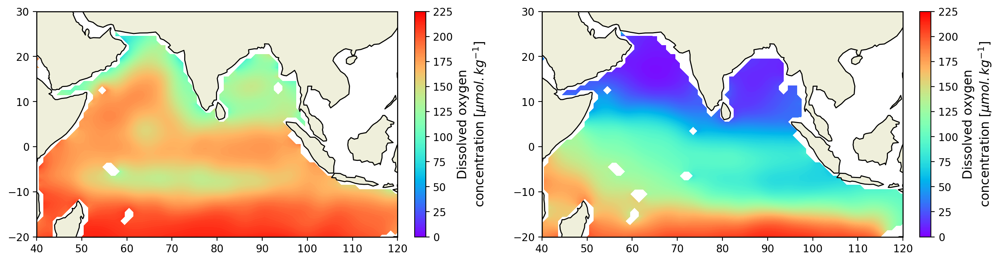

In [103]:
map_lat_min,map_lat_max=-20,30
map_lon_min,map_lon_max=40,120

fsize=12

vmin_o,vmax_o=0,225

fig=plt.figure(figsize=(16,4),dpi=200)

# ax1
thrs=70
grid_value,_,_,lat_range,lon_range=grid(WOA_DOXY[:,PRES_i==thrs],WOA_LONGITUDE,WOA_LATITUDE)

lon,lat=lon_range,lat_range

sel1=np.logical_or(lon<98.797,lat<8.984)
sel2=np.logical_or(lon<100.07,lat<6.731)
sel3=np.logical_or(lon<101.628,lat<-2.695)
sel4=np.logical_or(lon<105.639,lat<-6.747)
sel5=np.logical_or(lon<112.978,lat<-8.421)

sel6=np.logical_and(sel1,sel2)
sel7=np.logical_and(sel3,sel4)
sel8=np.logical_and(sel5,sel6)
sel9=np.logical_and(sel7,sel8)
grid_value=np.ma.array(grid_value, mask=~sel9)

ax=fig.add_subplot(121,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_extent([map_lon_min,map_lon_max,map_lat_min,map_lat_max], crs=ccrs.PlateCarree())
ax.set_xticks(np.linspace(map_lon_min,map_lon_max,(map_lon_max-map_lon_min)/10+1), crs=ccrs.PlateCarree())
ax.set_yticks(np.linspace(map_lat_min,map_lat_max,(map_lat_max-map_lat_min)/10+1), crs=ccrs.PlateCarree())

c=ax.contourf(lon_range,lat_range,grid_value,levels=np.linspace(vmin_o,vmax_o,200),cmap=plt.cm.rainbow)
cb=fig.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Dissolved oxygen' '\n' r'concentration [$\mu mol.kg^{-1}$]',size=fsize)

cb.set_ticks(np.linspace(vmin_o,vmax_o,10))

# ax2
thrs=300
grid_value,_,_,lat_range,lon_range=grid(WOA_DOXY[:,PRES_i==thrs],WOA_LONGITUDE,WOA_LATITUDE)

lon,lat=lon_range,lat_range

sel1=np.logical_or(lon<98.797,lat<8.984)
sel2=np.logical_or(lon<100.07,lat<6.731)
sel3=np.logical_or(lon<101.628,lat<-2.695)
sel4=np.logical_or(lon<105.639,lat<-6.747)
sel5=np.logical_or(lon<112.978,lat<-8.421)

sel6=np.logical_and(sel1,sel2)
sel7=np.logical_and(sel3,sel4)
sel8=np.logical_and(sel5,sel6)
sel9=np.logical_and(sel7,sel8)
grid_value=np.ma.array(grid_value, mask=~sel9)

ax=fig.add_subplot(122,projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE,zorder=2)
ax.add_feature(cfeature.LAND,zorder=1)
ax.set_extent([map_lon_min,map_lon_max,map_lat_min,map_lat_max], crs=ccrs.PlateCarree())
ax.set_xticks(np.linspace(map_lon_min,map_lon_max,(map_lon_max-map_lon_min)/10+1), crs=ccrs.PlateCarree())
ax.set_yticks(np.linspace(map_lat_min,map_lat_max,(map_lat_max-map_lat_min)/10+1), crs=ccrs.PlateCarree())

c=ax.contourf(lon_range,lat_range,grid_value,levels=np.linspace(vmin_o,vmax_o,200),cmap=plt.cm.rainbow)
cb=fig.colorbar(c,fraction=0.046, pad=0.04)
cb.set_label(r'Dissolved oxygen' '\n' r'concentration [$\mu mol.kg^{-1}$]',size=fsize)
cb.set_ticks(np.linspace(vmin_o,vmax_o,10))

plt.savefig('doxy_cross_section.png')